In [ ]:
!pip install optuna

import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split, StratifiedKFold, cross_val_score
import xgboost as xgb
import lightgbm as lgbm
from sklearn.metrics import roc_auc_score
from sklearn.ensemble import VotingClassifier

import optuna

import matplotlib.pyplot as plt
import seaborn as sns

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 362.8/362.8 kB 9.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.2/233.2 kB 16.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 5.7 MB/s eta 0:00:00


/usr/local/lib/python3.10/dist-packages/dask/dataframe/__init__.py:42: FutureWarning: 
Dask dataframe query planning is disabled because dask-expr is not installed.

You can install it with `pip install dask[dataframe]` or `conda install dask`.
This will raise in a future version.

  warnings.warn(msg, FutureWarning)


In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

In [ ]:
data = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/steel_plates_fault_train.csv')
data.head()

,id,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,...,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Pastry,Z_Scratch,K_Scatch,Stains,Dirtiness,Bumps,Other_Faults
0,0,584,590,909972,909977,16,8,5,2274,113,...,-0.5000,-0.0104,0.1417,0,0,0,1,0,0,0
1,1,808,816,728350,728372,433,20,54,44478,70,...,0.7419,-0.2997,0.9491,0,0,0,0,0,0,1
2,2,39,192,2212076,2212144,11388,705,420,1311391,29,...,-0.0105,-0.0944,1.0000,0,0,1,0,0,0,0
3,3,781,789,3353146,3353173,210,16,29,3202,114,...,0.6667,-0.0402,0.4025,0,0,1,0,0,0,0
4,4,1540,1560,618457,618502,521,72,67,48231,82,...,0.9158,-0.2455,0.9998,0,0,0,0,0,0,1


In [ ]:
TARGET_FEATURES = ['Pastry', 'Z_Scratch', 'K_Scatch', 'Stains', 'Dirtiness', 'Bumps', 'Other_Faults']

# Cleaning the data
clean_df = data[data[TARGET_FEATURES].sum(axis=1) <= 1]
clean_df = clean_df[clean_df['TypeOfSteel_A300'] != clean_df['TypeOfSteel_A400']]
clean_df.drop(['id', 'TypeOfSteel_A300'], inplace=True, axis=1)
clean_df['Outside_Global_Index'] = np.where(clean_df['Outside_Global_Index']==0.7, 0.5, clean_df['Outside_Global_Index'])

# Creating a single Target column
clean_df['Target'] = np.argmax(clean_df[TARGET_FEATURES].values, axis=1) + 1
clean_df.loc[clean_df[TARGET_FEATURES].sum(axis=1) == 0, 'Target'] = 0
clean_df.drop(TARGET_FEATURES, axis=1, inplace=True)

clean_df

,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,Maximum_of_Luminosity,...,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Target
0,584,590,909972,909977,16,8,5,2274,113,140,...,1.0000,1.0000,0.0,1.2041,0.9031,0.6990,-0.5000,-0.0104,0.1417,4
1,808,816,728350,728372,433,20,54,44478,70,111,...,0.2500,1.0000,1.0,2.6365,0.7782,1.7324,0.7419,-0.2997,0.9491,7
2,39,192,2212076,2212144,11388,705,420,1311391,29,141,...,0.2363,0.3857,0.0,4.0564,2.1790,2.2095,-0.0105,-0.0944,1.0000,3
3,781,789,3353146,3353173,210,16,29,3202,114,134,...,0.3750,0.9310,1.0,2.3222,0.7782,1.4314,0.6667,-0.0402,0.4025,3
4,1540,1560,618457,618502,521,72,67,48231,82,111,...,0.2105,0.9861,1.0,2.7694,1.4150,1.8808,0.9158,-0.2455,0.9998,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19213,0,28,4662945,4662964,9484,179,200,1320194,19,108,...,0.2383,0.9857,1.0,3.9815,1.3010,2.2967,0.9362,-0.2947,1.0000,7
19215,723,735,2488529,2488541,231,17,26,27135,104,133,...,0.7333,0.9216,1.0,2.3636,1.0414,1.4150,0.7222,-0.0989,0.5378,7
19216,6,31,1578055,1578129,780,114,98,71112,41,94,...,0.1862,0.9554,1.0,2.8921,1.4314,1.8692,0.7719,-0.4283,0.9997,1
19217,9,18,1713172,1713184,126,13,26,14808,88,132,...,0.7692,1.0000,1.0,2.1004,1.0414,1.4150,0.9610,-0.1162,0.3509,7


In [ ]:
# Separating features and target variable
X = clean_df.drop(columns=['Target'], axis=1)
y = clean_df['Target']

In [ ]:
skf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

In [ ]:
# Defining objective function for optuna optimization of XGBClassifier parameters
def objective(trial):

  params = {
      'objective': 'multi:softmax',
      'num_class': 8,
      'early_stopping_rounds': 50,
      'eval_metric': 'auc',
      'verbosity': 1,
      'tree_method': 'hist',
      'n_jobs': -1,
      'booster': 'gbtree',
      'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.1),
      'n_estimators': trial.suggest_int('n_estimators', 100, 3000),
      'max_depth': trial.suggest_int('max_depth', 3, 10),
      'min_child_weight': trial.suggest_int('min_child_weight', 1, 7),
      'sub_sample': trial.suggest_float('sub_sample', 0.1, 1),
      'colsample_bytree': trial.suggest_float('colsample_bytree', 0.1, 1),
      'gamma' : trial.suggest_float('gamma', 1e-5, 0.5, log=True),
      'lambda': trial.suggest_float('lambda', 1e-3, 10.0, log=True),
      'alpha': trial.suggest_float('alpha', 1e-3, 10.0, log=True),
  }

  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

  model = xgb.XGBClassifier(**params)
  model.fit(X_train,
            y_train,
            eval_set=[(X_test, y_test)],
            verbose=True)

  y_pred = model.predict_proba(X_test)
  roc_auc = roc_auc_score(y_test, y_pred, multi_class='ovr', average='macro')

  return roc_auc

# Creating a study for optuna optimization
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=100)

# Retrieving the best parameters
best_params = study.best_params
print('Best Parameters:\n', best_params)

[I 2024-09-27 03:37:58,375] A new study created in memory with name: no-name-2bbd8d7a-4bf3-46a7-b4ff-c037399cc425
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:37:58] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.77058
[1]	validation_0-auc:0.78802
[2]	validation_0-auc:0.79502
[3]	validation_0-auc:0.79920
[4]	validation_0-auc:0.80052
[5]	validation_0-auc:0.80279
[6]	validation_0-auc:0.80682
[7]	validation_0-auc:0.80758
[8]	validation_0-auc:0.80882
[9]	validation_0-auc:0.80923
[10]	validation_0-auc:0.80970
[11]	validation_0-auc:0.80920
[12]	validation_0-auc:0.80979
[13]	validation_0-auc:0.80985
[14]	validation_0-auc:0.81096
[15]	validation_0-auc:0.81177
[16]	validation_0-auc:0.81220
[17]	validation_0-auc:0.81276
[18]	validation_0-auc:0.81342
[19]	validation_0-auc:0.81349
[20]	validation_0-auc:0.81368
[21]	validation_0-auc:0.81347
[22]	validation_0-auc:0.81365
[23]	validation_0-auc:0.81361
[24]	validation_0-auc:0.81373
[25]	validation_0-auc:0.81382
[26]	validation_0-auc:0.81386
[27]	validation_0-auc:0.81414
[28]	validation_0-auc:0.81425
[29]	validation_0-auc:0.81442
[30]	validation_0-auc:0.81448
[31]	validation_0-auc:0.81449
[32]	validation_0-auc:0.81452
[33]	validation_0-au

[I 2024-09-27 03:38:19,681] Trial 0 finished with value: 0.862443737006257 and parameters: {'learning_rate': 0.04617556919785932, 'n_estimators': 1538, 'max_depth': 9, 'min_child_weight': 1, 'sub_sample': 0.3110891446908753, 'colsample_bytree': 0.5721779636264693, 'gamma': 0.0003116308941614944, 'lambda': 0.7499687557810621, 'alpha': 1.42419202143368}. Best is trial 0 with value: 0.862443737006257.


[0]	validation_0-auc:0.77467
[1]	validation_0-auc:0.79003
[2]	validation_0-auc:0.79296


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:38:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[3]	validation_0-auc:0.79413
[4]	validation_0-auc:0.79749
[5]	validation_0-auc:0.79801
[6]	validation_0-auc:0.80245
[7]	validation_0-auc:0.80276
[8]	validation_0-auc:0.80398
[9]	validation_0-auc:0.80343
[10]	validation_0-auc:0.80380
[11]	validation_0-auc:0.80355
[12]	validation_0-auc:0.80424
[13]	validation_0-auc:0.80441
[14]	validation_0-auc:0.80500
[15]	validation_0-auc:0.80607
[16]	validation_0-auc:0.80595
[17]	validation_0-auc:0.80653
[18]	validation_0-auc:0.80657
[19]	validation_0-auc:0.80640
[20]	validation_0-auc:0.80654
[21]	validation_0-auc:0.80682
[22]	validation_0-auc:0.80736
[23]	validation_0-auc:0.80733
[24]	validation_0-auc:0.80749
[25]	validation_0-auc:0.80755
[26]	validation_0-auc:0.80775
[27]	validation_0-auc:0.80779
[28]	validation_0-auc:0.80779
[29]	validation_0-auc:0.80827
[30]	validation_0-auc:0.80837
[31]	validation_0-auc:0.80832
[32]	validation_0-auc:0.80867
[33]	validation_0-auc:0.80906
[34]	validation_0-auc:0.80954
[35]	validation_0-auc:0.80962
[36]	validation_0

[I 2024-09-27 03:38:40,674] Trial 1 finished with value: 0.8651081116458552 and parameters: {'learning_rate': 0.02093654798172126, 'n_estimators': 2003, 'max_depth': 4, 'min_child_weight': 1, 'sub_sample': 0.4543543722439126, 'colsample_bytree': 0.5320252702342848, 'gamma': 0.06526449930717272, 'lambda': 0.011355793872396675, 'alpha': 3.0770344442847843}. Best is trial 1 with value: 0.8651081116458552.


[0]	validation_0-auc:0.76916


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:38:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78752
[2]	validation_0-auc:0.79667
[3]	validation_0-auc:0.80019
[4]	validation_0-auc:0.80358
[5]	validation_0-auc:0.80462
[6]	validation_0-auc:0.80863
[7]	validation_0-auc:0.80812
[8]	validation_0-auc:0.80926
[9]	validation_0-auc:0.80965
[10]	validation_0-auc:0.80986
[11]	validation_0-auc:0.81021
[12]	validation_0-auc:0.81100
[13]	validation_0-auc:0.81066
[14]	validation_0-auc:0.81140
[15]	validation_0-auc:0.81180
[16]	validation_0-auc:0.81234
[17]	validation_0-auc:0.81331
[18]	validation_0-auc:0.81312
[19]	validation_0-auc:0.81327
[20]	validation_0-auc:0.81356
[21]	validation_0-auc:0.81353
[22]	validation_0-auc:0.81372
[23]	validation_0-auc:0.81376
[24]	validation_0-auc:0.81408
[25]	validation_0-auc:0.81401
[26]	validation_0-auc:0.81429
[27]	validation_0-auc:0.81447
[28]	validation_0-auc:0.81453
[29]	validation_0-auc:0.81485
[30]	validation_0-auc:0.81466
[31]	validation_0-auc:0.81468
[32]	validation_0-auc:0.81484
[33]	validation_0-auc:0.81504
[34]	validation_0-a

[I 2024-09-27 03:38:49,144] Trial 2 finished with value: 0.8627406595793519 and parameters: {'learning_rate': 0.047124508400760136, 'n_estimators': 1206, 'max_depth': 8, 'min_child_weight': 4, 'sub_sample': 0.6128639842345915, 'colsample_bytree': 0.47861268736305174, 'gamma': 0.0003066296966939679, 'lambda': 0.036914603328926106, 'alpha': 0.5047569953546156}. Best is trial 1 with value: 0.8651081116458552.


[0]	validation_0-auc:0.75401


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:38:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.76990
[2]	validation_0-auc:0.78001
[3]	validation_0-auc:0.78440
[4]	validation_0-auc:0.78816
[5]	validation_0-auc:0.78743
[6]	validation_0-auc:0.79329
[7]	validation_0-auc:0.79353
[8]	validation_0-auc:0.79580
[9]	validation_0-auc:0.79654
[10]	validation_0-auc:0.79695
[11]	validation_0-auc:0.79714
[12]	validation_0-auc:0.79716
[13]	validation_0-auc:0.79717
[14]	validation_0-auc:0.79856
[15]	validation_0-auc:0.79922
[16]	validation_0-auc:0.79985
[17]	validation_0-auc:0.80041
[18]	validation_0-auc:0.80115
[19]	validation_0-auc:0.80153
[20]	validation_0-auc:0.80141
[21]	validation_0-auc:0.80143
[22]	validation_0-auc:0.80172
[23]	validation_0-auc:0.80156
[24]	validation_0-auc:0.80234
[25]	validation_0-auc:0.80271
[26]	validation_0-auc:0.80335
[27]	validation_0-auc:0.80399
[28]	validation_0-auc:0.80460
[29]	validation_0-auc:0.80468
[30]	validation_0-auc:0.80493
[31]	validation_0-auc:0.80525
[32]	validation_0-auc:0.80536
[33]	validation_0-auc:0.80541
[34]	validation_0-a

[I 2024-09-27 03:39:03,428] Trial 3 finished with value: 0.8606850165637645 and parameters: {'learning_rate': 0.04413822769156881, 'n_estimators': 710, 'max_depth': 8, 'min_child_weight': 5, 'sub_sample': 0.2586598952426971, 'colsample_bytree': 0.19578180619499325, 'gamma': 4.248249787953399e-05, 'lambda': 0.001197736181299057, 'alpha': 0.01740491516321125}. Best is trial 1 with value: 0.8651081116458552.


[0]	validation_0-auc:0.79092


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:39:03] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79731
[2]	validation_0-auc:0.79860
[3]	validation_0-auc:0.80122
[4]	validation_0-auc:0.80188
[5]	validation_0-auc:0.80257
[6]	validation_0-auc:0.80418
[7]	validation_0-auc:0.80512
[8]	validation_0-auc:0.80582
[9]	validation_0-auc:0.80640
[10]	validation_0-auc:0.80716
[11]	validation_0-auc:0.80791
[12]	validation_0-auc:0.80786
[13]	validation_0-auc:0.80805
[14]	validation_0-auc:0.80836
[15]	validation_0-auc:0.80886
[16]	validation_0-auc:0.80936
[17]	validation_0-auc:0.80996
[18]	validation_0-auc:0.81033
[19]	validation_0-auc:0.81041
[20]	validation_0-auc:0.81085
[21]	validation_0-auc:0.81112
[22]	validation_0-auc:0.81142
[23]	validation_0-auc:0.81165
[24]	validation_0-auc:0.81182
[25]	validation_0-auc:0.81182
[26]	validation_0-auc:0.81167
[27]	validation_0-auc:0.81177
[28]	validation_0-auc:0.81201
[29]	validation_0-auc:0.81226
[30]	validation_0-auc:0.81239
[31]	validation_0-auc:0.81266
[32]	validation_0-auc:0.81265
[33]	validation_0-auc:0.81295
[34]	validation_0-a

[I 2024-09-27 03:39:22,942] Trial 4 finished with value: 0.865335484889461 and parameters: {'learning_rate': 0.04574536746859783, 'n_estimators': 1202, 'max_depth': 6, 'min_child_weight': 1, 'sub_sample': 0.7774017265380972, 'colsample_bytree': 0.9577837245822232, 'gamma': 0.0007441484170466389, 'lambda': 0.8177447747944591, 'alpha': 8.213267994957217}. Best is trial 4 with value: 0.865335484889461.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:39:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.76337
[1]	validation_0-auc:0.77815
[2]	validation_0-auc:0.78767
[3]	validation_0-auc:0.79184
[4]	validation_0-auc:0.79616
[5]	validation_0-auc:0.79762
[6]	validation_0-auc:0.80092
[7]	validation_0-auc:0.80189
[8]	validation_0-auc:0.80298
[9]	validation_0-auc:0.80366
[10]	validation_0-auc:0.80488
[11]	validation_0-auc:0.80502
[12]	validation_0-auc:0.80497
[13]	validation_0-auc:0.80570
[14]	validation_0-auc:0.80584
[15]	validation_0-auc:0.80654
[16]	validation_0-auc:0.80628
[17]	validation_0-auc:0.80612
[18]	validation_0-auc:0.80612
[19]	validation_0-auc:0.80645
[20]	validation_0-auc:0.80669
[21]	validation_0-auc:0.80671
[22]	validation_0-auc:0.80687
[23]	validation_0-auc:0.80780
[24]	validation_0-auc:0.80764
[25]	validation_0-auc:0.80751
[26]	validation_0-auc:0.80764
[27]	validation_0-auc:0.80776
[28]	validation_0-auc:0.80807
[29]	validation_0-auc:0.80786
[30]	validation_0-auc:0.80812
[31]	validation_0-auc:0.80830
[32]	validation_0-auc:0.80860
[33]	validation_0-au

[I 2024-09-27 03:39:59,542] Trial 5 finished with value: 0.852109215763487 and parameters: {'learning_rate': 0.011283880167912546, 'n_estimators': 1837, 'max_depth': 10, 'min_child_weight': 1, 'sub_sample': 0.5319391364303774, 'colsample_bytree': 0.8406843064599664, 'gamma': 5.286189627125653e-05, 'lambda': 0.01341200091480937, 'alpha': 0.12959126297149784}. Best is trial 4 with value: 0.865335484889461.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:39:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.77486
[1]	validation_0-auc:0.79053
[2]	validation_0-auc:0.79483
[3]	validation_0-auc:0.79933
[4]	validation_0-auc:0.80105
[5]	validation_0-auc:0.80186
[6]	validation_0-auc:0.80288
[7]	validation_0-auc:0.80357
[8]	validation_0-auc:0.80458
[9]	validation_0-auc:0.80491
[10]	validation_0-auc:0.80529
[11]	validation_0-auc:0.80561
[12]	validation_0-auc:0.80555
[13]	validation_0-auc:0.80573
[14]	validation_0-auc:0.80583
[15]	validation_0-auc:0.80585
[16]	validation_0-auc:0.80598
[17]	validation_0-auc:0.80618
[18]	validation_0-auc:0.80611
[19]	validation_0-auc:0.80645
[20]	validation_0-auc:0.80678
[21]	validation_0-auc:0.80692
[22]	validation_0-auc:0.80720
[23]	validation_0-auc:0.80732
[24]	validation_0-auc:0.80723
[25]	validation_0-auc:0.80719
[26]	validation_0-auc:0.80731
[27]	validation_0-auc:0.80731
[28]	validation_0-auc:0.80754
[29]	validation_0-auc:0.80777
[30]	validation_0-auc:0.80763
[31]	validation_0-auc:0.80781
[32]	validation_0-auc:0.80798
[33]	validation_0-au

[I 2024-09-27 03:40:12,852] Trial 6 finished with value: 0.8526311929334028 and parameters: {'learning_rate': 0.08762292739258903, 'n_estimators': 246, 'max_depth': 10, 'min_child_weight': 3, 'sub_sample': 0.4328666414509543, 'colsample_bytree': 0.9094534792887795, 'gamma': 5.343743281032091e-05, 'lambda': 0.022912750247551072, 'alpha': 0.31802387126980686}. Best is trial 4 with value: 0.865335484889461.


[0]	validation_0-auc:0.78312


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:40:12] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79857
[2]	validation_0-auc:0.80182
[3]	validation_0-auc:0.80424
[4]	validation_0-auc:0.80665
[5]	validation_0-auc:0.80794
[6]	validation_0-auc:0.80908
[7]	validation_0-auc:0.81001
[8]	validation_0-auc:0.81046
[9]	validation_0-auc:0.81069
[10]	validation_0-auc:0.81098
[11]	validation_0-auc:0.81087
[12]	validation_0-auc:0.81113
[13]	validation_0-auc:0.81184
[14]	validation_0-auc:0.81210
[15]	validation_0-auc:0.81248
[16]	validation_0-auc:0.81262
[17]	validation_0-auc:0.81297
[18]	validation_0-auc:0.81337
[19]	validation_0-auc:0.81360
[20]	validation_0-auc:0.81382
[21]	validation_0-auc:0.81412
[22]	validation_0-auc:0.81450
[23]	validation_0-auc:0.81455
[24]	validation_0-auc:0.81478
[25]	validation_0-auc:0.81487
[26]	validation_0-auc:0.81477
[27]	validation_0-auc:0.81495
[28]	validation_0-auc:0.81494
[29]	validation_0-auc:0.81478
[30]	validation_0-auc:0.81466
[31]	validation_0-auc:0.81495
[32]	validation_0-auc:0.81513
[33]	validation_0-auc:0.81515
[34]	validation_0-a

[I 2024-09-27 03:40:24,548] Trial 7 finished with value: 0.8613514384033586 and parameters: {'learning_rate': 0.04324530046243489, 'n_estimators': 1542, 'max_depth': 8, 'min_child_weight': 7, 'sub_sample': 0.9945058538619129, 'colsample_bytree': 0.7462217441526618, 'gamma': 0.3727303908359287, 'lambda': 0.02828088117361461, 'alpha': 0.005217180153070138}. Best is trial 4 with value: 0.865335484889461.


[0]	validation_0-auc:0.77136


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:40:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78204
[2]	validation_0-auc:0.79064
[3]	validation_0-auc:0.79448
[4]	validation_0-auc:0.79811
[5]	validation_0-auc:0.79866
[6]	validation_0-auc:0.80289
[7]	validation_0-auc:0.80308
[8]	validation_0-auc:0.80606
[9]	validation_0-auc:0.80644
[10]	validation_0-auc:0.80721
[11]	validation_0-auc:0.80668
[12]	validation_0-auc:0.80746
[13]	validation_0-auc:0.80773
[14]	validation_0-auc:0.80907
[15]	validation_0-auc:0.80991
[16]	validation_0-auc:0.81052
[17]	validation_0-auc:0.81139
[18]	validation_0-auc:0.81157
[19]	validation_0-auc:0.81166
[20]	validation_0-auc:0.81176
[21]	validation_0-auc:0.81190
[22]	validation_0-auc:0.81221
[23]	validation_0-auc:0.81212
[24]	validation_0-auc:0.81207
[25]	validation_0-auc:0.81195
[26]	validation_0-auc:0.81219
[27]	validation_0-auc:0.81240
[28]	validation_0-auc:0.81258
[29]	validation_0-auc:0.81294
[30]	validation_0-auc:0.81318
[31]	validation_0-auc:0.81318
[32]	validation_0-auc:0.81344
[33]	validation_0-auc:0.81353
[34]	validation_0-a

[I 2024-09-27 03:40:37,995] Trial 8 finished with value: 0.8631530255035973 and parameters: {'learning_rate': 0.0358355129910981, 'n_estimators': 1742, 'max_depth': 8, 'min_child_weight': 5, 'sub_sample': 0.8049707904472343, 'colsample_bytree': 0.45376392864365134, 'gamma': 0.0013187635113056575, 'lambda': 0.06902803491845783, 'alpha': 1.2721935869105754}. Best is trial 4 with value: 0.865335484889461.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:40:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.78935
[1]	validation_0-auc:0.79946
[2]	validation_0-auc:0.80117
[3]	validation_0-auc:0.80324
[4]	validation_0-auc:0.80365
[5]	validation_0-auc:0.80455
[6]	validation_0-auc:0.80564
[7]	validation_0-auc:0.80633
[8]	validation_0-auc:0.80749
[9]	validation_0-auc:0.80854
[10]	validation_0-auc:0.80938
[11]	validation_0-auc:0.81019
[12]	validation_0-auc:0.81018
[13]	validation_0-auc:0.81047
[14]	validation_0-auc:0.81074
[15]	validation_0-auc:0.81071
[16]	validation_0-auc:0.81063
[17]	validation_0-auc:0.81080
[18]	validation_0-auc:0.81045
[19]	validation_0-auc:0.81090
[20]	validation_0-auc:0.81101
[21]	validation_0-auc:0.81124
[22]	validation_0-auc:0.81111
[23]	validation_0-auc:0.81115
[24]	validation_0-auc:0.81117
[25]	validation_0-auc:0.81117
[26]	validation_0-auc:0.81136
[27]	validation_0-auc:0.81150
[28]	validation_0-auc:0.81167
[29]	validation_0-auc:0.81169
[30]	validation_0-auc:0.81171
[31]	validation_0-auc:0.81183
[32]	validation_0-auc:0.81193
[33]	validation_0-au

[I 2024-09-27 03:40:57,809] Trial 9 finished with value: 0.8593451972576109 and parameters: {'learning_rate': 0.02822954627812202, 'n_estimators': 1722, 'max_depth': 8, 'min_child_weight': 7, 'sub_sample': 0.10211477769841583, 'colsample_bytree': 0.954926793303079, 'gamma': 1.5197458064398422e-05, 'lambda': 0.001364085740445393, 'alpha': 0.005124036808643385}. Best is trial 4 with value: 0.865335484889461.


[0]	validation_0-auc:0.75567
[1]	validation_0-auc:0.77022


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:40:57] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[2]	validation_0-auc:0.77960
[3]	validation_0-auc:0.78499
[4]	validation_0-auc:0.78979
[5]	validation_0-auc:0.79005
[6]	validation_0-auc:0.79768
[7]	validation_0-auc:0.79845
[8]	validation_0-auc:0.79953
[9]	validation_0-auc:0.79973
[10]	validation_0-auc:0.80075
[11]	validation_0-auc:0.80096
[12]	validation_0-auc:0.80080
[13]	validation_0-auc:0.80128
[14]	validation_0-auc:0.80208
[15]	validation_0-auc:0.80218
[16]	validation_0-auc:0.80322
[17]	validation_0-auc:0.80255
[18]	validation_0-auc:0.80362
[19]	validation_0-auc:0.80367
[20]	validation_0-auc:0.80401
[21]	validation_0-auc:0.80396
[22]	validation_0-auc:0.80357
[23]	validation_0-auc:0.80334
[24]	validation_0-auc:0.80405
[25]	validation_0-auc:0.80417
[26]	validation_0-auc:0.80454
[27]	validation_0-auc:0.80526
[28]	validation_0-auc:0.80593
[29]	validation_0-auc:0.80604
[30]	validation_0-auc:0.80622
[31]	validation_0-auc:0.80689
[32]	validation_0-auc:0.80702
[33]	validation_0-auc:0.80730
[34]	validation_0-auc:0.80816
[35]	validation_0-

[I 2024-09-27 03:41:09,350] Trial 10 finished with value: 0.8630547119904839 and parameters: {'learning_rate': 0.07093662631708157, 'n_estimators': 2776, 'max_depth': 5, 'min_child_weight': 3, 'sub_sample': 0.7602540986409836, 'colsample_bytree': 0.16326355386880687, 'gamma': 0.013033489210859173, 'lambda': 8.314706380765266, 'alpha': 0.030541548640919253}. Best is trial 4 with value: 0.865335484889461.


[0]	validation_0-auc:0.77293
[1]	validation_0-auc:0.78677


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:41:09] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[2]	validation_0-auc:0.79065
[3]	validation_0-auc:0.79151
[4]	validation_0-auc:0.79328
[5]	validation_0-auc:0.79300
[6]	validation_0-auc:0.79347
[7]	validation_0-auc:0.79288
[8]	validation_0-auc:0.79283
[9]	validation_0-auc:0.79306
[10]	validation_0-auc:0.79360
[11]	validation_0-auc:0.79382
[12]	validation_0-auc:0.79431
[13]	validation_0-auc:0.79541
[14]	validation_0-auc:0.79597
[15]	validation_0-auc:0.79644
[16]	validation_0-auc:0.79642
[17]	validation_0-auc:0.79693
[18]	validation_0-auc:0.79702
[19]	validation_0-auc:0.79743
[20]	validation_0-auc:0.79759
[21]	validation_0-auc:0.79796
[22]	validation_0-auc:0.79842
[23]	validation_0-auc:0.79865
[24]	validation_0-auc:0.79875
[25]	validation_0-auc:0.79891
[26]	validation_0-auc:0.79893
[27]	validation_0-auc:0.79929
[28]	validation_0-auc:0.79946
[29]	validation_0-auc:0.79946
[30]	validation_0-auc:0.79960
[31]	validation_0-auc:0.79982
[32]	validation_0-auc:0.80006
[33]	validation_0-auc:0.80063
[34]	validation_0-auc:0.80089
[35]	validation_0-

[I 2024-09-27 03:41:55,766] Trial 11 finished with value: 0.8659279602937691 and parameters: {'learning_rate': 0.01763155840140742, 'n_estimators': 2513, 'max_depth': 3, 'min_child_weight': 2, 'sub_sample': 0.7109768180787496, 'colsample_bytree': 0.6653451191758236, 'gamma': 0.023324135656430826, 'lambda': 0.564489318763252, 'alpha': 8.42809576265961}. Best is trial 11 with value: 0.8659279602937691.


[0]	validation_0-auc:0.77220
[1]	validation_0-auc:0.78795


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:41:55] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[2]	validation_0-auc:0.78938
[3]	validation_0-auc:0.79056
[4]	validation_0-auc:0.79350
[5]	validation_0-auc:0.79590
[6]	validation_0-auc:0.79692
[7]	validation_0-auc:0.79779
[8]	validation_0-auc:0.79896
[9]	validation_0-auc:0.79935
[10]	validation_0-auc:0.80022
[11]	validation_0-auc:0.80061
[12]	validation_0-auc:0.80054
[13]	validation_0-auc:0.80147
[14]	validation_0-auc:0.80203
[15]	validation_0-auc:0.80284
[16]	validation_0-auc:0.80294
[17]	validation_0-auc:0.80333
[18]	validation_0-auc:0.80415
[19]	validation_0-auc:0.80434
[20]	validation_0-auc:0.80472
[21]	validation_0-auc:0.80500
[22]	validation_0-auc:0.80554
[23]	validation_0-auc:0.80612
[24]	validation_0-auc:0.80663
[25]	validation_0-auc:0.80688
[26]	validation_0-auc:0.80734
[27]	validation_0-auc:0.80753
[28]	validation_0-auc:0.80774
[29]	validation_0-auc:0.80821
[30]	validation_0-auc:0.80845
[31]	validation_0-auc:0.80863
[32]	validation_0-auc:0.80879
[33]	validation_0-auc:0.80924
[34]	validation_0-auc:0.80948
[35]	validation_0-

[I 2024-09-27 03:42:11,074] Trial 12 finished with value: 0.8660364272006551 and parameters: {'learning_rate': 0.07194534718483737, 'n_estimators': 2591, 'max_depth': 3, 'min_child_weight': 2, 'sub_sample': 0.7262475864329908, 'colsample_bytree': 0.7316942882897584, 'gamma': 0.00936902406373685, 'lambda': 0.6614388355094253, 'alpha': 7.972685681521192}. Best is trial 12 with value: 0.8660364272006551.


[0]	validation_0-auc:0.77400


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:42:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78945
[2]	validation_0-auc:0.78918
[3]	validation_0-auc:0.79068
[4]	validation_0-auc:0.79391
[5]	validation_0-auc:0.79627
[6]	validation_0-auc:0.79722
[7]	validation_0-auc:0.79863
[8]	validation_0-auc:0.79930
[9]	validation_0-auc:0.79971
[10]	validation_0-auc:0.80016
[11]	validation_0-auc:0.80082
[12]	validation_0-auc:0.80086
[13]	validation_0-auc:0.80186
[14]	validation_0-auc:0.80300
[15]	validation_0-auc:0.80345
[16]	validation_0-auc:0.80383
[17]	validation_0-auc:0.80411
[18]	validation_0-auc:0.80458
[19]	validation_0-auc:0.80499
[20]	validation_0-auc:0.80523
[21]	validation_0-auc:0.80542
[22]	validation_0-auc:0.80590
[23]	validation_0-auc:0.80624
[24]	validation_0-auc:0.80668
[25]	validation_0-auc:0.80696
[26]	validation_0-auc:0.80722
[27]	validation_0-auc:0.80752
[28]	validation_0-auc:0.80781
[29]	validation_0-auc:0.80825
[30]	validation_0-auc:0.80846
[31]	validation_0-auc:0.80862
[32]	validation_0-auc:0.80886
[33]	validation_0-auc:0.80916
[34]	validation_0-a

[I 2024-09-27 03:42:25,004] Trial 13 finished with value: 0.8661368134265283 and parameters: {'learning_rate': 0.06839718114826392, 'n_estimators': 2966, 'max_depth': 3, 'min_child_weight': 3, 'sub_sample': 0.6647960499715213, 'colsample_bytree': 0.7086383600920703, 'gamma': 0.01023763354217269, 'lambda': 0.4868492929291246, 'alpha': 5.095284989346645}. Best is trial 13 with value: 0.8661368134265283.


[0]	validation_0-auc:0.77588


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:42:25] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79121
[2]	validation_0-auc:0.79034
[3]	validation_0-auc:0.79139
[4]	validation_0-auc:0.79419
[5]	validation_0-auc:0.79663
[6]	validation_0-auc:0.79738
[7]	validation_0-auc:0.79891
[8]	validation_0-auc:0.79934
[9]	validation_0-auc:0.79995
[10]	validation_0-auc:0.80061
[11]	validation_0-auc:0.80105
[12]	validation_0-auc:0.80142
[13]	validation_0-auc:0.80219
[14]	validation_0-auc:0.80325
[15]	validation_0-auc:0.80371
[16]	validation_0-auc:0.80397
[17]	validation_0-auc:0.80432
[18]	validation_0-auc:0.80491
[19]	validation_0-auc:0.80490
[20]	validation_0-auc:0.80513
[21]	validation_0-auc:0.80513
[22]	validation_0-auc:0.80568
[23]	validation_0-auc:0.80618
[24]	validation_0-auc:0.80665
[25]	validation_0-auc:0.80690
[26]	validation_0-auc:0.80711
[27]	validation_0-auc:0.80747
[28]	validation_0-auc:0.80766
[29]	validation_0-auc:0.80819
[30]	validation_0-auc:0.80841
[31]	validation_0-auc:0.80864
[32]	validation_0-auc:0.80891
[33]	validation_0-auc:0.80930
[34]	validation_0-a

[I 2024-09-27 03:42:37,864] Trial 14 finished with value: 0.8663972955115394 and parameters: {'learning_rate': 0.066085301764616, 'n_estimators': 3000, 'max_depth': 3, 'min_child_weight': 3, 'sub_sample': 0.9450080546982469, 'colsample_bytree': 0.7157018738955794, 'gamma': 0.005417124561233091, 'lambda': 4.432951390921006, 'alpha': 2.6285100242593935}. Best is trial 14 with value: 0.8663972955115394.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:42:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.76847
[1]	validation_0-auc:0.77919
[2]	validation_0-auc:0.78679
[3]	validation_0-auc:0.79187
[4]	validation_0-auc:0.79311
[5]	validation_0-auc:0.79321
[6]	validation_0-auc:0.79986
[7]	validation_0-auc:0.80034
[8]	validation_0-auc:0.80216
[9]	validation_0-auc:0.80319
[10]	validation_0-auc:0.80396
[11]	validation_0-auc:0.80404
[12]	validation_0-auc:0.80405
[13]	validation_0-auc:0.80437
[14]	validation_0-auc:0.80549
[15]	validation_0-auc:0.80574
[16]	validation_0-auc:0.80638
[17]	validation_0-auc:0.80791
[18]	validation_0-auc:0.80872
[19]	validation_0-auc:0.80890
[20]	validation_0-auc:0.80891
[21]	validation_0-auc:0.80899
[22]	validation_0-auc:0.80892
[23]	validation_0-auc:0.80873
[24]	validation_0-auc:0.80913
[25]	validation_0-auc:0.80931
[26]	validation_0-auc:0.80964
[27]	validation_0-auc:0.81003
[28]	validation_0-auc:0.81043
[29]	validation_0-auc:0.81070
[30]	validation_0-auc:0.81088
[31]	validation_0-auc:0.81114
[32]	validation_0-auc:0.81153
[33]	validation_0-au

[I 2024-09-27 03:42:49,482] Trial 15 finished with value: 0.8654227062891708 and parameters: {'learning_rate': 0.06449990909275113, 'n_estimators': 2992, 'max_depth': 5, 'min_child_weight': 4, 'sub_sample': 0.9760464447515821, 'colsample_bytree': 0.2870834645885288, 'gamma': 0.003846889747505788, 'lambda': 9.920645471875401, 'alpha': 1.8403458987607673}. Best is trial 14 with value: 0.8663972955115394.


[0]	validation_0-auc:0.77930


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:42:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79775
[2]	validation_0-auc:0.80046
[3]	validation_0-auc:0.80177
[4]	validation_0-auc:0.80436
[5]	validation_0-auc:0.80654
[6]	validation_0-auc:0.80874
[7]	validation_0-auc:0.80896
[8]	validation_0-auc:0.80966
[9]	validation_0-auc:0.80989
[10]	validation_0-auc:0.81041
[11]	validation_0-auc:0.81043
[12]	validation_0-auc:0.81023
[13]	validation_0-auc:0.81138
[14]	validation_0-auc:0.81231
[15]	validation_0-auc:0.81262
[16]	validation_0-auc:0.81304
[17]	validation_0-auc:0.81331
[18]	validation_0-auc:0.81370
[19]	validation_0-auc:0.81389
[20]	validation_0-auc:0.81415
[21]	validation_0-auc:0.81454
[22]	validation_0-auc:0.81459
[23]	validation_0-auc:0.81465
[24]	validation_0-auc:0.81482
[25]	validation_0-auc:0.81513
[26]	validation_0-auc:0.81533
[27]	validation_0-auc:0.81541
[28]	validation_0-auc:0.81549
[29]	validation_0-auc:0.81556
[30]	validation_0-auc:0.81550
[31]	validation_0-auc:0.81567
[32]	validation_0-auc:0.81568
[33]	validation_0-auc:0.81566
[34]	validation_0-a

[I 2024-09-27 03:42:55,281] Trial 16 finished with value: 0.8641411032377591 and parameters: {'learning_rate': 0.0913608602251339, 'n_estimators': 2331, 'max_depth': 4, 'min_child_weight': 3, 'sub_sample': 0.8884399763541545, 'colsample_bytree': 0.6472989335077476, 'gamma': 0.08299598785909972, 'lambda': 2.5765194415076014, 'alpha': 0.4151558832601019}. Best is trial 14 with value: 0.8663972955115394.


[0]	validation_0-auc:0.76883
[1]	validation_0-auc:0.77862


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:42:55] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[2]	validation_0-auc:0.78829
[3]	validation_0-auc:0.79228
[4]	validation_0-auc:0.79456
[5]	validation_0-auc:0.79575
[6]	validation_0-auc:0.80144
[7]	validation_0-auc:0.80237
[8]	validation_0-auc:0.80455
[9]	validation_0-auc:0.80528
[10]	validation_0-auc:0.80641
[11]	validation_0-auc:0.80686
[12]	validation_0-auc:0.80712
[13]	validation_0-auc:0.80712
[14]	validation_0-auc:0.80812
[15]	validation_0-auc:0.80868
[16]	validation_0-auc:0.80922
[17]	validation_0-auc:0.81017
[18]	validation_0-auc:0.81035
[19]	validation_0-auc:0.81069
[20]	validation_0-auc:0.81092
[21]	validation_0-auc:0.81121
[22]	validation_0-auc:0.81120
[23]	validation_0-auc:0.81115
[24]	validation_0-auc:0.81133
[25]	validation_0-auc:0.81144
[26]	validation_0-auc:0.81200
[27]	validation_0-auc:0.81261
[28]	validation_0-auc:0.81290
[29]	validation_0-auc:0.81326
[30]	validation_0-auc:0.81322
[31]	validation_0-auc:0.81365
[32]	validation_0-auc:0.81419
[33]	validation_0-auc:0.81432
[34]	validation_0-auc:0.81477
[35]	validation_0-

[I 2024-09-27 03:43:05,016] Trial 17 finished with value: 0.8647655586293507 and parameters: {'learning_rate': 0.08017797254700718, 'n_estimators': 2227, 'max_depth': 4, 'min_child_weight': 5, 'sub_sample': 0.6075033823176875, 'colsample_bytree': 0.37963495736526587, 'gamma': 0.003444707936855265, 'lambda': 0.21685497380727836, 'alpha': 0.0758894380104082}. Best is trial 14 with value: 0.8663972955115394.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:43:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.79048
[1]	validation_0-auc:0.79885
[2]	validation_0-auc:0.80248
[3]	validation_0-auc:0.80461
[4]	validation_0-auc:0.80679
[5]	validation_0-auc:0.80915
[6]	validation_0-auc:0.81050
[7]	validation_0-auc:0.81061
[8]	validation_0-auc:0.81111
[9]	validation_0-auc:0.81129
[10]	validation_0-auc:0.81162
[11]	validation_0-auc:0.81206
[12]	validation_0-auc:0.81255
[13]	validation_0-auc:0.81319
[14]	validation_0-auc:0.81340
[15]	validation_0-auc:0.81361
[16]	validation_0-auc:0.81372
[17]	validation_0-auc:0.81383
[18]	validation_0-auc:0.81367
[19]	validation_0-auc:0.81393
[20]	validation_0-auc:0.81435
[21]	validation_0-auc:0.81467
[22]	validation_0-auc:0.81495
[23]	validation_0-auc:0.81512
[24]	validation_0-auc:0.81525
[25]	validation_0-auc:0.81535
[26]	validation_0-auc:0.81569
[27]	validation_0-auc:0.81590
[28]	validation_0-auc:0.81604
[29]	validation_0-auc:0.81622
[30]	validation_0-auc:0.81642
[31]	validation_0-auc:0.81658
[32]	validation_0-auc:0.81668
[33]	validation_0-au

[I 2024-09-27 03:43:19,366] Trial 18 finished with value: 0.8653634347205112 and parameters: {'learning_rate': 0.059247911875262425, 'n_estimators': 2982, 'max_depth': 6, 'min_child_weight': 4, 'sub_sample': 0.879312307634873, 'colsample_bytree': 0.8166371852911649, 'gamma': 0.05803538181054533, 'lambda': 2.808407155443213, 'alpha': 3.375017872516383}. Best is trial 14 with value: 0.8663972955115394.


[0]	validation_0-auc:0.77079
[1]	validation_0-auc:0.79061


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:43:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[2]	validation_0-auc:0.79438
[3]	validation_0-auc:0.79523
[4]	validation_0-auc:0.79815
[5]	validation_0-auc:0.80050
[6]	validation_0-auc:0.80101
[7]	validation_0-auc:0.80136
[8]	validation_0-auc:0.80187
[9]	validation_0-auc:0.80236
[10]	validation_0-auc:0.80336
[11]	validation_0-auc:0.80376
[12]	validation_0-auc:0.80384
[13]	validation_0-auc:0.80461
[14]	validation_0-auc:0.80523
[15]	validation_0-auc:0.80563
[16]	validation_0-auc:0.80594
[17]	validation_0-auc:0.80639
[18]	validation_0-auc:0.80702
[19]	validation_0-auc:0.80739
[20]	validation_0-auc:0.80803
[21]	validation_0-auc:0.80820
[22]	validation_0-auc:0.80876
[23]	validation_0-auc:0.80925
[24]	validation_0-auc:0.80968
[25]	validation_0-auc:0.81000
[26]	validation_0-auc:0.81011
[27]	validation_0-auc:0.81024
[28]	validation_0-auc:0.81037
[29]	validation_0-auc:0.81066
[30]	validation_0-auc:0.81062
[31]	validation_0-auc:0.81072
[32]	validation_0-auc:0.81084
[33]	validation_0-auc:0.81107
[34]	validation_0-auc:0.81142
[35]	validation_0-

[I 2024-09-27 03:43:26,839] Trial 19 finished with value: 0.865795535932722 and parameters: {'learning_rate': 0.07947023951529314, 'n_estimators': 2692, 'max_depth': 3, 'min_child_weight': 2, 'sub_sample': 0.9057616329381204, 'colsample_bytree': 0.6267203317830534, 'gamma': 0.006517403150566212, 'lambda': 2.809589965953131, 'alpha': 0.6929595912252713}. Best is trial 14 with value: 0.8663972955115394.


[0]	validation_0-auc:0.78882


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:43:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79924
[2]	validation_0-auc:0.80171
[3]	validation_0-auc:0.80385
[4]	validation_0-auc:0.80670
[5]	validation_0-auc:0.80877
[6]	validation_0-auc:0.81027
[7]	validation_0-auc:0.81021
[8]	validation_0-auc:0.81114
[9]	validation_0-auc:0.81140
[10]	validation_0-auc:0.81170
[11]	validation_0-auc:0.81202
[12]	validation_0-auc:0.81273
[13]	validation_0-auc:0.81333
[14]	validation_0-auc:0.81364
[15]	validation_0-auc:0.81385
[16]	validation_0-auc:0.81390
[17]	validation_0-auc:0.81435
[18]	validation_0-auc:0.81439
[19]	validation_0-auc:0.81458
[20]	validation_0-auc:0.81440
[21]	validation_0-auc:0.81461
[22]	validation_0-auc:0.81496
[23]	validation_0-auc:0.81521
[24]	validation_0-auc:0.81545
[25]	validation_0-auc:0.81565
[26]	validation_0-auc:0.81586
[27]	validation_0-auc:0.81588
[28]	validation_0-auc:0.81623
[29]	validation_0-auc:0.81628
[30]	validation_0-auc:0.81630
[31]	validation_0-auc:0.81638
[32]	validation_0-auc:0.81652
[33]	validation_0-auc:0.81678
[34]	validation_0-a

[I 2024-09-27 03:43:38,359] Trial 20 finished with value: 0.865226005182584 and parameters: {'learning_rate': 0.057314714950366864, 'n_estimators': 2313, 'max_depth': 5, 'min_child_weight': 6, 'sub_sample': 0.6491771901032304, 'colsample_bytree': 0.7710444975078875, 'gamma': 0.2785887629344541, 'lambda': 0.2507856801800318, 'alpha': 3.5138968903252343}. Best is trial 14 with value: 0.8663972955115394.


[0]	validation_0-auc:0.77169
[1]	validation_0-auc:0.78856


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:43:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[2]	validation_0-auc:0.78929
[3]	validation_0-auc:0.79056
[4]	validation_0-auc:0.79345
[5]	validation_0-auc:0.79609
[6]	validation_0-auc:0.79667
[7]	validation_0-auc:0.79741
[8]	validation_0-auc:0.79827
[9]	validation_0-auc:0.79854
[10]	validation_0-auc:0.79895
[11]	validation_0-auc:0.79973
[12]	validation_0-auc:0.79979
[13]	validation_0-auc:0.80084
[14]	validation_0-auc:0.80153
[15]	validation_0-auc:0.80188
[16]	validation_0-auc:0.80178
[17]	validation_0-auc:0.80254
[18]	validation_0-auc:0.80338
[19]	validation_0-auc:0.80392
[20]	validation_0-auc:0.80438
[21]	validation_0-auc:0.80490
[22]	validation_0-auc:0.80515
[23]	validation_0-auc:0.80550
[24]	validation_0-auc:0.80607
[25]	validation_0-auc:0.80630
[26]	validation_0-auc:0.80676
[27]	validation_0-auc:0.80700
[28]	validation_0-auc:0.80735
[29]	validation_0-auc:0.80789
[30]	validation_0-auc:0.80806
[31]	validation_0-auc:0.80817
[32]	validation_0-auc:0.80827
[33]	validation_0-auc:0.80871
[34]	validation_0-auc:0.80906
[35]	validation_0-

[I 2024-09-27 03:43:53,139] Trial 21 finished with value: 0.8655965726039817 and parameters: {'learning_rate': 0.06994246316888655, 'n_estimators': 2676, 'max_depth': 3, 'min_child_weight': 2, 'sub_sample': 0.6807067106503949, 'colsample_bytree': 0.7138480196048483, 'gamma': 0.016976369191157845, 'lambda': 1.4393517659373323, 'alpha': 9.253027703399411}. Best is trial 14 with value: 0.8663972955115394.


[0]	validation_0-auc:0.77787


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:43:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79046
[2]	validation_0-auc:0.79265
[3]	validation_0-auc:0.79383
[4]	validation_0-auc:0.79648
[5]	validation_0-auc:0.79857
[6]	validation_0-auc:0.79965
[7]	validation_0-auc:0.80086
[8]	validation_0-auc:0.80157
[9]	validation_0-auc:0.80207
[10]	validation_0-auc:0.80272
[11]	validation_0-auc:0.80325
[12]	validation_0-auc:0.80363
[13]	validation_0-auc:0.80377
[14]	validation_0-auc:0.80474
[15]	validation_0-auc:0.80536
[16]	validation_0-auc:0.80559
[17]	validation_0-auc:0.80601
[18]	validation_0-auc:0.80624
[19]	validation_0-auc:0.80630
[20]	validation_0-auc:0.80649
[21]	validation_0-auc:0.80674
[22]	validation_0-auc:0.80749
[23]	validation_0-auc:0.80786
[24]	validation_0-auc:0.80842
[25]	validation_0-auc:0.80869
[26]	validation_0-auc:0.80871
[27]	validation_0-auc:0.80878
[28]	validation_0-auc:0.80915
[29]	validation_0-auc:0.80948
[30]	validation_0-auc:0.80949
[31]	validation_0-auc:0.80971
[32]	validation_0-auc:0.80989
[33]	validation_0-auc:0.80998
[34]	validation_0-a

[I 2024-09-27 03:44:05,152] Trial 22 finished with value: 0.8652650042031726 and parameters: {'learning_rate': 0.07709901578274653, 'n_estimators': 2926, 'max_depth': 3, 'min_child_weight': 3, 'sub_sample': 0.5296674651896814, 'colsample_bytree': 0.8284150463726465, 'gamma': 0.0017935957978750098, 'lambda': 0.27852518301702817, 'alpha': 0.0013364815758856623}. Best is trial 14 with value: 0.8663972955115394.


[0]	validation_0-auc:0.78205


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:44:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79290
[2]	validation_0-auc:0.79539
[3]	validation_0-auc:0.79838
[4]	validation_0-auc:0.80139
[5]	validation_0-auc:0.80422
[6]	validation_0-auc:0.80613
[7]	validation_0-auc:0.80683
[8]	validation_0-auc:0.80733
[9]	validation_0-auc:0.80751
[10]	validation_0-auc:0.80828
[11]	validation_0-auc:0.80852
[12]	validation_0-auc:0.80901
[13]	validation_0-auc:0.81020
[14]	validation_0-auc:0.81103
[15]	validation_0-auc:0.81153
[16]	validation_0-auc:0.81187
[17]	validation_0-auc:0.81229
[18]	validation_0-auc:0.81296
[19]	validation_0-auc:0.81341
[20]	validation_0-auc:0.81354
[21]	validation_0-auc:0.81359
[22]	validation_0-auc:0.81413
[23]	validation_0-auc:0.81442
[24]	validation_0-auc:0.81434
[25]	validation_0-auc:0.81441
[26]	validation_0-auc:0.81452
[27]	validation_0-auc:0.81465
[28]	validation_0-auc:0.81466
[29]	validation_0-auc:0.81477
[30]	validation_0-auc:0.81484
[31]	validation_0-auc:0.81505
[32]	validation_0-auc:0.81496
[33]	validation_0-auc:0.81508
[34]	validation_0-a

[I 2024-09-27 03:44:11,337] Trial 23 finished with value: 0.8647862452794517 and parameters: {'learning_rate': 0.09970456007802758, 'n_estimators': 2565, 'max_depth': 4, 'min_child_weight': 2, 'sub_sample': 0.8723745144114772, 'colsample_bytree': 0.7010982730360811, 'gamma': 0.008047339033530384, 'lambda': 0.13019272005655008, 'alpha': 4.541708579101263}. Best is trial 14 with value: 0.8663972955115394.


[0]	validation_0-auc:0.77058


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:44:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78724
[2]	validation_0-auc:0.79222
[3]	validation_0-auc:0.79300
[4]	validation_0-auc:0.79669
[5]	validation_0-auc:0.79803
[6]	validation_0-auc:0.79939
[7]	validation_0-auc:0.79961
[8]	validation_0-auc:0.80077
[9]	validation_0-auc:0.80132
[10]	validation_0-auc:0.80219
[11]	validation_0-auc:0.80243
[12]	validation_0-auc:0.80293
[13]	validation_0-auc:0.80389
[14]	validation_0-auc:0.80446
[15]	validation_0-auc:0.80489
[16]	validation_0-auc:0.80506
[17]	validation_0-auc:0.80525
[18]	validation_0-auc:0.80555
[19]	validation_0-auc:0.80557
[20]	validation_0-auc:0.80588
[21]	validation_0-auc:0.80607
[22]	validation_0-auc:0.80632
[23]	validation_0-auc:0.80641
[24]	validation_0-auc:0.80691
[25]	validation_0-auc:0.80724
[26]	validation_0-auc:0.80769
[27]	validation_0-auc:0.80802
[28]	validation_0-auc:0.80813
[29]	validation_0-auc:0.80871
[30]	validation_0-auc:0.80877
[31]	validation_0-auc:0.80919
[32]	validation_0-auc:0.80956
[33]	validation_0-auc:0.80983
[34]	validation_0-a

[I 2024-09-27 03:44:24,096] Trial 24 finished with value: 0.8661367816702845 and parameters: {'learning_rate': 0.06721141824494303, 'n_estimators': 2150, 'max_depth': 3, 'min_child_weight': 3, 'sub_sample': 0.809316635969984, 'colsample_bytree': 0.5797801376193954, 'gamma': 0.03548639966738462, 'lambda': 5.096016942198275, 'alpha': 1.0557306589493132}. Best is trial 14 with value: 0.8663972955115394.


[0]	validation_0-auc:0.77540


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:44:24] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79197
[2]	validation_0-auc:0.79600
[3]	validation_0-auc:0.79663
[4]	validation_0-auc:0.80030
[5]	validation_0-auc:0.80164
[6]	validation_0-auc:0.80590
[7]	validation_0-auc:0.80659
[8]	validation_0-auc:0.80824
[9]	validation_0-auc:0.80802
[10]	validation_0-auc:0.80851
[11]	validation_0-auc:0.80854
[12]	validation_0-auc:0.80895
[13]	validation_0-auc:0.80935
[14]	validation_0-auc:0.81060
[15]	validation_0-auc:0.81113
[16]	validation_0-auc:0.81157
[17]	validation_0-auc:0.81191
[18]	validation_0-auc:0.81194
[19]	validation_0-auc:0.81210
[20]	validation_0-auc:0.81213
[21]	validation_0-auc:0.81252
[22]	validation_0-auc:0.81292
[23]	validation_0-auc:0.81285
[24]	validation_0-auc:0.81313
[25]	validation_0-auc:0.81328
[26]	validation_0-auc:0.81352
[27]	validation_0-auc:0.81360
[28]	validation_0-auc:0.81369
[29]	validation_0-auc:0.81413
[30]	validation_0-auc:0.81414
[31]	validation_0-auc:0.81436
[32]	validation_0-auc:0.81453
[33]	validation_0-auc:0.81484
[34]	validation_0-a

[I 2024-09-27 03:44:37,754] Trial 25 finished with value: 0.8648683683341967 and parameters: {'learning_rate': 0.06438651392287394, 'n_estimators': 2055, 'max_depth': 4, 'min_child_weight': 3, 'sub_sample': 0.7984995988016863, 'colsample_bytree': 0.5627317937096878, 'gamma': 0.03546773032119916, 'lambda': 4.618959338527126, 'alpha': 0.24105248413548302}. Best is trial 14 with value: 0.8663972955115394.


[0]	validation_0-auc:0.76501


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:44:37] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.77296
[2]	validation_0-auc:0.78067
[3]	validation_0-auc:0.78309
[4]	validation_0-auc:0.78847
[5]	validation_0-auc:0.78968
[6]	validation_0-auc:0.79488
[7]	validation_0-auc:0.79623
[8]	validation_0-auc:0.79789
[9]	validation_0-auc:0.79793
[10]	validation_0-auc:0.79877
[11]	validation_0-auc:0.79875
[12]	validation_0-auc:0.79957
[13]	validation_0-auc:0.79929
[14]	validation_0-auc:0.79986
[15]	validation_0-auc:0.80095
[16]	validation_0-auc:0.80085
[17]	validation_0-auc:0.80155
[18]	validation_0-auc:0.80191
[19]	validation_0-auc:0.80213
[20]	validation_0-auc:0.80275
[21]	validation_0-auc:0.80323
[22]	validation_0-auc:0.80338
[23]	validation_0-auc:0.80345
[24]	validation_0-auc:0.80347
[25]	validation_0-auc:0.80370
[26]	validation_0-auc:0.80417
[27]	validation_0-auc:0.80471
[28]	validation_0-auc:0.80506
[29]	validation_0-auc:0.80538
[30]	validation_0-auc:0.80560
[31]	validation_0-auc:0.80593
[32]	validation_0-auc:0.80650
[33]	validation_0-auc:0.80673
[34]	validation_0-a

[I 2024-09-27 03:44:52,223] Trial 26 finished with value: 0.8654674181113469 and parameters: {'learning_rate': 0.055755863685838465, 'n_estimators': 2393, 'max_depth': 3, 'min_child_weight': 4, 'sub_sample': 0.9493103320030691, 'colsample_bytree': 0.40669873623056735, 'gamma': 0.09687479080256024, 'lambda': 5.240606689231227, 'alpha': 1.009787748837071}. Best is trial 14 with value: 0.8663972955115394.


[0]	validation_0-auc:0.77979


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:44:52] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.80041
[2]	validation_0-auc:0.80346
[3]	validation_0-auc:0.80486
[4]	validation_0-auc:0.80643
[5]	validation_0-auc:0.80865
[6]	validation_0-auc:0.80995
[7]	validation_0-auc:0.81004
[8]	validation_0-auc:0.81093
[9]	validation_0-auc:0.81127
[10]	validation_0-auc:0.81146
[11]	validation_0-auc:0.81153
[12]	validation_0-auc:0.81198
[13]	validation_0-auc:0.81280
[14]	validation_0-auc:0.81328
[15]	validation_0-auc:0.81364
[16]	validation_0-auc:0.81369
[17]	validation_0-auc:0.81401
[18]	validation_0-auc:0.81428
[19]	validation_0-auc:0.81414
[20]	validation_0-auc:0.81411
[21]	validation_0-auc:0.81446
[22]	validation_0-auc:0.81476
[23]	validation_0-auc:0.81465
[24]	validation_0-auc:0.81473
[25]	validation_0-auc:0.81485
[26]	validation_0-auc:0.81496
[27]	validation_0-auc:0.81507
[28]	validation_0-auc:0.81541
[29]	validation_0-auc:0.81569
[30]	validation_0-auc:0.81547
[31]	validation_0-auc:0.81574
[32]	validation_0-auc:0.81588
[33]	validation_0-auc:0.81618
[34]	validation_0-a

[I 2024-09-27 03:44:59,623] Trial 27 finished with value: 0.8639254230241868 and parameters: {'learning_rate': 0.0639851151582145, 'n_estimators': 2129, 'max_depth': 5, 'min_child_weight': 3, 'sub_sample': 0.8437866426525507, 'colsample_bytree': 0.6315833745561856, 'gamma': 0.20847894139362966, 'lambda': 1.773321778561248, 'alpha': 0.1344420798921131}. Best is trial 14 with value: 0.8663972955115394.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:44:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.78832
[1]	validation_0-auc:0.79927
[2]	validation_0-auc:0.80285
[3]	validation_0-auc:0.80648
[4]	validation_0-auc:0.80910
[5]	validation_0-auc:0.81003
[6]	validation_0-auc:0.81110
[7]	validation_0-auc:0.81153
[8]	validation_0-auc:0.81151
[9]	validation_0-auc:0.81207
[10]	validation_0-auc:0.81237
[11]	validation_0-auc:0.81284
[12]	validation_0-auc:0.81329
[13]	validation_0-auc:0.81384
[14]	validation_0-auc:0.81444
[15]	validation_0-auc:0.81461
[16]	validation_0-auc:0.81532
[17]	validation_0-auc:0.81547
[18]	validation_0-auc:0.81536
[19]	validation_0-auc:0.81584
[20]	validation_0-auc:0.81605
[21]	validation_0-auc:0.81603
[22]	validation_0-auc:0.81598
[23]	validation_0-auc:0.81629
[24]	validation_0-auc:0.81641
[25]	validation_0-auc:0.81651
[26]	validation_0-auc:0.81663
[27]	validation_0-auc:0.81675
[28]	validation_0-auc:0.81690
[29]	validation_0-auc:0.81683
[30]	validation_0-auc:0.81686
[31]	validation_0-auc:0.81698
[32]	validation_0-auc:0.81702
[33]	validation_0-au

[I 2024-09-27 03:45:09,597] Trial 28 finished with value: 0.8635464650361012 and parameters: {'learning_rate': 0.08669699798528897, 'n_estimators': 2795, 'max_depth': 7, 'min_child_weight': 4, 'sub_sample': 0.9268770055443842, 'colsample_bytree': 0.8657272000407714, 'gamma': 0.0007588697413818137, 'lambda': 1.2736515820804422, 'alpha': 1.976144673880019}. Best is trial 14 with value: 0.8663972955115394.


[0]	validation_0-auc:0.77696


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:45:09] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79328
[2]	validation_0-auc:0.79758
[3]	validation_0-auc:0.79879
[4]	validation_0-auc:0.80210
[5]	validation_0-auc:0.80466
[6]	validation_0-auc:0.80671
[7]	validation_0-auc:0.80657
[8]	validation_0-auc:0.80813
[9]	validation_0-auc:0.80834
[10]	validation_0-auc:0.80869
[11]	validation_0-auc:0.80868
[12]	validation_0-auc:0.80877
[13]	validation_0-auc:0.80934
[14]	validation_0-auc:0.81047
[15]	validation_0-auc:0.81068
[16]	validation_0-auc:0.81110
[17]	validation_0-auc:0.81144
[18]	validation_0-auc:0.81155
[19]	validation_0-auc:0.81153
[20]	validation_0-auc:0.81170
[21]	validation_0-auc:0.81190
[22]	validation_0-auc:0.81224
[23]	validation_0-auc:0.81217
[24]	validation_0-auc:0.81253
[25]	validation_0-auc:0.81277
[26]	validation_0-auc:0.81290
[27]	validation_0-auc:0.81298
[28]	validation_0-auc:0.81306
[29]	validation_0-auc:0.81321
[30]	validation_0-auc:0.81323
[31]	validation_0-auc:0.81336
[32]	validation_0-auc:0.81360
[33]	validation_0-auc:0.81391
[34]	validation_0-a

[I 2024-09-27 03:45:23,207] Trial 29 finished with value: 0.8647182556754274 and parameters: {'learning_rate': 0.05276723085234348, 'n_estimators': 1340, 'max_depth': 4, 'min_child_weight': 5, 'sub_sample': 0.8123707336797008, 'colsample_bytree': 0.5861535555686829, 'gamma': 0.0003303486703424136, 'lambda': 0.45757168699983125, 'alpha': 0.7398741768391712}. Best is trial 14 with value: 0.8663972955115394.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:45:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.78232
[1]	validation_0-auc:0.79671
[2]	validation_0-auc:0.80069
[3]	validation_0-auc:0.80216
[4]	validation_0-auc:0.80514
[5]	validation_0-auc:0.80625
[6]	validation_0-auc:0.81088
[7]	validation_0-auc:0.81151
[8]	validation_0-auc:0.81267
[9]	validation_0-auc:0.81219
[10]	validation_0-auc:0.81318
[11]	validation_0-auc:0.81323
[12]	validation_0-auc:0.81364
[13]	validation_0-auc:0.81392
[14]	validation_0-auc:0.81477
[15]	validation_0-auc:0.81539
[16]	validation_0-auc:0.81565
[17]	validation_0-auc:0.81613
[18]	validation_0-auc:0.81629
[19]	validation_0-auc:0.81652
[20]	validation_0-auc:0.81658
[21]	validation_0-auc:0.81675
[22]	validation_0-auc:0.81698
[23]	validation_0-auc:0.81687
[24]	validation_0-auc:0.81702
[25]	validation_0-auc:0.81737
[26]	validation_0-auc:0.81757
[27]	validation_0-auc:0.81753
[28]	validation_0-auc:0.81742
[29]	validation_0-auc:0.81751
[30]	validation_0-auc:0.81746
[31]	validation_0-auc:0.81737
[32]	validation_0-auc:0.81740
[33]	validation_0-au

[I 2024-09-27 03:45:34,077] Trial 30 finished with value: 0.8659586023541807 and parameters: {'learning_rate': 0.07551530309854865, 'n_estimators': 919, 'max_depth': 6, 'min_child_weight': 3, 'sub_sample': 0.47465463440991745, 'colsample_bytree': 0.5218825012065988, 'gamma': 0.02590631679926352, 'lambda': 5.432346964724306, 'alpha': 1.87205602776013}. Best is trial 14 with value: 0.8663972955115394.


[0]	validation_0-auc:0.77337


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:45:34] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78771
[2]	validation_0-auc:0.79050
[3]	validation_0-auc:0.79219
[4]	validation_0-auc:0.79505
[5]	validation_0-auc:0.79742
[6]	validation_0-auc:0.79873
[7]	validation_0-auc:0.80006
[8]	validation_0-auc:0.80076
[9]	validation_0-auc:0.80103
[10]	validation_0-auc:0.80196
[11]	validation_0-auc:0.80249
[12]	validation_0-auc:0.80250
[13]	validation_0-auc:0.80316
[14]	validation_0-auc:0.80363
[15]	validation_0-auc:0.80406
[16]	validation_0-auc:0.80418
[17]	validation_0-auc:0.80437
[18]	validation_0-auc:0.80515
[19]	validation_0-auc:0.80535
[20]	validation_0-auc:0.80556
[21]	validation_0-auc:0.80598
[22]	validation_0-auc:0.80682
[23]	validation_0-auc:0.80745
[24]	validation_0-auc:0.80785
[25]	validation_0-auc:0.80799
[26]	validation_0-auc:0.80823
[27]	validation_0-auc:0.80846
[28]	validation_0-auc:0.80871
[29]	validation_0-auc:0.80922
[30]	validation_0-auc:0.80949
[31]	validation_0-auc:0.80969
[32]	validation_0-auc:0.80987
[33]	validation_0-auc:0.81004
[34]	validation_0-a

[I 2024-09-27 03:45:49,945] Trial 31 finished with value: 0.8663338126539084 and parameters: {'learning_rate': 0.0705523504771659, 'n_estimators': 2496, 'max_depth': 3, 'min_child_weight': 2, 'sub_sample': 0.7286180225304811, 'colsample_bytree': 0.7712340069511167, 'gamma': 0.009432292102810057, 'lambda': 0.4969013148223628, 'alpha': 5.380886575710787}. Best is trial 14 with value: 0.8663972955115394.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:45:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.77338
[1]	validation_0-auc:0.78815
[2]	validation_0-auc:0.79046
[3]	validation_0-auc:0.79190
[4]	validation_0-auc:0.79471
[5]	validation_0-auc:0.79723
[6]	validation_0-auc:0.79851
[7]	validation_0-auc:0.79985
[8]	validation_0-auc:0.80048
[9]	validation_0-auc:0.80076
[10]	validation_0-auc:0.80172
[11]	validation_0-auc:0.80184
[12]	validation_0-auc:0.80217
[13]	validation_0-auc:0.80266
[14]	validation_0-auc:0.80353
[15]	validation_0-auc:0.80379
[16]	validation_0-auc:0.80396
[17]	validation_0-auc:0.80469
[18]	validation_0-auc:0.80516
[19]	validation_0-auc:0.80551
[20]	validation_0-auc:0.80578
[21]	validation_0-auc:0.80617
[22]	validation_0-auc:0.80664
[23]	validation_0-auc:0.80704
[24]	validation_0-auc:0.80762
[25]	validation_0-auc:0.80781
[26]	validation_0-auc:0.80830
[27]	validation_0-auc:0.80851
[28]	validation_0-auc:0.80868
[29]	validation_0-auc:0.80926
[30]	validation_0-auc:0.80938
[31]	validation_0-auc:0.80943
[32]	validation_0-auc:0.80966
[33]	validation_0-au

[I 2024-09-27 03:46:04,438] Trial 32 finished with value: 0.8659515782506276 and parameters: {'learning_rate': 0.06708175665624941, 'n_estimators': 2467, 'max_depth': 3, 'min_child_weight': 2, 'sub_sample': 0.7277861246687654, 'colsample_bytree': 0.7826760761808922, 'gamma': 0.0036071241833676012, 'lambda': 1.0441483502196633, 'alpha': 4.50453702002209}. Best is trial 14 with value: 0.8663972955115394.


[0]	validation_0-auc:0.77778


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:46:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79308
[2]	validation_0-auc:0.79683
[3]	validation_0-auc:0.79769
[4]	validation_0-auc:0.80137
[5]	validation_0-auc:0.80420
[6]	validation_0-auc:0.80711
[7]	validation_0-auc:0.80722
[8]	validation_0-auc:0.80819
[9]	validation_0-auc:0.80812
[10]	validation_0-auc:0.80852
[11]	validation_0-auc:0.80905
[12]	validation_0-auc:0.80918
[13]	validation_0-auc:0.80981
[14]	validation_0-auc:0.81090
[15]	validation_0-auc:0.81120
[16]	validation_0-auc:0.81131
[17]	validation_0-auc:0.81164
[18]	validation_0-auc:0.81157
[19]	validation_0-auc:0.81163
[20]	validation_0-auc:0.81153
[21]	validation_0-auc:0.81183
[22]	validation_0-auc:0.81221
[23]	validation_0-auc:0.81184
[24]	validation_0-auc:0.81222
[25]	validation_0-auc:0.81224
[26]	validation_0-auc:0.81246
[27]	validation_0-auc:0.81234
[28]	validation_0-auc:0.81255
[29]	validation_0-auc:0.81266
[30]	validation_0-auc:0.81265
[31]	validation_0-auc:0.81275
[32]	validation_0-auc:0.81311
[33]	validation_0-auc:0.81358
[34]	validation_0-a

[I 2024-09-27 03:46:18,320] Trial 33 finished with value: 0.8654484058003258 and parameters: {'learning_rate': 0.05070583593197539, 'n_estimators': 2799, 'max_depth': 4, 'min_child_weight': 1, 'sub_sample': 0.6258925263448843, 'colsample_bytree': 0.5898629358154548, 'gamma': 0.15287399839124224, 'lambda': 0.08712808184242543, 'alpha': 2.212598955468779}. Best is trial 14 with value: 0.8663972955115394.


[0]	validation_0-auc:0.76989


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:46:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78388
[2]	validation_0-auc:0.78956
[3]	validation_0-auc:0.79051
[4]	validation_0-auc:0.79428
[5]	validation_0-auc:0.79523
[6]	validation_0-auc:0.79895
[7]	validation_0-auc:0.79938
[8]	validation_0-auc:0.80122
[9]	validation_0-auc:0.80145
[10]	validation_0-auc:0.80169
[11]	validation_0-auc:0.80160
[12]	validation_0-auc:0.80231
[13]	validation_0-auc:0.80273
[14]	validation_0-auc:0.80322
[15]	validation_0-auc:0.80401
[16]	validation_0-auc:0.80406
[17]	validation_0-auc:0.80436
[18]	validation_0-auc:0.80457
[19]	validation_0-auc:0.80450
[20]	validation_0-auc:0.80461
[21]	validation_0-auc:0.80482
[22]	validation_0-auc:0.80529
[23]	validation_0-auc:0.80543
[24]	validation_0-auc:0.80563
[25]	validation_0-auc:0.80604
[26]	validation_0-auc:0.80656
[27]	validation_0-auc:0.80690
[28]	validation_0-auc:0.80724
[29]	validation_0-auc:0.80773
[30]	validation_0-auc:0.80779
[31]	validation_0-auc:0.80803
[32]	validation_0-auc:0.80841
[33]	validation_0-auc:0.80867
[34]	validation_0-a

[I 2024-09-27 03:46:33,836] Trial 34 finished with value: 0.8658972492152699 and parameters: {'learning_rate': 0.06124777121099446, 'n_estimators': 2869, 'max_depth': 3, 'min_child_weight': 2, 'sub_sample': 0.5806038142324154, 'colsample_bytree': 0.5003922501491069, 'gamma': 0.03632282616992108, 'lambda': 0.42995749303016223, 'alpha': 4.929999547182122}. Best is trial 14 with value: 0.8663972955115394.


[0]	validation_0-auc:0.78250


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:46:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79238
[2]	validation_0-auc:0.79552
[3]	validation_0-auc:0.79860
[4]	validation_0-auc:0.80149
[5]	validation_0-auc:0.80413
[6]	validation_0-auc:0.80607
[7]	validation_0-auc:0.80690
[8]	validation_0-auc:0.80712
[9]	validation_0-auc:0.80744
[10]	validation_0-auc:0.80803
[11]	validation_0-auc:0.80818
[12]	validation_0-auc:0.80880
[13]	validation_0-auc:0.80974
[14]	validation_0-auc:0.81044
[15]	validation_0-auc:0.81105
[16]	validation_0-auc:0.81147
[17]	validation_0-auc:0.81147
[18]	validation_0-auc:0.81157
[19]	validation_0-auc:0.81192
[20]	validation_0-auc:0.81239
[21]	validation_0-auc:0.81299
[22]	validation_0-auc:0.81361
[23]	validation_0-auc:0.81418
[24]	validation_0-auc:0.81427
[25]	validation_0-auc:0.81442
[26]	validation_0-auc:0.81448
[27]	validation_0-auc:0.81447
[28]	validation_0-auc:0.81457
[29]	validation_0-auc:0.81471
[30]	validation_0-auc:0.81476
[31]	validation_0-auc:0.81491
[32]	validation_0-auc:0.81510
[33]	validation_0-auc:0.81533
[34]	validation_0-a

[I 2024-09-27 03:46:40,691] Trial 35 finished with value: 0.8644658512881773 and parameters: {'learning_rate': 0.081303755720909, 'n_estimators': 1930, 'max_depth': 4, 'min_child_weight': 3, 'sub_sample': 0.6889821438841297, 'colsample_bytree': 0.692695654080654, 'gamma': 0.00561474954289262, 'lambda': 2.2085074030941443, 'alpha': 1.0944993828759282}. Best is trial 14 with value: 0.8663972955115394.


[0]	validation_0-auc:0.77460


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:46:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78948
[2]	validation_0-auc:0.79199
[3]	validation_0-auc:0.79312
[4]	validation_0-auc:0.79572
[5]	validation_0-auc:0.79810
[6]	validation_0-auc:0.79918
[7]	validation_0-auc:0.80054
[8]	validation_0-auc:0.80104
[9]	validation_0-auc:0.80112
[10]	validation_0-auc:0.80214
[11]	validation_0-auc:0.80271
[12]	validation_0-auc:0.80309
[13]	validation_0-auc:0.80375
[14]	validation_0-auc:0.80425
[15]	validation_0-auc:0.80464
[16]	validation_0-auc:0.80482
[17]	validation_0-auc:0.80523
[18]	validation_0-auc:0.80574
[19]	validation_0-auc:0.80600
[20]	validation_0-auc:0.80628
[21]	validation_0-auc:0.80648
[22]	validation_0-auc:0.80702
[23]	validation_0-auc:0.80761
[24]	validation_0-auc:0.80834
[25]	validation_0-auc:0.80852
[26]	validation_0-auc:0.80878
[27]	validation_0-auc:0.80888
[28]	validation_0-auc:0.80892
[29]	validation_0-auc:0.80969
[30]	validation_0-auc:0.80978
[31]	validation_0-auc:0.80992
[32]	validation_0-auc:0.81010
[33]	validation_0-auc:0.81030
[34]	validation_0-a

[I 2024-09-27 03:46:55,185] Trial 36 finished with value: 0.8665843315882285 and parameters: {'learning_rate': 0.07255833394776952, 'n_estimators': 2190, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.8449490469141259, 'colsample_bytree': 0.8043839314750466, 'gamma': 0.013052639012487498, 'lambda': 0.05667299686797754, 'alpha': 2.626631678393017}. Best is trial 36 with value: 0.8665843315882285.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:46:55] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.79365
[1]	validation_0-auc:0.79882
[2]	validation_0-auc:0.80059
[3]	validation_0-auc:0.80385
[4]	validation_0-auc:0.80568
[5]	validation_0-auc:0.80775
[6]	validation_0-auc:0.80879
[7]	validation_0-auc:0.80951
[8]	validation_0-auc:0.80973
[9]	validation_0-auc:0.81004
[10]	validation_0-auc:0.81067
[11]	validation_0-auc:0.81101
[12]	validation_0-auc:0.81160
[13]	validation_0-auc:0.81177
[14]	validation_0-auc:0.81244
[15]	validation_0-auc:0.81257
[16]	validation_0-auc:0.81280
[17]	validation_0-auc:0.81342
[18]	validation_0-auc:0.81356
[19]	validation_0-auc:0.81367
[20]	validation_0-auc:0.81389
[21]	validation_0-auc:0.81408
[22]	validation_0-auc:0.81426
[23]	validation_0-auc:0.81454
[24]	validation_0-auc:0.81483
[25]	validation_0-auc:0.81498
[26]	validation_0-auc:0.81518
[27]	validation_0-auc:0.81523
[28]	validation_0-auc:0.81536
[29]	validation_0-auc:0.81561
[30]	validation_0-auc:0.81579
[31]	validation_0-auc:0.81611
[32]	validation_0-auc:0.81627
[33]	validation_0-au

[I 2024-09-27 03:47:07,209] Trial 37 finished with value: 0.864461496168152 and parameters: {'learning_rate': 0.07430061818750001, 'n_estimators': 2698, 'max_depth': 5, 'min_child_weight': 1, 'sub_sample': 0.36189945899000064, 'colsample_bytree': 0.9986242475944347, 'gamma': 0.012131922447022471, 'lambda': 0.04788231318400996, 'alpha': 5.79598395010402}. Best is trial 36 with value: 0.8665843315882285.


[0]	validation_0-auc:0.77868


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:47:07] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78936
[2]	validation_0-auc:0.79150
[3]	validation_0-auc:0.79561
[4]	validation_0-auc:0.79744
[5]	validation_0-auc:0.79916
[6]	validation_0-auc:0.79986
[7]	validation_0-auc:0.80070
[8]	validation_0-auc:0.80150
[9]	validation_0-auc:0.80214
[10]	validation_0-auc:0.80255
[11]	validation_0-auc:0.80279
[12]	validation_0-auc:0.80355
[13]	validation_0-auc:0.80393
[14]	validation_0-auc:0.80459
[15]	validation_0-auc:0.80468
[16]	validation_0-auc:0.80497
[17]	validation_0-auc:0.80559
[18]	validation_0-auc:0.80592
[19]	validation_0-auc:0.80616
[20]	validation_0-auc:0.80689
[21]	validation_0-auc:0.80727
[22]	validation_0-auc:0.80793
[23]	validation_0-auc:0.80847
[24]	validation_0-auc:0.80888
[25]	validation_0-auc:0.80916
[26]	validation_0-auc:0.80944
[27]	validation_0-auc:0.80958
[28]	validation_0-auc:0.80994
[29]	validation_0-auc:0.81021
[30]	validation_0-auc:0.81019
[31]	validation_0-auc:0.81024
[32]	validation_0-auc:0.81039
[33]	validation_0-auc:0.81068
[34]	validation_0-a

[I 2024-09-27 03:47:21,266] Trial 38 finished with value: 0.866493257703468 and parameters: {'learning_rate': 0.08587687217717825, 'n_estimators': 2493, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.7621870471198269, 'colsample_bytree': 0.8753410792183277, 'gamma': 0.0008838916238468619, 'lambda': 0.005934373149704189, 'alpha': 2.630631385518847}. Best is trial 36 with value: 0.8665843315882285.


[0]	validation_0-auc:0.79126


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:47:21] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79726
[2]	validation_0-auc:0.79778
[3]	validation_0-auc:0.80226
[4]	validation_0-auc:0.80494
[5]	validation_0-auc:0.80542
[6]	validation_0-auc:0.80671
[7]	validation_0-auc:0.80753
[8]	validation_0-auc:0.80795
[9]	validation_0-auc:0.80845
[10]	validation_0-auc:0.80866
[11]	validation_0-auc:0.80888
[12]	validation_0-auc:0.80943
[13]	validation_0-auc:0.81020
[14]	validation_0-auc:0.81105
[15]	validation_0-auc:0.81160
[16]	validation_0-auc:0.81192
[17]	validation_0-auc:0.81197
[18]	validation_0-auc:0.81211
[19]	validation_0-auc:0.81254
[20]	validation_0-auc:0.81323
[21]	validation_0-auc:0.81330
[22]	validation_0-auc:0.81385
[23]	validation_0-auc:0.81423
[24]	validation_0-auc:0.81443
[25]	validation_0-auc:0.81456
[26]	validation_0-auc:0.81460
[27]	validation_0-auc:0.81484
[28]	validation_0-auc:0.81489
[29]	validation_0-auc:0.81505
[30]	validation_0-auc:0.81495
[31]	validation_0-auc:0.81510
[32]	validation_0-auc:0.81527
[33]	validation_0-auc:0.81544
[34]	validation_0-a

[I 2024-09-27 03:47:26,783] Trial 39 finished with value: 0.8641358324251531 and parameters: {'learning_rate': 0.09378786117702304, 'n_estimators': 123, 'max_depth': 4, 'min_child_weight': 1, 'sub_sample': 0.8370916875176304, 'colsample_bytree': 0.8886705992600286, 'gamma': 0.00027554468292934455, 'lambda': 0.0035373176017567207, 'alpha': 2.645872495927885}. Best is trial 36 with value: 0.8665843315882285.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:47:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.78082
[1]	validation_0-auc:0.79267
[2]	validation_0-auc:0.79712
[3]	validation_0-auc:0.79907
[4]	validation_0-auc:0.80185
[5]	validation_0-auc:0.80217
[6]	validation_0-auc:0.80303
[7]	validation_0-auc:0.80345
[8]	validation_0-auc:0.80428
[9]	validation_0-auc:0.80449
[10]	validation_0-auc:0.80470
[11]	validation_0-auc:0.80473
[12]	validation_0-auc:0.80495
[13]	validation_0-auc:0.80542
[14]	validation_0-auc:0.80583
[15]	validation_0-auc:0.80594
[16]	validation_0-auc:0.80605
[17]	validation_0-auc:0.80666
[18]	validation_0-auc:0.80677
[19]	validation_0-auc:0.80733
[20]	validation_0-auc:0.80740
[21]	validation_0-auc:0.80784
[22]	validation_0-auc:0.80843
[23]	validation_0-auc:0.80862
[24]	validation_0-auc:0.80905
[25]	validation_0-auc:0.80906
[26]	validation_0-auc:0.80919
[27]	validation_0-auc:0.80976
[28]	validation_0-auc:0.81023
[29]	validation_0-auc:0.81013
[30]	validation_0-auc:0.80994
[31]	validation_0-auc:0.81041
[32]	validation_0-auc:0.81063
[33]	validation_0-au

[I 2024-09-27 03:47:41,930] Trial 40 finished with value: 0.8547755113672814 and parameters: {'learning_rate': 0.08448752932231722, 'n_estimators': 1969, 'max_depth': 9, 'min_child_weight': 1, 'sub_sample': 0.9526817661749225, 'colsample_bytree': 0.9323689650863175, 'gamma': 0.0011532652686584188, 'lambda': 0.008716402445315224, 'alpha': 0.21720326741345491}. Best is trial 36 with value: 0.8665843315882285.


[0]	validation_0-auc:0.77376


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:47:42] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78862
[2]	validation_0-auc:0.79134
[3]	validation_0-auc:0.79291
[4]	validation_0-auc:0.79564
[5]	validation_0-auc:0.79855
[6]	validation_0-auc:0.79935
[7]	validation_0-auc:0.80006
[8]	validation_0-auc:0.80087
[9]	validation_0-auc:0.80126
[10]	validation_0-auc:0.80232
[11]	validation_0-auc:0.80261
[12]	validation_0-auc:0.80292
[13]	validation_0-auc:0.80340
[14]	validation_0-auc:0.80398
[15]	validation_0-auc:0.80435
[16]	validation_0-auc:0.80474
[17]	validation_0-auc:0.80543
[18]	validation_0-auc:0.80581
[19]	validation_0-auc:0.80582
[20]	validation_0-auc:0.80625
[21]	validation_0-auc:0.80682
[22]	validation_0-auc:0.80765
[23]	validation_0-auc:0.80819
[24]	validation_0-auc:0.80855
[25]	validation_0-auc:0.80872
[26]	validation_0-auc:0.80923
[27]	validation_0-auc:0.80943
[28]	validation_0-auc:0.80979
[29]	validation_0-auc:0.81016
[30]	validation_0-auc:0.81027
[31]	validation_0-auc:0.81041
[32]	validation_0-auc:0.81058
[33]	validation_0-auc:0.81069
[34]	validation_0-a

[I 2024-09-27 03:47:56,105] Trial 41 finished with value: 0.8662397143254277 and parameters: {'learning_rate': 0.08284204653698266, 'n_estimators': 2452, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.7582058165269313, 'colsample_bytree': 0.799086469048472, 'gamma': 0.0020047848298795482, 'lambda': 0.005268327775374102, 'alpha': 6.041503757800867}. Best is trial 36 with value: 0.8665843315882285.


[0]	validation_0-auc:0.77523


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:47:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79034
[2]	validation_0-auc:0.79305
[3]	validation_0-auc:0.79429
[4]	validation_0-auc:0.79715
[5]	validation_0-auc:0.79932
[6]	validation_0-auc:0.79994
[7]	validation_0-auc:0.80068
[8]	validation_0-auc:0.80090
[9]	validation_0-auc:0.80147
[10]	validation_0-auc:0.80207
[11]	validation_0-auc:0.80253
[12]	validation_0-auc:0.80368
[13]	validation_0-auc:0.80427
[14]	validation_0-auc:0.80445
[15]	validation_0-auc:0.80465
[16]	validation_0-auc:0.80527
[17]	validation_0-auc:0.80612
[18]	validation_0-auc:0.80653
[19]	validation_0-auc:0.80698
[20]	validation_0-auc:0.80721
[21]	validation_0-auc:0.80765
[22]	validation_0-auc:0.80840
[23]	validation_0-auc:0.80885
[24]	validation_0-auc:0.80953
[25]	validation_0-auc:0.80970
[26]	validation_0-auc:0.80991
[27]	validation_0-auc:0.80998
[28]	validation_0-auc:0.80997
[29]	validation_0-auc:0.81040
[30]	validation_0-auc:0.81049
[31]	validation_0-auc:0.81063
[32]	validation_0-auc:0.81077
[33]	validation_0-auc:0.81108
[34]	validation_0-a

[I 2024-09-27 03:48:06,624] Trial 42 finished with value: 0.8662118259407077 and parameters: {'learning_rate': 0.09091358181359296, 'n_estimators': 2437, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.7562239747768107, 'colsample_bytree': 0.7988885691817154, 'gamma': 0.00022410143970923957, 'lambda': 0.006015390729195764, 'alpha': 0.5951327173516751}. Best is trial 36 with value: 0.8665843315882285.


[0]	validation_0-auc:0.77570
[1]	validation_0-auc:0.79045
[2]	validation_0-auc:0.79272
[3]	validation_0-auc:0.79373
[4]	validation_0-auc:0.79626
[5]	validation_0-auc:0.79877


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:48:06] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[6]	validation_0-auc:0.79980
[7]	validation_0-auc:0.80056
[8]	validation_0-auc:0.80119
[9]	validation_0-auc:0.80167
[10]	validation_0-auc:0.80244
[11]	validation_0-auc:0.80293
[12]	validation_0-auc:0.80345
[13]	validation_0-auc:0.80436
[14]	validation_0-auc:0.80496
[15]	validation_0-auc:0.80512
[16]	validation_0-auc:0.80558
[17]	validation_0-auc:0.80609
[18]	validation_0-auc:0.80671
[19]	validation_0-auc:0.80669
[20]	validation_0-auc:0.80702
[21]	validation_0-auc:0.80753
[22]	validation_0-auc:0.80822
[23]	validation_0-auc:0.80890
[24]	validation_0-auc:0.80921
[25]	validation_0-auc:0.80943
[26]	validation_0-auc:0.80979
[27]	validation_0-auc:0.80999
[28]	validation_0-auc:0.81005
[29]	validation_0-auc:0.81039
[30]	validation_0-auc:0.81042
[31]	validation_0-auc:0.81057
[32]	validation_0-auc:0.81075
[33]	validation_0-auc:0.81084
[34]	validation_0-auc:0.81129
[35]	validation_0-auc:0.81139
[36]	validation_0-auc:0.81142
[37]	validation_0-auc:0.81170
[38]	validation_0-auc:0.81181
[39]	validatio

[I 2024-09-27 03:48:20,157] Trial 43 finished with value: 0.8664558845670041 and parameters: {'learning_rate': 0.08334866219520565, 'n_estimators': 1816, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.9972661739606766, 'colsample_bytree': 0.7592838139589518, 'gamma': 0.002404580930900101, 'lambda': 0.0024378616194437983, 'alpha': 2.9354260276487314}. Best is trial 36 with value: 0.8665843315882285.


[0]	validation_0-auc:0.78703


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:48:20] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79444
[2]	validation_0-auc:0.80021
[3]	validation_0-auc:0.80300
[4]	validation_0-auc:0.80593
[5]	validation_0-auc:0.80751
[6]	validation_0-auc:0.80883
[7]	validation_0-auc:0.80886
[8]	validation_0-auc:0.80966
[9]	validation_0-auc:0.80959
[10]	validation_0-auc:0.80965
[11]	validation_0-auc:0.81034
[12]	validation_0-auc:0.81069
[13]	validation_0-auc:0.81084
[14]	validation_0-auc:0.81156
[15]	validation_0-auc:0.81172
[16]	validation_0-auc:0.81256
[17]	validation_0-auc:0.81282
[18]	validation_0-auc:0.81317
[19]	validation_0-auc:0.81363
[20]	validation_0-auc:0.81391
[21]	validation_0-auc:0.81418
[22]	validation_0-auc:0.81446
[23]	validation_0-auc:0.81479
[24]	validation_0-auc:0.81500
[25]	validation_0-auc:0.81522
[26]	validation_0-auc:0.81526
[27]	validation_0-auc:0.81542
[28]	validation_0-auc:0.81552
[29]	validation_0-auc:0.81551
[30]	validation_0-auc:0.81539
[31]	validation_0-auc:0.81552
[32]	validation_0-auc:0.81568
[33]	validation_0-auc:0.81579
[34]	validation_0-a

[I 2024-09-27 03:48:26,755] Trial 44 finished with value: 0.8644030502921627 and parameters: {'learning_rate': 0.09687863335160195, 'n_estimators': 1683, 'max_depth': 4, 'min_child_weight': 2, 'sub_sample': 0.990898333471737, 'colsample_bytree': 0.8608542372007372, 'gamma': 0.0005402626157227732, 'lambda': 0.0010757078087481524, 'alpha': 2.775257167175601}. Best is trial 36 with value: 0.8665843315882285.


[0]	validation_0-auc:0.78310


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:48:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78927
[2]	validation_0-auc:0.79224
[3]	validation_0-auc:0.79511
[4]	validation_0-auc:0.79639
[5]	validation_0-auc:0.79847
[6]	validation_0-auc:0.79867
[7]	validation_0-auc:0.79944
[8]	validation_0-auc:0.80034
[9]	validation_0-auc:0.80099
[10]	validation_0-auc:0.80125
[11]	validation_0-auc:0.80194
[12]	validation_0-auc:0.80251
[13]	validation_0-auc:0.80276
[14]	validation_0-auc:0.80387
[15]	validation_0-auc:0.80409
[16]	validation_0-auc:0.80489
[17]	validation_0-auc:0.80512
[18]	validation_0-auc:0.80567
[19]	validation_0-auc:0.80582
[20]	validation_0-auc:0.80642
[21]	validation_0-auc:0.80680
[22]	validation_0-auc:0.80794
[23]	validation_0-auc:0.80822
[24]	validation_0-auc:0.80886
[25]	validation_0-auc:0.80897
[26]	validation_0-auc:0.80924
[27]	validation_0-auc:0.80952
[28]	validation_0-auc:0.80977
[29]	validation_0-auc:0.80997
[30]	validation_0-auc:0.80991
[31]	validation_0-auc:0.81002
[32]	validation_0-auc:0.81028
[33]	validation_0-auc:0.81039
[34]	validation_0-a

[I 2024-09-27 03:48:39,033] Trial 45 finished with value: 0.8658913103377115 and parameters: {'learning_rate': 0.08887057974289625, 'n_estimators': 1382, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.921053923840044, 'colsample_bytree': 0.9071294691326961, 'gamma': 8.444475388734001e-05, 'lambda': 0.002383427499391734, 'alpha': 1.396716086352816}. Best is trial 36 with value: 0.8665843315882285.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:48:39] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.78286
[1]	validation_0-auc:0.79273
[2]	validation_0-auc:0.79578
[3]	validation_0-auc:0.79817
[4]	validation_0-auc:0.80235
[5]	validation_0-auc:0.80515
[6]	validation_0-auc:0.80692
[7]	validation_0-auc:0.80750
[8]	validation_0-auc:0.80800
[9]	validation_0-auc:0.80854
[10]	validation_0-auc:0.80880
[11]	validation_0-auc:0.80927
[12]	validation_0-auc:0.80944
[13]	validation_0-auc:0.80994
[14]	validation_0-auc:0.81044
[15]	validation_0-auc:0.81097
[16]	validation_0-auc:0.81099
[17]	validation_0-auc:0.81115
[18]	validation_0-auc:0.81145
[19]	validation_0-auc:0.81151
[20]	validation_0-auc:0.81175
[21]	validation_0-auc:0.81210
[22]	validation_0-auc:0.81253
[23]	validation_0-auc:0.81287
[24]	validation_0-auc:0.81308
[25]	validation_0-auc:0.81319
[26]	validation_0-auc:0.81325
[27]	validation_0-auc:0.81335
[28]	validation_0-auc:0.81364
[29]	validation_0-auc:0.81398
[30]	validation_0-auc:0.81407
[31]	validation_0-auc:0.81430
[32]	validation_0-auc:0.81450
[33]	validation_0-au

[I 2024-09-27 03:48:45,830] Trial 46 finished with value: 0.8626059197842725 and parameters: {'learning_rate': 0.07574755081911033, 'n_estimators': 1814, 'max_depth': 4, 'min_child_weight': 1, 'sub_sample': 0.8610856214532963, 'colsample_bytree': 0.7572425867476369, 'gamma': 0.0027477436924296466, 'lambda': 0.01588553846118867, 'alpha': 0.03745007299767202}. Best is trial 36 with value: 0.8665843315882285.


[0]	validation_0-auc:0.78367


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:48:46] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79823
[2]	validation_0-auc:0.80083
[3]	validation_0-auc:0.80354
[4]	validation_0-auc:0.80696
[5]	validation_0-auc:0.80880
[6]	validation_0-auc:0.80994
[7]	validation_0-auc:0.81083
[8]	validation_0-auc:0.81115
[9]	validation_0-auc:0.81151
[10]	validation_0-auc:0.81201
[11]	validation_0-auc:0.81196
[12]	validation_0-auc:0.81249
[13]	validation_0-auc:0.81303
[14]	validation_0-auc:0.81335
[15]	validation_0-auc:0.81345
[16]	validation_0-auc:0.81382
[17]	validation_0-auc:0.81399
[18]	validation_0-auc:0.81400
[19]	validation_0-auc:0.81396
[20]	validation_0-auc:0.81415
[21]	validation_0-auc:0.81450
[22]	validation_0-auc:0.81457
[23]	validation_0-auc:0.81450
[24]	validation_0-auc:0.81479
[25]	validation_0-auc:0.81489
[26]	validation_0-auc:0.81514
[27]	validation_0-auc:0.81507
[28]	validation_0-auc:0.81511
[29]	validation_0-auc:0.81511
[30]	validation_0-auc:0.81498
[31]	validation_0-auc:0.81526
[32]	validation_0-auc:0.81522
[33]	validation_0-auc:0.81533
[34]	validation_0-a

[I 2024-09-27 03:48:55,898] Trial 47 finished with value: 0.8595958105750636 and parameters: {'learning_rate': 0.07239368644094875, 'n_estimators': 2227, 'max_depth': 7, 'min_child_weight': 2, 'sub_sample': 0.9494294184123799, 'colsample_bytree': 0.7438237435233691, 'gamma': 0.001005238766083901, 'lambda': 0.0019092260213473102, 'alpha': 0.4328378333345786}. Best is trial 36 with value: 0.8665843315882285.


[0]	validation_0-auc:0.77808


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:48:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78899
[2]	validation_0-auc:0.79173
[3]	validation_0-auc:0.79602
[4]	validation_0-auc:0.79789
[5]	validation_0-auc:0.79932
[6]	validation_0-auc:0.79984
[7]	validation_0-auc:0.80076
[8]	validation_0-auc:0.80126
[9]	validation_0-auc:0.80188
[10]	validation_0-auc:0.80215
[11]	validation_0-auc:0.80254
[12]	validation_0-auc:0.80288
[13]	validation_0-auc:0.80372
[14]	validation_0-auc:0.80425
[15]	validation_0-auc:0.80425
[16]	validation_0-auc:0.80477
[17]	validation_0-auc:0.80528
[18]	validation_0-auc:0.80541
[19]	validation_0-auc:0.80588
[20]	validation_0-auc:0.80650
[21]	validation_0-auc:0.80690
[22]	validation_0-auc:0.80746
[23]	validation_0-auc:0.80783
[24]	validation_0-auc:0.80835
[25]	validation_0-auc:0.80859
[26]	validation_0-auc:0.80906
[27]	validation_0-auc:0.80925
[28]	validation_0-auc:0.80957
[29]	validation_0-auc:0.80959
[30]	validation_0-auc:0.80966
[31]	validation_0-auc:0.80984
[32]	validation_0-auc:0.80995
[33]	validation_0-auc:0.81044
[34]	validation_0-a

[I 2024-09-27 03:49:06,867] Trial 48 finished with value: 0.8660028609279702 and parameters: {'learning_rate': 0.08520032497334817, 'n_estimators': 1549, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.9977235974970042, 'colsample_bytree': 0.8587997721350429, 'gamma': 0.0004738356921865871, 'lambda': 0.0038386386715057222, 'alpha': 1.5465287732871515}. Best is trial 36 with value: 0.8665843315882285.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:49:07] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.78710
[1]	validation_0-auc:0.79879
[2]	validation_0-auc:0.80222
[3]	validation_0-auc:0.80496
[4]	validation_0-auc:0.80743
[5]	validation_0-auc:0.80821
[6]	validation_0-auc:0.81004
[7]	validation_0-auc:0.81079
[8]	validation_0-auc:0.81123
[9]	validation_0-auc:0.81136
[10]	validation_0-auc:0.81157
[11]	validation_0-auc:0.81157
[12]	validation_0-auc:0.81178
[13]	validation_0-auc:0.81222
[14]	validation_0-auc:0.81231
[15]	validation_0-auc:0.81256
[16]	validation_0-auc:0.81280
[17]	validation_0-auc:0.81278
[18]	validation_0-auc:0.81305
[19]	validation_0-auc:0.81338
[20]	validation_0-auc:0.81349
[21]	validation_0-auc:0.81356
[22]	validation_0-auc:0.81389
[23]	validation_0-auc:0.81415
[24]	validation_0-auc:0.81423
[25]	validation_0-auc:0.81436
[26]	validation_0-auc:0.81442
[27]	validation_0-auc:0.81450
[28]	validation_0-auc:0.81468
[29]	validation_0-auc:0.81494
[30]	validation_0-auc:0.81507
[31]	validation_0-auc:0.81509
[32]	validation_0-auc:0.81510
[33]	validation_0-au

[I 2024-09-27 03:49:21,577] Trial 49 finished with value: 0.8647041784048943 and parameters: {'learning_rate': 0.07910837272403329, 'n_estimators': 1896, 'max_depth': 9, 'min_child_weight': 2, 'sub_sample': 0.24143376201261574, 'colsample_bytree': 0.6756063151190701, 'gamma': 0.005152296474121197, 'lambda': 0.0357949851727322, 'alpha': 9.588251546284635}. Best is trial 36 with value: 0.8665843315882285.


[0]	validation_0-auc:0.79637


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:49:21] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.80106
[2]	validation_0-auc:0.80160
[3]	validation_0-auc:0.80337
[4]	validation_0-auc:0.80291
[5]	validation_0-auc:0.80337
[6]	validation_0-auc:0.80471
[7]	validation_0-auc:0.80529
[8]	validation_0-auc:0.80607
[9]	validation_0-auc:0.80695
[10]	validation_0-auc:0.80726
[11]	validation_0-auc:0.80854
[12]	validation_0-auc:0.80852
[13]	validation_0-auc:0.80869
[14]	validation_0-auc:0.80915
[15]	validation_0-auc:0.80963
[16]	validation_0-auc:0.80997
[17]	validation_0-auc:0.81006
[18]	validation_0-auc:0.81012
[19]	validation_0-auc:0.81043
[20]	validation_0-auc:0.81072
[21]	validation_0-auc:0.81088
[22]	validation_0-auc:0.81107
[23]	validation_0-auc:0.81140
[24]	validation_0-auc:0.81155
[25]	validation_0-auc:0.81175
[26]	validation_0-auc:0.81204
[27]	validation_0-auc:0.81237
[28]	validation_0-auc:0.81251
[29]	validation_0-auc:0.81246
[30]	validation_0-auc:0.81250
[31]	validation_0-auc:0.81256
[32]	validation_0-auc:0.81263
[33]	validation_0-auc:0.81291
[34]	validation_0-a

[I 2024-09-27 03:49:38,123] Trial 50 finished with value: 0.8634609793961857 and parameters: {'learning_rate': 0.03649928902780918, 'n_estimators': 1652, 'max_depth': 5, 'min_child_weight': 1, 'sub_sample': 0.831287954891269, 'colsample_bytree': 0.9935827801646051, 'gamma': 0.00011173069977088016, 'lambda': 0.021242669840443575, 'alpha': 3.5985700912453153}. Best is trial 36 with value: 0.8665843315882285.


[0]	validation_0-auc:0.77555


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:49:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78799
[2]	validation_0-auc:0.79010
[3]	validation_0-auc:0.79155
[4]	validation_0-auc:0.79472
[5]	validation_0-auc:0.79769
[6]	validation_0-auc:0.79860
[7]	validation_0-auc:0.79964
[8]	validation_0-auc:0.80079
[9]	validation_0-auc:0.80142
[10]	validation_0-auc:0.80225
[11]	validation_0-auc:0.80259
[12]	validation_0-auc:0.80294
[13]	validation_0-auc:0.80353
[14]	validation_0-auc:0.80396
[15]	validation_0-auc:0.80429
[16]	validation_0-auc:0.80484
[17]	validation_0-auc:0.80558
[18]	validation_0-auc:0.80609
[19]	validation_0-auc:0.80645
[20]	validation_0-auc:0.80689
[21]	validation_0-auc:0.80705
[22]	validation_0-auc:0.80764
[23]	validation_0-auc:0.80800
[24]	validation_0-auc:0.80840
[25]	validation_0-auc:0.80864
[26]	validation_0-auc:0.80907
[27]	validation_0-auc:0.80914
[28]	validation_0-auc:0.80925
[29]	validation_0-auc:0.80963
[30]	validation_0-auc:0.80999
[31]	validation_0-auc:0.81021
[32]	validation_0-auc:0.81037
[33]	validation_0-auc:0.81072
[34]	validation_0-a

[I 2024-09-27 03:49:53,523] Trial 51 finished with value: 0.86628029938782 and parameters: {'learning_rate': 0.0834688829819582, 'n_estimators': 2590, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.7656732542787061, 'colsample_bytree': 0.8129129659201799, 'gamma': 0.001936487988599692, 'lambda': 0.008557067896487866, 'alpha': 5.713691878140682}. Best is trial 36 with value: 0.8665843315882285.


[0]	validation_0-auc:0.77782


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:49:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78999
[2]	validation_0-auc:0.79235
[3]	validation_0-auc:0.79390
[4]	validation_0-auc:0.79643
[5]	validation_0-auc:0.79940
[6]	validation_0-auc:0.79983
[7]	validation_0-auc:0.80081
[8]	validation_0-auc:0.80176
[9]	validation_0-auc:0.80241
[10]	validation_0-auc:0.80316
[11]	validation_0-auc:0.80380
[12]	validation_0-auc:0.80433
[13]	validation_0-auc:0.80513
[14]	validation_0-auc:0.80589
[15]	validation_0-auc:0.80608
[16]	validation_0-auc:0.80645
[17]	validation_0-auc:0.80680
[18]	validation_0-auc:0.80722
[19]	validation_0-auc:0.80782
[20]	validation_0-auc:0.80836
[21]	validation_0-auc:0.80874
[22]	validation_0-auc:0.80915
[23]	validation_0-auc:0.80942
[24]	validation_0-auc:0.80970
[25]	validation_0-auc:0.80995
[26]	validation_0-auc:0.81007
[27]	validation_0-auc:0.81010
[28]	validation_0-auc:0.81018
[29]	validation_0-auc:0.81071
[30]	validation_0-auc:0.81088
[31]	validation_0-auc:0.81088
[32]	validation_0-auc:0.81095
[33]	validation_0-auc:0.81137
[34]	validation_0-a

[I 2024-09-27 03:50:04,791] Trial 52 finished with value: 0.8665698170390352 and parameters: {'learning_rate': 0.09535140426646771, 'n_estimators': 2608, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.7790868703385901, 'colsample_bytree': 0.8309701064932136, 'gamma': 0.0017687053679148895, 'lambda': 0.010258496732872718, 'alpha': 2.678896621846615}. Best is trial 36 with value: 0.8665843315882285.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:50:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.78539
[1]	validation_0-auc:0.79178
[2]	validation_0-auc:0.79564
[3]	validation_0-auc:0.79740
[4]	validation_0-auc:0.79878
[5]	validation_0-auc:0.79910
[6]	validation_0-auc:0.79953
[7]	validation_0-auc:0.80053
[8]	validation_0-auc:0.80108
[9]	validation_0-auc:0.80146
[10]	validation_0-auc:0.80240
[11]	validation_0-auc:0.80286
[12]	validation_0-auc:0.80359
[13]	validation_0-auc:0.80438
[14]	validation_0-auc:0.80496
[15]	validation_0-auc:0.80505
[16]	validation_0-auc:0.80586
[17]	validation_0-auc:0.80672
[18]	validation_0-auc:0.80758
[19]	validation_0-auc:0.80800
[20]	validation_0-auc:0.80826
[21]	validation_0-auc:0.80896
[22]	validation_0-auc:0.80935
[23]	validation_0-auc:0.80944
[24]	validation_0-auc:0.81005
[25]	validation_0-auc:0.81036
[26]	validation_0-auc:0.81044
[27]	validation_0-auc:0.81053
[28]	validation_0-auc:0.81059
[29]	validation_0-auc:0.81081
[30]	validation_0-auc:0.81093
[31]	validation_0-auc:0.81124
[32]	validation_0-auc:0.81150
[33]	validation_0-au

[I 2024-09-27 03:50:13,693] Trial 53 finished with value: 0.8664870577984973 and parameters: {'learning_rate': 0.09976236836785676, 'n_estimators': 2207, 'max_depth': 3, 'min_child_weight': 2, 'sub_sample': 0.9045353759283805, 'colsample_bytree': 0.9413568914717332, 'gamma': 0.0015566991968082333, 'lambda': 0.14356020679354983, 'alpha': 2.6842176183444275}. Best is trial 36 with value: 0.8665843315882285.


[0]	validation_0-auc:0.79286


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:50:13] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79830
[2]	validation_0-auc:0.80188
[3]	validation_0-auc:0.80464
[4]	validation_0-auc:0.80508
[5]	validation_0-auc:0.80639
[6]	validation_0-auc:0.80712
[7]	validation_0-auc:0.80772
[8]	validation_0-auc:0.80771
[9]	validation_0-auc:0.80827
[10]	validation_0-auc:0.80883
[11]	validation_0-auc:0.80932
[12]	validation_0-auc:0.80937
[13]	validation_0-auc:0.81020
[14]	validation_0-auc:0.81086
[15]	validation_0-auc:0.81126
[16]	validation_0-auc:0.81165
[17]	validation_0-auc:0.81200
[18]	validation_0-auc:0.81241
[19]	validation_0-auc:0.81291
[20]	validation_0-auc:0.81330
[21]	validation_0-auc:0.81374
[22]	validation_0-auc:0.81405
[23]	validation_0-auc:0.81415
[24]	validation_0-auc:0.81450
[25]	validation_0-auc:0.81463
[26]	validation_0-auc:0.81457
[27]	validation_0-auc:0.81500
[28]	validation_0-auc:0.81503
[29]	validation_0-auc:0.81519
[30]	validation_0-auc:0.81514
[31]	validation_0-auc:0.81517
[32]	validation_0-auc:0.81528
[33]	validation_0-auc:0.81534
[34]	validation_0-a

[I 2024-09-27 03:50:25,007] Trial 54 finished with value: 0.8644337282819531 and parameters: {'learning_rate': 0.09510847153355763, 'n_estimators': 2265, 'max_depth': 4, 'min_child_weight': 1, 'sub_sample': 0.9006979800785224, 'colsample_bytree': 0.9535144077705311, 'gamma': 0.0014478840094357206, 'lambda': 0.0016903424981377798, 'alpha': 2.5272902744679953}. Best is trial 36 with value: 0.8665843315882285.


[0]	validation_0-auc:0.78343


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:50:25] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78984
[2]	validation_0-auc:0.79342
[3]	validation_0-auc:0.79688
[4]	validation_0-auc:0.79760
[5]	validation_0-auc:0.79913
[6]	validation_0-auc:0.79946
[7]	validation_0-auc:0.80041
[8]	validation_0-auc:0.80080
[9]	validation_0-auc:0.80145
[10]	validation_0-auc:0.80223
[11]	validation_0-auc:0.80280
[12]	validation_0-auc:0.80346
[13]	validation_0-auc:0.80395
[14]	validation_0-auc:0.80483
[15]	validation_0-auc:0.80499
[16]	validation_0-auc:0.80562
[17]	validation_0-auc:0.80631
[18]	validation_0-auc:0.80678
[19]	validation_0-auc:0.80709
[20]	validation_0-auc:0.80832
[21]	validation_0-auc:0.80869
[22]	validation_0-auc:0.80924
[23]	validation_0-auc:0.80933
[24]	validation_0-auc:0.80951
[25]	validation_0-auc:0.80995
[26]	validation_0-auc:0.81008
[27]	validation_0-auc:0.81009
[28]	validation_0-auc:0.81010
[29]	validation_0-auc:0.81047
[30]	validation_0-auc:0.81044
[31]	validation_0-auc:0.81052
[32]	validation_0-auc:0.81065
[33]	validation_0-auc:0.81121
[34]	validation_0-a

[I 2024-09-27 03:50:32,752] Trial 55 finished with value: 0.8653048413115827 and parameters: {'learning_rate': 0.09924357833450938, 'n_estimators': 2078, 'max_depth': 3, 'min_child_weight': 2, 'sub_sample': 0.8537986489028712, 'colsample_bytree': 0.9044442817697229, 'gamma': 0.002596632706920167, 'lambda': 0.05599318316219333, 'alpha': 0.9397581028141921}. Best is trial 36 with value: 0.8665843315882285.


[0]	validation_0-auc:0.79308
[1]	validation_0-auc:0.79777


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:50:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[2]	validation_0-auc:0.80166
[3]	validation_0-auc:0.80424
[4]	validation_0-auc:0.80599
[5]	validation_0-auc:0.80740
[6]	validation_0-auc:0.80757
[7]	validation_0-auc:0.80813
[8]	validation_0-auc:0.80847
[9]	validation_0-auc:0.80839
[10]	validation_0-auc:0.80939
[11]	validation_0-auc:0.80977
[12]	validation_0-auc:0.81039
[13]	validation_0-auc:0.81051
[14]	validation_0-auc:0.81153
[15]	validation_0-auc:0.81167
[16]	validation_0-auc:0.81218
[17]	validation_0-auc:0.81223
[18]	validation_0-auc:0.81237
[19]	validation_0-auc:0.81288
[20]	validation_0-auc:0.81339
[21]	validation_0-auc:0.81387
[22]	validation_0-auc:0.81390
[23]	validation_0-auc:0.81400
[24]	validation_0-auc:0.81435
[25]	validation_0-auc:0.81442
[26]	validation_0-auc:0.81454
[27]	validation_0-auc:0.81490
[28]	validation_0-auc:0.81493
[29]	validation_0-auc:0.81505
[30]	validation_0-auc:0.81520
[31]	validation_0-auc:0.81528
[32]	validation_0-auc:0.81544
[33]	validation_0-auc:0.81560
[34]	validation_0-auc:0.81565
[35]	validation_0-

[I 2024-09-27 03:50:43,325] Trial 56 finished with value: 0.8648845973161476 and parameters: {'learning_rate': 0.09183134130770465, 'n_estimators': 2176, 'max_depth': 4, 'min_child_weight': 1, 'sub_sample': 0.9548156178960115, 'colsample_bytree': 0.938002552604597, 'gamma': 0.0007569917355009805, 'lambda': 0.14101586418315395, 'alpha': 3.2150196574693557}. Best is trial 36 with value: 0.8665843315882285.


[0]	validation_0-auc:0.77743


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:50:43] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78953
[2]	validation_0-auc:0.79208
[3]	validation_0-auc:0.79358
[4]	validation_0-auc:0.79616
[5]	validation_0-auc:0.79858
[6]	validation_0-auc:0.79950
[7]	validation_0-auc:0.80040
[8]	validation_0-auc:0.80142
[9]	validation_0-auc:0.80185
[10]	validation_0-auc:0.80231
[11]	validation_0-auc:0.80288
[12]	validation_0-auc:0.80399
[13]	validation_0-auc:0.80441
[14]	validation_0-auc:0.80513
[15]	validation_0-auc:0.80545
[16]	validation_0-auc:0.80589
[17]	validation_0-auc:0.80663
[18]	validation_0-auc:0.80714
[19]	validation_0-auc:0.80741
[20]	validation_0-auc:0.80773
[21]	validation_0-auc:0.80817
[22]	validation_0-auc:0.80914
[23]	validation_0-auc:0.80918
[24]	validation_0-auc:0.80926
[25]	validation_0-auc:0.80967
[26]	validation_0-auc:0.80997
[27]	validation_0-auc:0.81014
[28]	validation_0-auc:0.81011
[29]	validation_0-auc:0.81050
[30]	validation_0-auc:0.81057
[31]	validation_0-auc:0.81057
[32]	validation_0-auc:0.81064
[33]	validation_0-auc:0.81084
[34]	validation_0-a

[I 2024-09-27 03:50:55,191] Trial 57 finished with value: 0.8661018038164272 and parameters: {'learning_rate': 0.08894590098055975, 'n_estimators': 485, 'max_depth': 3, 'min_child_weight': 2, 'sub_sample': 0.9094540430961244, 'colsample_bytree': 0.8421168997068429, 'gamma': 0.016273416706503566, 'lambda': 0.010987177864056744, 'alpha': 1.4878285348472564}. Best is trial 36 with value: 0.8665843315882285.


[0]	validation_0-auc:0.73465


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:50:55] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.75482
[2]	validation_0-auc:0.76361
[3]	validation_0-auc:0.76855
[4]	validation_0-auc:0.77475
[5]	validation_0-auc:0.77603
[6]	validation_0-auc:0.78379
[7]	validation_0-auc:0.78834
[8]	validation_0-auc:0.79025
[9]	validation_0-auc:0.79002
[10]	validation_0-auc:0.79121
[11]	validation_0-auc:0.79289
[12]	validation_0-auc:0.79231
[13]	validation_0-auc:0.79321
[14]	validation_0-auc:0.79361
[15]	validation_0-auc:0.79423
[16]	validation_0-auc:0.79499
[17]	validation_0-auc:0.79477
[18]	validation_0-auc:0.79548
[19]	validation_0-auc:0.79535
[20]	validation_0-auc:0.79577
[21]	validation_0-auc:0.79581
[22]	validation_0-auc:0.79516
[23]	validation_0-auc:0.79511
[24]	validation_0-auc:0.79615
[25]	validation_0-auc:0.79619
[26]	validation_0-auc:0.79608
[27]	validation_0-auc:0.79689
[28]	validation_0-auc:0.79758
[29]	validation_0-auc:0.79753
[30]	validation_0-auc:0.79756
[31]	validation_0-auc:0.79858
[32]	validation_0-auc:0.79927
[33]	validation_0-auc:0.79956
[34]	validation_0-a

[I 2024-09-27 03:51:18,926] Trial 58 finished with value: 0.8632353780502702 and parameters: {'learning_rate': 0.09639779261901578, 'n_estimators': 2371, 'max_depth': 3, 'min_child_weight': 2, 'sub_sample': 0.8849115567690642, 'colsample_bytree': 0.12171897915556396, 'gamma': 0.004575931375149412, 'lambda': 0.0026145226723987775, 'alpha': 7.424991030286255}. Best is trial 36 with value: 0.8665843315882285.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:51:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.78902
[1]	validation_0-auc:0.79685
[2]	validation_0-auc:0.80099
[3]	validation_0-auc:0.80275
[4]	validation_0-auc:0.80406
[5]	validation_0-auc:0.80544
[6]	validation_0-auc:0.80677
[7]	validation_0-auc:0.80734
[8]	validation_0-auc:0.80753
[9]	validation_0-auc:0.80822
[10]	validation_0-auc:0.80824
[11]	validation_0-auc:0.80898
[12]	validation_0-auc:0.80930
[13]	validation_0-auc:0.81000
[14]	validation_0-auc:0.81039
[15]	validation_0-auc:0.81125
[16]	validation_0-auc:0.81168
[17]	validation_0-auc:0.81197
[18]	validation_0-auc:0.81226
[19]	validation_0-auc:0.81272
[20]	validation_0-auc:0.81321
[21]	validation_0-auc:0.81360
[22]	validation_0-auc:0.81397
[23]	validation_0-auc:0.81418
[24]	validation_0-auc:0.81451
[25]	validation_0-auc:0.81464
[26]	validation_0-auc:0.81489
[27]	validation_0-auc:0.81499
[28]	validation_0-auc:0.81503
[29]	validation_0-auc:0.81513
[30]	validation_0-auc:0.81506
[31]	validation_0-auc:0.81504
[32]	validation_0-auc:0.81513
[33]	validation_0-au

[I 2024-09-27 03:51:27,626] Trial 59 finished with value: 0.8613153139044709 and parameters: {'learning_rate': 0.08751464080198271, 'n_estimators': 2652, 'max_depth': 4, 'min_child_weight': 1, 'sub_sample': 0.9326071552459679, 'colsample_bytree': 0.8847815149866229, 'gamma': 0.0004443689820124345, 'lambda': 0.021520834903315997, 'alpha': 0.008669409133723834}. Best is trial 36 with value: 0.8665843315882285.


[0]	validation_0-auc:0.77703


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:51:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78974
[2]	validation_0-auc:0.79260
[3]	validation_0-auc:0.79439
[4]	validation_0-auc:0.79733
[5]	validation_0-auc:0.79943
[6]	validation_0-auc:0.79997
[7]	validation_0-auc:0.80083
[8]	validation_0-auc:0.80141
[9]	validation_0-auc:0.80195
[10]	validation_0-auc:0.80246
[11]	validation_0-auc:0.80316
[12]	validation_0-auc:0.80399
[13]	validation_0-auc:0.80457
[14]	validation_0-auc:0.80493
[15]	validation_0-auc:0.80538
[16]	validation_0-auc:0.80595
[17]	validation_0-auc:0.80637
[18]	validation_0-auc:0.80681
[19]	validation_0-auc:0.80708
[20]	validation_0-auc:0.80737
[21]	validation_0-auc:0.80790
[22]	validation_0-auc:0.80889
[23]	validation_0-auc:0.80897
[24]	validation_0-auc:0.80947
[25]	validation_0-auc:0.80977
[26]	validation_0-auc:0.80998
[27]	validation_0-auc:0.81003
[28]	validation_0-auc:0.81008
[29]	validation_0-auc:0.81020
[30]	validation_0-auc:0.81043
[31]	validation_0-auc:0.81057
[32]	validation_0-auc:0.81079
[33]	validation_0-auc:0.81099
[34]	validation_0-a

[I 2024-09-27 03:51:35,857] Trial 60 finished with value: 0.8647932515384635 and parameters: {'learning_rate': 0.09237912058699738, 'n_estimators': 2866, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.7906921965229874, 'colsample_bytree': 0.8323279804644557, 'gamma': 0.0026555306435473614, 'lambda': 0.005899659250390512, 'alpha': 0.33748261510457783}. Best is trial 36 with value: 0.8665843315882285.


[0]	validation_0-auc:0.77437
[1]	validation_0-auc:0.79022
[2]	validation_0-auc:0.79015


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:51:36] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[3]	validation_0-auc:0.79139
[4]	validation_0-auc:0.79556
[5]	validation_0-auc:0.79821
[6]	validation_0-auc:0.79874
[7]	validation_0-auc:0.79952
[8]	validation_0-auc:0.80017
[9]	validation_0-auc:0.80050
[10]	validation_0-auc:0.80149
[11]	validation_0-auc:0.80186
[12]	validation_0-auc:0.80219
[13]	validation_0-auc:0.80305
[14]	validation_0-auc:0.80405
[15]	validation_0-auc:0.80429
[16]	validation_0-auc:0.80450
[17]	validation_0-auc:0.80517
[18]	validation_0-auc:0.80567
[19]	validation_0-auc:0.80595
[20]	validation_0-auc:0.80621
[21]	validation_0-auc:0.80661
[22]	validation_0-auc:0.80730
[23]	validation_0-auc:0.80796
[24]	validation_0-auc:0.80841
[25]	validation_0-auc:0.80858
[26]	validation_0-auc:0.80871
[27]	validation_0-auc:0.80897
[28]	validation_0-auc:0.80907
[29]	validation_0-auc:0.80962
[30]	validation_0-auc:0.80977
[31]	validation_0-auc:0.80984
[32]	validation_0-auc:0.81003
[33]	validation_0-auc:0.81012
[34]	validation_0-auc:0.81061
[35]	validation_0-auc:0.81078
[36]	validation_0

[I 2024-09-27 03:51:49,807] Trial 61 finished with value: 0.8665530673172075 and parameters: {'learning_rate': 0.07818599850023483, 'n_estimators': 2551, 'max_depth': 3, 'min_child_weight': 2, 'sub_sample': 0.713044704940166, 'colsample_bytree': 0.7266695924192256, 'gamma': 0.009777602880467872, 'lambda': 0.1737677849043612, 'alpha': 3.5312431027539777}. Best is trial 36 with value: 0.8665843315882285.


[0]	validation_0-auc:0.77413


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:51:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79016
[2]	validation_0-auc:0.79010
[3]	validation_0-auc:0.79139
[4]	validation_0-auc:0.79553
[5]	validation_0-auc:0.79819
[6]	validation_0-auc:0.79874
[7]	validation_0-auc:0.79950
[8]	validation_0-auc:0.80017
[9]	validation_0-auc:0.80055
[10]	validation_0-auc:0.80154
[11]	validation_0-auc:0.80190
[12]	validation_0-auc:0.80220
[13]	validation_0-auc:0.80303
[14]	validation_0-auc:0.80393
[15]	validation_0-auc:0.80433
[16]	validation_0-auc:0.80453
[17]	validation_0-auc:0.80524
[18]	validation_0-auc:0.80552
[19]	validation_0-auc:0.80589
[20]	validation_0-auc:0.80620
[21]	validation_0-auc:0.80653
[22]	validation_0-auc:0.80720
[23]	validation_0-auc:0.80783
[24]	validation_0-auc:0.80833
[25]	validation_0-auc:0.80848
[26]	validation_0-auc:0.80877
[27]	validation_0-auc:0.80895
[28]	validation_0-auc:0.80906
[29]	validation_0-auc:0.80934
[30]	validation_0-auc:0.80951
[31]	validation_0-auc:0.80967
[32]	validation_0-auc:0.80979
[33]	validation_0-auc:0.81022
[34]	validation_0-a

[I 2024-09-27 03:52:04,248] Trial 62 finished with value: 0.8663578270951594 and parameters: {'learning_rate': 0.07778936062064037, 'n_estimators': 2354, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.9708718579045958, 'colsample_bytree': 0.7245936121248199, 'gamma': 0.006319941842707725, 'lambda': 0.16681727152345033, 'alpha': 3.577296549289848}. Best is trial 36 with value: 0.8665843315882285.


[0]	validation_0-auc:0.77242


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:52:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79169
[2]	validation_0-auc:0.79526
[3]	validation_0-auc:0.79557
[4]	validation_0-auc:0.79804
[5]	validation_0-auc:0.80056
[6]	validation_0-auc:0.80163
[7]	validation_0-auc:0.80186
[8]	validation_0-auc:0.80305
[9]	validation_0-auc:0.80348
[10]	validation_0-auc:0.80434
[11]	validation_0-auc:0.80459
[12]	validation_0-auc:0.80482
[13]	validation_0-auc:0.80581
[14]	validation_0-auc:0.80673
[15]	validation_0-auc:0.80711
[16]	validation_0-auc:0.80770
[17]	validation_0-auc:0.80814
[18]	validation_0-auc:0.80843
[19]	validation_0-auc:0.80870
[20]	validation_0-auc:0.80913
[21]	validation_0-auc:0.80923
[22]	validation_0-auc:0.80955
[23]	validation_0-auc:0.80983
[24]	validation_0-auc:0.81027
[25]	validation_0-auc:0.81042
[26]	validation_0-auc:0.81060
[27]	validation_0-auc:0.81062
[28]	validation_0-auc:0.81056
[29]	validation_0-auc:0.81083
[30]	validation_0-auc:0.81091
[31]	validation_0-auc:0.81101
[32]	validation_0-auc:0.81116
[33]	validation_0-auc:0.81151
[34]	validation_0-a

[I 2024-09-27 03:52:14,907] Trial 63 finished with value: 0.866713943327079 and parameters: {'learning_rate': 0.09963226275666891, 'n_estimators': 2745, 'max_depth': 3, 'min_child_weight': 2, 'sub_sample': 0.8241393671533886, 'colsample_bytree': 0.6512597650537647, 'gamma': 0.0016495170538918722, 'lambda': 0.0867968897357169, 'alpha': 2.2029619960993707}. Best is trial 63 with value: 0.866713943327079.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:52:15] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.77696
[1]	validation_0-auc:0.79175
[2]	validation_0-auc:0.79390
[3]	validation_0-auc:0.79484
[4]	validation_0-auc:0.79755
[5]	validation_0-auc:0.79977
[6]	validation_0-auc:0.80013
[7]	validation_0-auc:0.80135
[8]	validation_0-auc:0.80167
[9]	validation_0-auc:0.80231
[10]	validation_0-auc:0.80323
[11]	validation_0-auc:0.80342
[12]	validation_0-auc:0.80407
[13]	validation_0-auc:0.80507
[14]	validation_0-auc:0.80562
[15]	validation_0-auc:0.80577
[16]	validation_0-auc:0.80640
[17]	validation_0-auc:0.80687
[18]	validation_0-auc:0.80758
[19]	validation_0-auc:0.80816
[20]	validation_0-auc:0.80850
[21]	validation_0-auc:0.80896
[22]	validation_0-auc:0.80948
[23]	validation_0-auc:0.80971
[24]	validation_0-auc:0.81025
[25]	validation_0-auc:0.81043
[26]	validation_0-auc:0.81066
[27]	validation_0-auc:0.81060
[28]	validation_0-auc:0.81045
[29]	validation_0-auc:0.81072
[30]	validation_0-auc:0.81065
[31]	validation_0-auc:0.81070
[32]	validation_0-auc:0.81083
[33]	validation_0-au

[I 2024-09-27 03:52:23,111] Trial 64 finished with value: 0.8657959815063718 and parameters: {'learning_rate': 0.0953549793763754, 'n_estimators': 2549, 'max_depth': 3, 'min_child_weight': 2, 'sub_sample': 0.8296104019996408, 'colsample_bytree': 0.6623367074500787, 'gamma': 0.0013815629661092785, 'lambda': 0.10055544727285237, 'alpha': 1.9044226140700875}. Best is trial 63 with value: 0.866713943327079.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:52:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.78259
[1]	validation_0-auc:0.79276
[2]	validation_0-auc:0.79891
[3]	validation_0-auc:0.80216
[4]	validation_0-auc:0.80275
[5]	validation_0-auc:0.80367
[6]	validation_0-auc:0.80412
[7]	validation_0-auc:0.80446
[8]	validation_0-auc:0.80432
[9]	validation_0-auc:0.80445
[10]	validation_0-auc:0.80449
[11]	validation_0-auc:0.80524
[12]	validation_0-auc:0.80546
[13]	validation_0-auc:0.80568
[14]	validation_0-auc:0.80556
[15]	validation_0-auc:0.80596
[16]	validation_0-auc:0.80637
[17]	validation_0-auc:0.80673
[18]	validation_0-auc:0.80694
[19]	validation_0-auc:0.80678
[20]	validation_0-auc:0.80714
[21]	validation_0-auc:0.80725
[22]	validation_0-auc:0.80746
[23]	validation_0-auc:0.80722
[24]	validation_0-auc:0.80744
[25]	validation_0-auc:0.80784
[26]	validation_0-auc:0.80800
[27]	validation_0-auc:0.80772
[28]	validation_0-auc:0.80786
[29]	validation_0-auc:0.80798
[30]	validation_0-auc:0.80812
[31]	validation_0-auc:0.80833
[32]	validation_0-auc:0.80857
[33]	validation_0-au

[I 2024-09-27 03:52:41,874] Trial 65 finished with value: 0.8526781312995169 and parameters: {'learning_rate': 0.09951109198759406, 'n_estimators': 2734, 'max_depth': 10, 'min_child_weight': 2, 'sub_sample': 0.6900098534351989, 'colsample_bytree': 0.9745309386853317, 'gamma': 1.486031007806142e-05, 'lambda': 0.3110471277334672, 'alpha': 0.7860927649099643}. Best is trial 63 with value: 0.866713943327079.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:52:42] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.77528
[1]	validation_0-auc:0.79364
[2]	validation_0-auc:0.79651
[3]	validation_0-auc:0.79773
[4]	validation_0-auc:0.80133
[5]	validation_0-auc:0.80392
[6]	validation_0-auc:0.80593
[7]	validation_0-auc:0.80615
[8]	validation_0-auc:0.80772
[9]	validation_0-auc:0.80793
[10]	validation_0-auc:0.80854
[11]	validation_0-auc:0.80859
[12]	validation_0-auc:0.80925
[13]	validation_0-auc:0.81008
[14]	validation_0-auc:0.81115
[15]	validation_0-auc:0.81144
[16]	validation_0-auc:0.81178
[17]	validation_0-auc:0.81196
[18]	validation_0-auc:0.81229
[19]	validation_0-auc:0.81245
[20]	validation_0-auc:0.81264
[21]	validation_0-auc:0.81292
[22]	validation_0-auc:0.81332
[23]	validation_0-auc:0.81333
[24]	validation_0-auc:0.81364
[25]	validation_0-auc:0.81388
[26]	validation_0-auc:0.81402
[27]	validation_0-auc:0.81407
[28]	validation_0-auc:0.81418
[29]	validation_0-auc:0.81438
[30]	validation_0-auc:0.81456
[31]	validation_0-auc:0.81455
[32]	validation_0-auc:0.81488
[33]	validation_0-au

[I 2024-09-27 03:52:49,584] Trial 66 finished with value: 0.8646379683725278 and parameters: {'learning_rate': 0.08965234389478059, 'n_estimators': 2049, 'max_depth': 4, 'min_child_weight': 1, 'sub_sample': 0.7948206723978343, 'colsample_bytree': 0.6079566055679031, 'gamma': 0.000939493060602197, 'lambda': 0.07842950378831177, 'alpha': 4.038819000013281}. Best is trial 63 with value: 0.866713943327079.


[0]	validation_0-auc:0.77342


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:52:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78906
[2]	validation_0-auc:0.79198
[3]	validation_0-auc:0.79360
[4]	validation_0-auc:0.79633
[5]	validation_0-auc:0.79923
[6]	validation_0-auc:0.79979
[7]	validation_0-auc:0.80031
[8]	validation_0-auc:0.80095
[9]	validation_0-auc:0.80142
[10]	validation_0-auc:0.80197
[11]	validation_0-auc:0.80245
[12]	validation_0-auc:0.80289
[13]	validation_0-auc:0.80366
[14]	validation_0-auc:0.80436
[15]	validation_0-auc:0.80507
[16]	validation_0-auc:0.80544
[17]	validation_0-auc:0.80619
[18]	validation_0-auc:0.80686
[19]	validation_0-auc:0.80698
[20]	validation_0-auc:0.80751
[21]	validation_0-auc:0.80777
[22]	validation_0-auc:0.80871
[23]	validation_0-auc:0.80895
[24]	validation_0-auc:0.80950
[25]	validation_0-auc:0.80964
[26]	validation_0-auc:0.80979
[27]	validation_0-auc:0.80989
[28]	validation_0-auc:0.81000
[29]	validation_0-auc:0.81032
[30]	validation_0-auc:0.81033
[31]	validation_0-auc:0.81046
[32]	validation_0-auc:0.81086
[33]	validation_0-auc:0.81112
[34]	validation_0-a

[I 2024-09-27 03:53:04,715] Trial 67 finished with value: 0.8657421425630647 and parameters: {'learning_rate': 0.09718786784621805, 'n_estimators': 2582, 'max_depth': 3, 'min_child_weight': 6, 'sub_sample': 0.7464251606996996, 'colsample_bytree': 0.7434602358997069, 'gamma': 0.0001809752361230387, 'lambda': 0.1924514763441298, 'alpha': 7.094514121216838}. Best is trial 63 with value: 0.866713943327079.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:53:04] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.77509
[1]	validation_0-auc:0.79014
[2]	validation_0-auc:0.79297
[3]	validation_0-auc:0.79397
[4]	validation_0-auc:0.79759
[5]	validation_0-auc:0.79977
[6]	validation_0-auc:0.80044
[7]	validation_0-auc:0.80159
[8]	validation_0-auc:0.80212
[9]	validation_0-auc:0.80228
[10]	validation_0-auc:0.80257
[11]	validation_0-auc:0.80326
[12]	validation_0-auc:0.80376
[13]	validation_0-auc:0.80424
[14]	validation_0-auc:0.80469
[15]	validation_0-auc:0.80501
[16]	validation_0-auc:0.80553
[17]	validation_0-auc:0.80586
[18]	validation_0-auc:0.80654
[19]	validation_0-auc:0.80696
[20]	validation_0-auc:0.80727
[21]	validation_0-auc:0.80771
[22]	validation_0-auc:0.80860
[23]	validation_0-auc:0.80919
[24]	validation_0-auc:0.80963
[25]	validation_0-auc:0.80992
[26]	validation_0-auc:0.81023
[27]	validation_0-auc:0.81034
[28]	validation_0-auc:0.81030
[29]	validation_0-auc:0.81075
[30]	validation_0-auc:0.81082
[31]	validation_0-auc:0.81091
[32]	validation_0-auc:0.81102
[33]	validation_0-au

[I 2024-09-27 03:53:15,495] Trial 68 finished with value: 0.8654303353724869 and parameters: {'learning_rate': 0.08627085103228568, 'n_estimators': 2254, 'max_depth': 3, 'min_child_weight': 2, 'sub_sample': 0.7109378499005287, 'colsample_bytree': 0.781308290536066, 'gamma': 0.0035348435508930527, 'lambda': 0.11235521755599344, 'alpha': 0.0012034326553797396}. Best is trial 63 with value: 0.866713943327079.


[0]	validation_0-auc:0.79083


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:53:15] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79700
[2]	validation_0-auc:0.80097
[3]	validation_0-auc:0.80367
[4]	validation_0-auc:0.80580
[5]	validation_0-auc:0.80663
[6]	validation_0-auc:0.80796
[7]	validation_0-auc:0.80847
[8]	validation_0-auc:0.80899
[9]	validation_0-auc:0.80882
[10]	validation_0-auc:0.80947
[11]	validation_0-auc:0.81048
[12]	validation_0-auc:0.81055
[13]	validation_0-auc:0.81057
[14]	validation_0-auc:0.81158
[15]	validation_0-auc:0.81167
[16]	validation_0-auc:0.81220
[17]	validation_0-auc:0.81259
[18]	validation_0-auc:0.81293
[19]	validation_0-auc:0.81344
[20]	validation_0-auc:0.81375
[21]	validation_0-auc:0.81401
[22]	validation_0-auc:0.81438
[23]	validation_0-auc:0.81460
[24]	validation_0-auc:0.81466
[25]	validation_0-auc:0.81477
[26]	validation_0-auc:0.81502
[27]	validation_0-auc:0.81508
[28]	validation_0-auc:0.81520
[29]	validation_0-auc:0.81523
[30]	validation_0-auc:0.81516
[31]	validation_0-auc:0.81524
[32]	validation_0-auc:0.81532
[33]	validation_0-auc:0.81547
[34]	validation_0-a

[I 2024-09-27 03:53:26,490] Trial 69 finished with value: 0.8648085713107363 and parameters: {'learning_rate': 0.09384118465059653, 'n_estimators': 1837, 'max_depth': 4, 'min_child_weight': 2, 'sub_sample': 0.637953028202375, 'colsample_bytree': 0.9214481458069745, 'gamma': 0.021336631231720374, 'lambda': 0.03182247455458684, 'alpha': 1.2712041872303508}. Best is trial 63 with value: 0.866713943327079.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:53:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.76402
[1]	validation_0-auc:0.77823
[2]	validation_0-auc:0.78545
[3]	validation_0-auc:0.79076
[4]	validation_0-auc:0.79098
[5]	validation_0-auc:0.79096
[6]	validation_0-auc:0.79738
[7]	validation_0-auc:0.79738
[8]	validation_0-auc:0.79806
[9]	validation_0-auc:0.79919
[10]	validation_0-auc:0.80003
[11]	validation_0-auc:0.80092
[12]	validation_0-auc:0.80140
[13]	validation_0-auc:0.80205
[14]	validation_0-auc:0.80293
[15]	validation_0-auc:0.80318
[16]	validation_0-auc:0.80342
[17]	validation_0-auc:0.80436
[18]	validation_0-auc:0.80508
[19]	validation_0-auc:0.80504
[20]	validation_0-auc:0.80510
[21]	validation_0-auc:0.80521
[22]	validation_0-auc:0.80531
[23]	validation_0-auc:0.80536
[24]	validation_0-auc:0.80577
[25]	validation_0-auc:0.80630
[26]	validation_0-auc:0.80699
[27]	validation_0-auc:0.80720
[28]	validation_0-auc:0.80767
[29]	validation_0-auc:0.80805
[30]	validation_0-auc:0.80825
[31]	validation_0-auc:0.80864
[32]	validation_0-auc:0.80883
[33]	validation_0-au

[I 2024-09-27 03:53:36,700] Trial 70 finished with value: 0.8646449055059 and parameters: {'learning_rate': 0.08175509197535302, 'n_estimators': 2313, 'max_depth': 4, 'min_child_weight': 1, 'sub_sample': 0.8751812045741657, 'colsample_bytree': 0.24124979336676572, 'gamma': 0.0006206671915179251, 'lambda': 0.06792481429106428, 'alpha': 2.12423120416287}. Best is trial 63 with value: 0.866713943327079.


[0]	validation_0-auc:0.77588


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:53:36] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79119
[2]	validation_0-auc:0.79064
[3]	validation_0-auc:0.79179
[4]	validation_0-auc:0.79478
[5]	validation_0-auc:0.79751
[6]	validation_0-auc:0.79825
[7]	validation_0-auc:0.79924
[8]	validation_0-auc:0.79950
[9]	validation_0-auc:0.80001
[10]	validation_0-auc:0.80101
[11]	validation_0-auc:0.80150
[12]	validation_0-auc:0.80195
[13]	validation_0-auc:0.80283
[14]	validation_0-auc:0.80382
[15]	validation_0-auc:0.80419
[16]	validation_0-auc:0.80415
[17]	validation_0-auc:0.80448
[18]	validation_0-auc:0.80504
[19]	validation_0-auc:0.80507
[20]	validation_0-auc:0.80557
[21]	validation_0-auc:0.80589
[22]	validation_0-auc:0.80654
[23]	validation_0-auc:0.80722
[24]	validation_0-auc:0.80775
[25]	validation_0-auc:0.80800
[26]	validation_0-auc:0.80824
[27]	validation_0-auc:0.80839
[28]	validation_0-auc:0.80883
[29]	validation_0-auc:0.80930
[30]	validation_0-auc:0.80956
[31]	validation_0-auc:0.80962
[32]	validation_0-auc:0.80987
[33]	validation_0-auc:0.80995
[34]	validation_0-a

[I 2024-09-27 03:53:49,822] Trial 71 finished with value: 0.8662864346697208 and parameters: {'learning_rate': 0.07396033410494028, 'n_estimators': 2831, 'max_depth': 3, 'min_child_weight': 3, 'sub_sample': 0.7865638970938721, 'colsample_bytree': 0.7045673100344401, 'gamma': 0.00822584178925472, 'lambda': 0.050977465359343783, 'alpha': 2.7606548135220375}. Best is trial 63 with value: 0.866713943327079.


[0]	validation_0-auc:0.77208


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:53:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79157
[2]	validation_0-auc:0.79427
[3]	validation_0-auc:0.79418
[4]	validation_0-auc:0.79763
[5]	validation_0-auc:0.79917
[6]	validation_0-auc:0.80034
[7]	validation_0-auc:0.80040
[8]	validation_0-auc:0.80168
[9]	validation_0-auc:0.80216
[10]	validation_0-auc:0.80300
[11]	validation_0-auc:0.80305
[12]	validation_0-auc:0.80325
[13]	validation_0-auc:0.80387
[14]	validation_0-auc:0.80437
[15]	validation_0-auc:0.80470
[16]	validation_0-auc:0.80450
[17]	validation_0-auc:0.80478
[18]	validation_0-auc:0.80510
[19]	validation_0-auc:0.80500
[20]	validation_0-auc:0.80529
[21]	validation_0-auc:0.80542
[22]	validation_0-auc:0.80578
[23]	validation_0-auc:0.80576
[24]	validation_0-auc:0.80593
[25]	validation_0-auc:0.80627
[26]	validation_0-auc:0.80667
[27]	validation_0-auc:0.80702
[28]	validation_0-auc:0.80722
[29]	validation_0-auc:0.80771
[30]	validation_0-auc:0.80785
[31]	validation_0-auc:0.80831
[32]	validation_0-auc:0.80861
[33]	validation_0-auc:0.80889
[34]	validation_0-a

[I 2024-09-27 03:54:05,617] Trial 72 finished with value: 0.8659074349803915 and parameters: {'learning_rate': 0.061624267975149166, 'n_estimators': 2938, 'max_depth': 3, 'min_child_weight': 2, 'sub_sample': 0.8165524085774688, 'colsample_bytree': 0.6322945253824284, 'gamma': 0.0016160577874169723, 'lambda': 0.003978617975159508, 'alpha': 1.6231211164298294}. Best is trial 63 with value: 0.866713943327079.


[0]	validation_0-auc:0.77605


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:54:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79119
[2]	validation_0-auc:0.79272
[3]	validation_0-auc:0.79402
[4]	validation_0-auc:0.79639
[5]	validation_0-auc:0.79883
[6]	validation_0-auc:0.79973
[7]	validation_0-auc:0.80019
[8]	validation_0-auc:0.80106
[9]	validation_0-auc:0.80157
[10]	validation_0-auc:0.80203
[11]	validation_0-auc:0.80220
[12]	validation_0-auc:0.80245
[13]	validation_0-auc:0.80357
[14]	validation_0-auc:0.80406
[15]	validation_0-auc:0.80440
[16]	validation_0-auc:0.80421
[17]	validation_0-auc:0.80466
[18]	validation_0-auc:0.80528
[19]	validation_0-auc:0.80523
[20]	validation_0-auc:0.80569
[21]	validation_0-auc:0.80586
[22]	validation_0-auc:0.80611
[23]	validation_0-auc:0.80622
[24]	validation_0-auc:0.80642
[25]	validation_0-auc:0.80674
[26]	validation_0-auc:0.80701
[27]	validation_0-auc:0.80737
[28]	validation_0-auc:0.80770
[29]	validation_0-auc:0.80816
[30]	validation_0-auc:0.80839
[31]	validation_0-auc:0.80861
[32]	validation_0-auc:0.80878
[33]	validation_0-auc:0.80924
[34]	validation_0-a

[I 2024-09-27 03:54:21,248] Trial 73 finished with value: 0.8661219988008038 and parameters: {'learning_rate': 0.06775640022728817, 'n_estimators': 2744, 'max_depth': 3, 'min_child_weight': 3, 'sub_sample': 0.856956410674209, 'colsample_bytree': 0.6808674897481699, 'gamma': 0.0037677505140676177, 'lambda': 0.8186680266931311, 'alpha': 4.252890232858422}. Best is trial 63 with value: 0.866713943327079.


[0]	validation_0-auc:0.77584


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:54:21] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79123
[2]	validation_0-auc:0.79088
[3]	validation_0-auc:0.79195
[4]	validation_0-auc:0.79492
[5]	validation_0-auc:0.79902
[6]	validation_0-auc:0.79933
[7]	validation_0-auc:0.80054
[8]	validation_0-auc:0.80086
[9]	validation_0-auc:0.80113
[10]	validation_0-auc:0.80211
[11]	validation_0-auc:0.80220
[12]	validation_0-auc:0.80264
[13]	validation_0-auc:0.80369
[14]	validation_0-auc:0.80432
[15]	validation_0-auc:0.80478
[16]	validation_0-auc:0.80498
[17]	validation_0-auc:0.80539
[18]	validation_0-auc:0.80568
[19]	validation_0-auc:0.80609
[20]	validation_0-auc:0.80640
[21]	validation_0-auc:0.80701
[22]	validation_0-auc:0.80758
[23]	validation_0-auc:0.80824
[24]	validation_0-auc:0.80867
[25]	validation_0-auc:0.80882
[26]	validation_0-auc:0.80898
[27]	validation_0-auc:0.80902
[28]	validation_0-auc:0.80945
[29]	validation_0-auc:0.80980
[30]	validation_0-auc:0.80997
[31]	validation_0-auc:0.81002
[32]	validation_0-auc:0.81018
[33]	validation_0-auc:0.81055
[34]	validation_0-a

[I 2024-09-27 03:54:35,131] Trial 74 finished with value: 0.8666516515052469 and parameters: {'learning_rate': 0.08013240116005178, 'n_estimators': 2630, 'max_depth': 3, 'min_child_weight': 4, 'sub_sample': 0.8921070616000716, 'colsample_bytree': 0.7284479508092284, 'gamma': 0.007391137355943995, 'lambda': 0.015343488507523427, 'alpha': 2.2207808305534167}. Best is trial 63 with value: 0.866713943327079.


[0]	validation_0-auc:0.77821


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:54:35] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78950
[2]	validation_0-auc:0.79193
[3]	validation_0-auc:0.79627
[4]	validation_0-auc:0.79774
[5]	validation_0-auc:0.79935
[6]	validation_0-auc:0.80003
[7]	validation_0-auc:0.80087
[8]	validation_0-auc:0.80150
[9]	validation_0-auc:0.80228
[10]	validation_0-auc:0.80235
[11]	validation_0-auc:0.80290
[12]	validation_0-auc:0.80333
[13]	validation_0-auc:0.80388
[14]	validation_0-auc:0.80454
[15]	validation_0-auc:0.80467
[16]	validation_0-auc:0.80490
[17]	validation_0-auc:0.80525
[18]	validation_0-auc:0.80554
[19]	validation_0-auc:0.80574
[20]	validation_0-auc:0.80597
[21]	validation_0-auc:0.80642
[22]	validation_0-auc:0.80736
[23]	validation_0-auc:0.80786
[24]	validation_0-auc:0.80817
[25]	validation_0-auc:0.80873
[26]	validation_0-auc:0.80887
[27]	validation_0-auc:0.80901
[28]	validation_0-auc:0.80937
[29]	validation_0-auc:0.80969
[30]	validation_0-auc:0.80979
[31]	validation_0-auc:0.81012
[32]	validation_0-auc:0.81018
[33]	validation_0-auc:0.81049
[34]	validation_0-a

[I 2024-09-27 03:54:48,714] Trial 75 finished with value: 0.8660172949410443 and parameters: {'learning_rate': 0.07845266031236198, 'n_estimators': 2640, 'max_depth': 3, 'min_child_weight': 4, 'sub_sample': 0.8945154764844517, 'colsample_bytree': 0.8712738111486633, 'gamma': 0.012069219757139323, 'lambda': 0.016442051332727258, 'alpha': 1.1219299483417473}. Best is trial 63 with value: 0.866713943327079.


[0]	validation_0-auc:0.78382


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:54:48] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79389
[2]	validation_0-auc:0.80109
[3]	validation_0-auc:0.80298
[4]	validation_0-auc:0.80532
[5]	validation_0-auc:0.80591
[6]	validation_0-auc:0.80761
[7]	validation_0-auc:0.80799
[8]	validation_0-auc:0.80905
[9]	validation_0-auc:0.80934
[10]	validation_0-auc:0.80972
[11]	validation_0-auc:0.81035
[12]	validation_0-auc:0.81125
[13]	validation_0-auc:0.81169
[14]	validation_0-auc:0.81194
[15]	validation_0-auc:0.81229
[16]	validation_0-auc:0.81254
[17]	validation_0-auc:0.81310
[18]	validation_0-auc:0.81356
[19]	validation_0-auc:0.81360
[20]	validation_0-auc:0.81394
[21]	validation_0-auc:0.81413
[22]	validation_0-auc:0.81455
[23]	validation_0-auc:0.81488
[24]	validation_0-auc:0.81512
[25]	validation_0-auc:0.81514
[26]	validation_0-auc:0.81515
[27]	validation_0-auc:0.81525
[28]	validation_0-auc:0.81553
[29]	validation_0-auc:0.81556
[30]	validation_0-auc:0.81563
[31]	validation_0-auc:0.81565
[32]	validation_0-auc:0.81567
[33]	validation_0-auc:0.81582
[34]	validation_0-a

[I 2024-09-27 03:54:59,650] Trial 76 finished with value: 0.8657131916188685 and parameters: {'learning_rate': 0.09281406895993612, 'n_estimators': 2501, 'max_depth': 4, 'min_child_weight': 6, 'sub_sample': 0.5833796989464429, 'colsample_bytree': 0.8058355916267989, 'gamma': 0.0022019111058570184, 'lambda': 0.009095719203989485, 'alpha': 2.366056467034873}. Best is trial 63 with value: 0.866713943327079.


[0]	validation_0-auc:0.77532
[1]	validation_0-auc:0.78710


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:55:00] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[2]	validation_0-auc:0.79193
[3]	validation_0-auc:0.79276
[4]	validation_0-auc:0.79513
[5]	validation_0-auc:0.79462
[6]	validation_0-auc:0.79470
[7]	validation_0-auc:0.79429
[8]	validation_0-auc:0.79410
[9]	validation_0-auc:0.79470
[10]	validation_0-auc:0.79510
[11]	validation_0-auc:0.79559
[12]	validation_0-auc:0.79561
[13]	validation_0-auc:0.79664
[14]	validation_0-auc:0.79729
[15]	validation_0-auc:0.79782
[16]	validation_0-auc:0.79813
[17]	validation_0-auc:0.79891
[18]	validation_0-auc:0.79875
[19]	validation_0-auc:0.79850
[20]	validation_0-auc:0.79840
[21]	validation_0-auc:0.79891
[22]	validation_0-auc:0.79906
[23]	validation_0-auc:0.79944
[24]	validation_0-auc:0.79935
[25]	validation_0-auc:0.79956
[26]	validation_0-auc:0.79946
[27]	validation_0-auc:0.79959
[28]	validation_0-auc:0.79987
[29]	validation_0-auc:0.79991
[30]	validation_0-auc:0.80001
[31]	validation_0-auc:0.80023
[32]	validation_0-auc:0.80036
[33]	validation_0-auc:0.80087
[34]	validation_0-auc:0.80105
[35]	validation_0-

[I 2024-09-27 03:55:54,996] Trial 77 finished with value: 0.8659880486351892 and parameters: {'learning_rate': 0.012064667844604048, 'n_estimators': 2416, 'max_depth': 3, 'min_child_weight': 5, 'sub_sample': 0.9223218792018057, 'colsample_bytree': 0.7563876715334895, 'gamma': 0.00737230787406734, 'lambda': 0.36147493471653414, 'alpha': 0.5900914807848188}. Best is trial 63 with value: 0.866713943327079.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:55:55] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.77920
[1]	validation_0-auc:0.79127
[2]	validation_0-auc:0.79338
[3]	validation_0-auc:0.79440
[4]	validation_0-auc:0.79770
[5]	validation_0-auc:0.79965
[6]	validation_0-auc:0.80056
[7]	validation_0-auc:0.80190
[8]	validation_0-auc:0.80254
[9]	validation_0-auc:0.80312
[10]	validation_0-auc:0.80370
[11]	validation_0-auc:0.80415
[12]	validation_0-auc:0.80470
[13]	validation_0-auc:0.80470
[14]	validation_0-auc:0.80535
[15]	validation_0-auc:0.80569
[16]	validation_0-auc:0.80616
[17]	validation_0-auc:0.80656
[18]	validation_0-auc:0.80693
[19]	validation_0-auc:0.80715
[20]	validation_0-auc:0.80742
[21]	validation_0-auc:0.80790
[22]	validation_0-auc:0.80858
[23]	validation_0-auc:0.80895
[24]	validation_0-auc:0.80943
[25]	validation_0-auc:0.80965
[26]	validation_0-auc:0.80975
[27]	validation_0-auc:0.80982
[28]	validation_0-auc:0.81016
[29]	validation_0-auc:0.81054
[30]	validation_0-auc:0.81060
[31]	validation_0-auc:0.81069
[32]	validation_0-auc:0.81084
[33]	validation_0-au

[I 2024-09-27 03:56:04,729] Trial 78 finished with value: 0.8661132335647457 and parameters: {'learning_rate': 0.08132919554608883, 'n_estimators': 997, 'max_depth': 3, 'min_child_weight': 7, 'sub_sample': 0.9716790678743892, 'colsample_bytree': 0.8391076196197952, 'gamma': 0.049825958609354376, 'lambda': 0.025534017465890766, 'alpha': 0.0022976461396934838}. Best is trial 63 with value: 0.866713943327079.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:56:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.77573
[1]	validation_0-auc:0.79115
[2]	validation_0-auc:0.79103
[3]	validation_0-auc:0.79237
[4]	validation_0-auc:0.79649
[5]	validation_0-auc:0.79907
[6]	validation_0-auc:0.79938
[7]	validation_0-auc:0.80004
[8]	validation_0-auc:0.80059
[9]	validation_0-auc:0.80108
[10]	validation_0-auc:0.80201
[11]	validation_0-auc:0.80234
[12]	validation_0-auc:0.80274
[13]	validation_0-auc:0.80379
[14]	validation_0-auc:0.80450
[15]	validation_0-auc:0.80468
[16]	validation_0-auc:0.80496
[17]	validation_0-auc:0.80533
[18]	validation_0-auc:0.80604
[19]	validation_0-auc:0.80651
[20]	validation_0-auc:0.80679
[21]	validation_0-auc:0.80723
[22]	validation_0-auc:0.80783
[23]	validation_0-auc:0.80821
[24]	validation_0-auc:0.80864
[25]	validation_0-auc:0.80892
[26]	validation_0-auc:0.80904
[27]	validation_0-auc:0.80919
[28]	validation_0-auc:0.80956
[29]	validation_0-auc:0.81008
[30]	validation_0-auc:0.81012
[31]	validation_0-auc:0.81012
[32]	validation_0-auc:0.81017
[33]	validation_0-au

[I 2024-09-27 03:56:18,506] Trial 79 finished with value: 0.8666104458637829 and parameters: {'learning_rate': 0.08543185129154356, 'n_estimators': 2158, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.6657090353388828, 'colsample_bytree': 0.7289560369285283, 'gamma': 0.0009407739080126671, 'lambda': 0.03985707555285836, 'alpha': 3.181267763085674}. Best is trial 63 with value: 0.866713943327079.


[0]	validation_0-auc:0.78170


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:56:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.80146
[2]	validation_0-auc:0.80422
[3]	validation_0-auc:0.80547
[4]	validation_0-auc:0.80784
[5]	validation_0-auc:0.80959
[6]	validation_0-auc:0.81014
[7]	validation_0-auc:0.81058
[8]	validation_0-auc:0.81153
[9]	validation_0-auc:0.81158
[10]	validation_0-auc:0.81220
[11]	validation_0-auc:0.81214
[12]	validation_0-auc:0.81268
[13]	validation_0-auc:0.81344
[14]	validation_0-auc:0.81376
[15]	validation_0-auc:0.81452
[16]	validation_0-auc:0.81465
[17]	validation_0-auc:0.81467
[18]	validation_0-auc:0.81511
[19]	validation_0-auc:0.81544
[20]	validation_0-auc:0.81544
[21]	validation_0-auc:0.81586
[22]	validation_0-auc:0.81613
[23]	validation_0-auc:0.81611
[24]	validation_0-auc:0.81619
[25]	validation_0-auc:0.81643
[26]	validation_0-auc:0.81650
[27]	validation_0-auc:0.81640
[28]	validation_0-auc:0.81648
[29]	validation_0-auc:0.81672
[30]	validation_0-auc:0.81688
[31]	validation_0-auc:0.81699
[32]	validation_0-auc:0.81705
[33]	validation_0-auc:0.81724
[34]	validation_0-a

[I 2024-09-27 03:56:29,477] Trial 80 finished with value: 0.8660228064708874 and parameters: {'learning_rate': 0.09833786416705331, 'n_estimators': 2160, 'max_depth': 6, 'min_child_weight': 4, 'sub_sample': 0.6661439048314166, 'colsample_bytree': 0.6532788211617587, 'gamma': 0.0008421490579511692, 'lambda': 0.060475419178104485, 'alpha': 6.395648958742791}. Best is trial 63 with value: 0.866713943327079.


[0]	validation_0-auc:0.77486


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:56:29] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78957
[2]	validation_0-auc:0.79225
[3]	validation_0-auc:0.79354
[4]	validation_0-auc:0.79607
[5]	validation_0-auc:0.79829
[6]	validation_0-auc:0.79952
[7]	validation_0-auc:0.80078
[8]	validation_0-auc:0.80145
[9]	validation_0-auc:0.80198
[10]	validation_0-auc:0.80256
[11]	validation_0-auc:0.80305
[12]	validation_0-auc:0.80373
[13]	validation_0-auc:0.80441
[14]	validation_0-auc:0.80516
[15]	validation_0-auc:0.80518
[16]	validation_0-auc:0.80540
[17]	validation_0-auc:0.80610
[18]	validation_0-auc:0.80656
[19]	validation_0-auc:0.80697
[20]	validation_0-auc:0.80752
[21]	validation_0-auc:0.80783
[22]	validation_0-auc:0.80841
[23]	validation_0-auc:0.80902
[24]	validation_0-auc:0.80971
[25]	validation_0-auc:0.80989
[26]	validation_0-auc:0.81027
[27]	validation_0-auc:0.81039
[28]	validation_0-auc:0.81043
[29]	validation_0-auc:0.81076
[30]	validation_0-auc:0.81075
[31]	validation_0-auc:0.81076
[32]	validation_0-auc:0.81090
[33]	validation_0-auc:0.81127
[34]	validation_0-a

[I 2024-09-27 03:56:44,366] Trial 81 finished with value: 0.8665034045471871 and parameters: {'learning_rate': 0.08608140090013425, 'n_estimators': 2503, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.715433019561053, 'colsample_bytree': 0.7745676415711774, 'gamma': 0.001031915931148004, 'lambda': 0.21959178944522423, 'alpha': 3.1243558234843647}. Best is trial 63 with value: 0.866713943327079.


[0]	validation_0-auc:0.77429


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:56:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78968
[2]	validation_0-auc:0.79236
[3]	validation_0-auc:0.79371
[4]	validation_0-auc:0.79637
[5]	validation_0-auc:0.79870
[6]	validation_0-auc:0.79962
[7]	validation_0-auc:0.80089
[8]	validation_0-auc:0.80135
[9]	validation_0-auc:0.80148
[10]	validation_0-auc:0.80211
[11]	validation_0-auc:0.80268
[12]	validation_0-auc:0.80383
[13]	validation_0-auc:0.80428
[14]	validation_0-auc:0.80482
[15]	validation_0-auc:0.80506
[16]	validation_0-auc:0.80572
[17]	validation_0-auc:0.80617
[18]	validation_0-auc:0.80682
[19]	validation_0-auc:0.80717
[20]	validation_0-auc:0.80746
[21]	validation_0-auc:0.80775
[22]	validation_0-auc:0.80868
[23]	validation_0-auc:0.80923
[24]	validation_0-auc:0.80971
[25]	validation_0-auc:0.81012
[26]	validation_0-auc:0.81042
[27]	validation_0-auc:0.81046
[28]	validation_0-auc:0.81047
[29]	validation_0-auc:0.81078
[30]	validation_0-auc:0.81087
[31]	validation_0-auc:0.81084
[32]	validation_0-auc:0.81095
[33]	validation_0-auc:0.81116
[34]	validation_0-a

[I 2024-09-27 03:56:57,164] Trial 82 finished with value: 0.8661664839721759 and parameters: {'learning_rate': 0.08746395425106292, 'n_estimators': 2643, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.7015862987410323, 'colsample_bytree': 0.7842616319780116, 'gamma': 0.001181716768704569, 'lambda': 0.012645054292605479, 'alpha': 1.867914600847539}. Best is trial 63 with value: 0.866713943327079.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:56:57] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.77407
[1]	validation_0-auc:0.79012
[2]	validation_0-auc:0.79242
[3]	validation_0-auc:0.79381
[4]	validation_0-auc:0.79664
[5]	validation_0-auc:0.79906
[6]	validation_0-auc:0.79911
[7]	validation_0-auc:0.79988
[8]	validation_0-auc:0.80058
[9]	validation_0-auc:0.80103
[10]	validation_0-auc:0.80204
[11]	validation_0-auc:0.80264
[12]	validation_0-auc:0.80339
[13]	validation_0-auc:0.80431
[14]	validation_0-auc:0.80496
[15]	validation_0-auc:0.80522
[16]	validation_0-auc:0.80545
[17]	validation_0-auc:0.80621
[18]	validation_0-auc:0.80661
[19]	validation_0-auc:0.80702
[20]	validation_0-auc:0.80740
[21]	validation_0-auc:0.80793
[22]	validation_0-auc:0.80881
[23]	validation_0-auc:0.80911
[24]	validation_0-auc:0.80966
[25]	validation_0-auc:0.80997
[26]	validation_0-auc:0.81014
[27]	validation_0-auc:0.81016
[28]	validation_0-auc:0.81036
[29]	validation_0-auc:0.81061
[30]	validation_0-auc:0.81055
[31]	validation_0-auc:0.81062
[32]	validation_0-auc:0.81089
[33]	validation_0-au

[I 2024-09-27 03:57:13,524] Trial 83 finished with value: 0.8663858131774042 and parameters: {'learning_rate': 0.09062907822454147, 'n_estimators': 2516, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.6632312163592614, 'colsample_bytree': 0.7235092747908631, 'gamma': 0.0006035162253305668, 'lambda': 0.14232949422523, 'alpha': 3.888128015687773}. Best is trial 63 with value: 0.866713943327079.


[0]	validation_0-auc:0.77403


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:57:13] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78904
[2]	validation_0-auc:0.79174
[3]	validation_0-auc:0.79282
[4]	validation_0-auc:0.79569
[5]	validation_0-auc:0.79819
[6]	validation_0-auc:0.79917
[7]	validation_0-auc:0.79981
[8]	validation_0-auc:0.80074
[9]	validation_0-auc:0.80091
[10]	validation_0-auc:0.80181
[11]	validation_0-auc:0.80211
[12]	validation_0-auc:0.80252
[13]	validation_0-auc:0.80334
[14]	validation_0-auc:0.80390
[15]	validation_0-auc:0.80436
[16]	validation_0-auc:0.80482
[17]	validation_0-auc:0.80557
[18]	validation_0-auc:0.80600
[19]	validation_0-auc:0.80666
[20]	validation_0-auc:0.80712
[21]	validation_0-auc:0.80757
[22]	validation_0-auc:0.80816
[23]	validation_0-auc:0.80868
[24]	validation_0-auc:0.80914
[25]	validation_0-auc:0.80930
[26]	validation_0-auc:0.80951
[27]	validation_0-auc:0.80957
[28]	validation_0-auc:0.81006
[29]	validation_0-auc:0.81037
[30]	validation_0-auc:0.81032
[31]	validation_0-auc:0.81046
[32]	validation_0-auc:0.81075
[33]	validation_0-auc:0.81097
[34]	validation_0-a

[I 2024-09-27 03:57:29,449] Trial 84 finished with value: 0.8660169100689004 and parameters: {'learning_rate': 0.08613217024677931, 'n_estimators': 2321, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.7370499424870524, 'colsample_bytree': 0.7326450810245867, 'gamma': 0.00033415599999007733, 'lambda': 0.04228470725840218, 'alpha': 4.673578973263358}. Best is trial 63 with value: 0.866713943327079.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:57:29] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.78516
[1]	validation_0-auc:0.79956
[2]	validation_0-auc:0.80344
[3]	validation_0-auc:0.80511
[4]	validation_0-auc:0.80772
[5]	validation_0-auc:0.80945
[6]	validation_0-auc:0.81152
[7]	validation_0-auc:0.81255
[8]	validation_0-auc:0.81229
[9]	validation_0-auc:0.81241
[10]	validation_0-auc:0.81294
[11]	validation_0-auc:0.81302
[12]	validation_0-auc:0.81350
[13]	validation_0-auc:0.81415
[14]	validation_0-auc:0.81445
[15]	validation_0-auc:0.81516
[16]	validation_0-auc:0.81547
[17]	validation_0-auc:0.81560
[18]	validation_0-auc:0.81588
[19]	validation_0-auc:0.81614
[20]	validation_0-auc:0.81626
[21]	validation_0-auc:0.81649
[22]	validation_0-auc:0.81651
[23]	validation_0-auc:0.81657
[24]	validation_0-auc:0.81678
[25]	validation_0-auc:0.81688
[26]	validation_0-auc:0.81689
[27]	validation_0-auc:0.81680
[28]	validation_0-auc:0.81684
[29]	validation_0-auc:0.81715
[30]	validation_0-auc:0.81704
[31]	validation_0-auc:0.81714
[32]	validation_0-auc:0.81691
[33]	validation_0-au

[I 2024-09-27 03:57:43,389] Trial 85 finished with value: 0.8617256736196948 and parameters: {'learning_rate': 0.0797828057127254, 'n_estimators': 2426, 'max_depth': 7, 'min_child_weight': 1, 'sub_sample': 0.7736213083076273, 'colsample_bytree': 0.6896678489604882, 'gamma': 0.0003923553906563831, 'lambda': 0.08302922020460161, 'alpha': 0.8565944604299769}. Best is trial 63 with value: 0.866713943327079.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:57:43] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.77567
[1]	validation_0-auc:0.79164
[2]	validation_0-auc:0.79501
[3]	validation_0-auc:0.79739
[4]	validation_0-auc:0.80119
[5]	validation_0-auc:0.80255
[6]	validation_0-auc:0.80667
[7]	validation_0-auc:0.80726
[8]	validation_0-auc:0.80911
[9]	validation_0-auc:0.80905
[10]	validation_0-auc:0.80952
[11]	validation_0-auc:0.80940
[12]	validation_0-auc:0.80979
[13]	validation_0-auc:0.81035
[14]	validation_0-auc:0.81157
[15]	validation_0-auc:0.81205
[16]	validation_0-auc:0.81262
[17]	validation_0-auc:0.81285
[18]	validation_0-auc:0.81342
[19]	validation_0-auc:0.81345
[20]	validation_0-auc:0.81372
[21]	validation_0-auc:0.81389
[22]	validation_0-auc:0.81429
[23]	validation_0-auc:0.81430
[24]	validation_0-auc:0.81457
[25]	validation_0-auc:0.81476
[26]	validation_0-auc:0.81505
[27]	validation_0-auc:0.81519
[28]	validation_0-auc:0.81530
[29]	validation_0-auc:0.81537
[30]	validation_0-auc:0.81545
[31]	validation_0-auc:0.81543
[32]	validation_0-auc:0.81556
[33]	validation_0-au

[I 2024-09-27 03:57:50,177] Trial 86 finished with value: 0.8650119259077778 and parameters: {'learning_rate': 0.09447606257982429, 'n_estimators': 2742, 'max_depth': 4, 'min_child_weight': 2, 'sub_sample': 0.7168677914809216, 'colsample_bytree': 0.5472248380861524, 'gamma': 0.0011061552315122208, 'lambda': 0.017731281424042213, 'alpha': 3.1956296609248502}. Best is trial 63 with value: 0.866713943327079.


[0]	validation_0-auc:0.77421


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:57:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78907
[2]	validation_0-auc:0.79219
[3]	validation_0-auc:0.79363
[4]	validation_0-auc:0.79637
[5]	validation_0-auc:0.79885
[6]	validation_0-auc:0.79972
[7]	validation_0-auc:0.80108
[8]	validation_0-auc:0.80130
[9]	validation_0-auc:0.80139
[10]	validation_0-auc:0.80208
[11]	validation_0-auc:0.80256
[12]	validation_0-auc:0.80317
[13]	validation_0-auc:0.80393
[14]	validation_0-auc:0.80481
[15]	validation_0-auc:0.80504
[16]	validation_0-auc:0.80555
[17]	validation_0-auc:0.80619
[18]	validation_0-auc:0.80665
[19]	validation_0-auc:0.80679
[20]	validation_0-auc:0.80716
[21]	validation_0-auc:0.80748
[22]	validation_0-auc:0.80809
[23]	validation_0-auc:0.80882
[24]	validation_0-auc:0.80951
[25]	validation_0-auc:0.80978
[26]	validation_0-auc:0.80990
[27]	validation_0-auc:0.81004
[28]	validation_0-auc:0.81035
[29]	validation_0-auc:0.81075
[30]	validation_0-auc:0.81075
[31]	validation_0-auc:0.81087
[32]	validation_0-auc:0.81097
[33]	validation_0-auc:0.81108
[34]	validation_0-a

[I 2024-09-27 03:58:02,530] Trial 87 finished with value: 0.8663484477875829 and parameters: {'learning_rate': 0.08356143175376096, 'n_estimators': 2572, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.10305598200670574, 'colsample_bytree': 0.7864426114264818, 'gamma': 0.0016998619892607347, 'lambda': 0.25670050660024485, 'alpha': 1.232097425251726}. Best is trial 63 with value: 0.866713943327079.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:58:02] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.78425
[1]	validation_0-auc:0.79258
[2]	validation_0-auc:0.79954
[3]	validation_0-auc:0.80316
[4]	validation_0-auc:0.80597
[5]	validation_0-auc:0.80629
[6]	validation_0-auc:0.80787
[7]	validation_0-auc:0.80839
[8]	validation_0-auc:0.80862
[9]	validation_0-auc:0.80912
[10]	validation_0-auc:0.80993
[11]	validation_0-auc:0.81075
[12]	validation_0-auc:0.81111
[13]	validation_0-auc:0.81176
[14]	validation_0-auc:0.81239
[15]	validation_0-auc:0.81314
[16]	validation_0-auc:0.81303
[17]	validation_0-auc:0.81351
[18]	validation_0-auc:0.81388
[19]	validation_0-auc:0.81428
[20]	validation_0-auc:0.81439
[21]	validation_0-auc:0.81453
[22]	validation_0-auc:0.81485
[23]	validation_0-auc:0.81494
[24]	validation_0-auc:0.81516
[25]	validation_0-auc:0.81530
[26]	validation_0-auc:0.81549
[27]	validation_0-auc:0.81556
[28]	validation_0-auc:0.81550
[29]	validation_0-auc:0.81563
[30]	validation_0-auc:0.81555
[31]	validation_0-auc:0.81560
[32]	validation_0-auc:0.81577
[33]	validation_0-au

[I 2024-09-27 03:58:13,615] Trial 88 finished with value: 0.8654595625312329 and parameters: {'learning_rate': 0.09991826753528152, 'n_estimators': 2897, 'max_depth': 4, 'min_child_weight': 2, 'sub_sample': 0.8193420833366892, 'colsample_bytree': 0.8221726389385675, 'gamma': 0.004551604539204357, 'lambda': 0.19691217995229796, 'alpha': 1.674016293891064}. Best is trial 63 with value: 0.866713943327079.


[0]	validation_0-auc:0.77792


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:58:13] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78918
[2]	validation_0-auc:0.79125
[3]	validation_0-auc:0.79538
[4]	validation_0-auc:0.79695
[5]	validation_0-auc:0.79858
[6]	validation_0-auc:0.79952
[7]	validation_0-auc:0.80047
[8]	validation_0-auc:0.80107
[9]	validation_0-auc:0.80151
[10]	validation_0-auc:0.80210
[11]	validation_0-auc:0.80252
[12]	validation_0-auc:0.80298
[13]	validation_0-auc:0.80342
[14]	validation_0-auc:0.80425
[15]	validation_0-auc:0.80445
[16]	validation_0-auc:0.80484
[17]	validation_0-auc:0.80535
[18]	validation_0-auc:0.80579
[19]	validation_0-auc:0.80606
[20]	validation_0-auc:0.80616
[21]	validation_0-auc:0.80663
[22]	validation_0-auc:0.80715
[23]	validation_0-auc:0.80757
[24]	validation_0-auc:0.80805
[25]	validation_0-auc:0.80855
[26]	validation_0-auc:0.80877
[27]	validation_0-auc:0.80888
[28]	validation_0-auc:0.80904
[29]	validation_0-auc:0.80951
[30]	validation_0-auc:0.80983
[31]	validation_0-auc:0.80995
[32]	validation_0-auc:0.81015
[33]	validation_0-auc:0.81033
[34]	validation_0-a

[I 2024-09-27 03:58:29,771] Trial 89 finished with value: 0.8671998618402376 and parameters: {'learning_rate': 0.07562576125390623, 'n_estimators': 2020, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.7732570701668853, 'colsample_bytree': 0.8573024802881962, 'gamma': 0.019102256746868624, 'lambda': 0.11319044325930629, 'alpha': 2.2440121413540846}. Best is trial 89 with value: 0.8671998618402376.


[0]	validation_0-auc:0.77821


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:58:29] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.79007
[2]	validation_0-auc:0.79202
[3]	validation_0-auc:0.79590
[4]	validation_0-auc:0.79747
[5]	validation_0-auc:0.79880
[6]	validation_0-auc:0.79964
[7]	validation_0-auc:0.80033
[8]	validation_0-auc:0.80086
[9]	validation_0-auc:0.80132
[10]	validation_0-auc:0.80152
[11]	validation_0-auc:0.80195
[12]	validation_0-auc:0.80258
[13]	validation_0-auc:0.80299
[14]	validation_0-auc:0.80400
[15]	validation_0-auc:0.80427
[16]	validation_0-auc:0.80464
[17]	validation_0-auc:0.80466
[18]	validation_0-auc:0.80502
[19]	validation_0-auc:0.80515
[20]	validation_0-auc:0.80548
[21]	validation_0-auc:0.80603
[22]	validation_0-auc:0.80695
[23]	validation_0-auc:0.80731
[24]	validation_0-auc:0.80769
[25]	validation_0-auc:0.80774
[26]	validation_0-auc:0.80797
[27]	validation_0-auc:0.80810
[28]	validation_0-auc:0.80851
[29]	validation_0-auc:0.80873
[30]	validation_0-auc:0.80894
[31]	validation_0-auc:0.80928
[32]	validation_0-auc:0.80942
[33]	validation_0-auc:0.80979
[34]	validation_0-a

[I 2024-09-27 03:58:40,459] Trial 90 finished with value: 0.8646104165989392 and parameters: {'learning_rate': 0.07688986302245605, 'n_estimators': 2802, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.5041750487453422, 'colsample_bytree': 0.8579799772508496, 'gamma': 0.03235923822591088, 'lambda': 0.04057066247713499, 'alpha': 0.0826229499750393}. Best is trial 89 with value: 0.8671998618402376.


[0]	validation_0-auc:0.78406


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:58:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78967
[2]	validation_0-auc:0.79147
[3]	validation_0-auc:0.79435
[4]	validation_0-auc:0.79491
[5]	validation_0-auc:0.79783
[6]	validation_0-auc:0.79856
[7]	validation_0-auc:0.79903
[8]	validation_0-auc:0.79985
[9]	validation_0-auc:0.79998
[10]	validation_0-auc:0.80088
[11]	validation_0-auc:0.80156
[12]	validation_0-auc:0.80210
[13]	validation_0-auc:0.80264
[14]	validation_0-auc:0.80357
[15]	validation_0-auc:0.80382
[16]	validation_0-auc:0.80446
[17]	validation_0-auc:0.80505
[18]	validation_0-auc:0.80547
[19]	validation_0-auc:0.80558
[20]	validation_0-auc:0.80583
[21]	validation_0-auc:0.80613
[22]	validation_0-auc:0.80670
[23]	validation_0-auc:0.80693
[24]	validation_0-auc:0.80753
[25]	validation_0-auc:0.80789
[26]	validation_0-auc:0.80834
[27]	validation_0-auc:0.80855
[28]	validation_0-auc:0.80867
[29]	validation_0-auc:0.80903
[30]	validation_0-auc:0.80954
[31]	validation_0-auc:0.80974
[32]	validation_0-auc:0.80989
[33]	validation_0-auc:0.80999
[34]	validation_0-a

[I 2024-09-27 03:58:58,420] Trial 91 finished with value: 0.8668333649714137 and parameters: {'learning_rate': 0.07468829261504265, 'n_estimators': 1996, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.7731577370526784, 'colsample_bytree': 0.9069686125432003, 'gamma': 0.016307936324356617, 'lambda': 0.11098723674909214, 'alpha': 2.4730796131966217}. Best is trial 89 with value: 0.8671998618402376.


[0]	validation_0-auc:0.78341
[1]	validation_0-auc:0.78960


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:58:58] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[2]	validation_0-auc:0.79142
[3]	validation_0-auc:0.79425
[4]	validation_0-auc:0.79487
[5]	validation_0-auc:0.79779
[6]	validation_0-auc:0.79856
[7]	validation_0-auc:0.79894
[8]	validation_0-auc:0.79973
[9]	validation_0-auc:0.79998
[10]	validation_0-auc:0.80073
[11]	validation_0-auc:0.80139
[12]	validation_0-auc:0.80190
[13]	validation_0-auc:0.80220
[14]	validation_0-auc:0.80327
[15]	validation_0-auc:0.80360
[16]	validation_0-auc:0.80368
[17]	validation_0-auc:0.80442
[18]	validation_0-auc:0.80471
[19]	validation_0-auc:0.80483
[20]	validation_0-auc:0.80511
[21]	validation_0-auc:0.80543
[22]	validation_0-auc:0.80617
[23]	validation_0-auc:0.80665
[24]	validation_0-auc:0.80731
[25]	validation_0-auc:0.80775
[26]	validation_0-auc:0.80819
[27]	validation_0-auc:0.80841
[28]	validation_0-auc:0.80861
[29]	validation_0-auc:0.80884
[30]	validation_0-auc:0.80894
[31]	validation_0-auc:0.80903
[32]	validation_0-auc:0.80953
[33]	validation_0-auc:0.80969
[34]	validation_0-auc:0.81004
[35]	validation_0-

[I 2024-09-27 03:59:15,641] Trial 92 finished with value: 0.8663738854988683 and parameters: {'learning_rate': 0.07253420905037587, 'n_estimators': 2097, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.7694431397615298, 'colsample_bytree': 0.8873235943906612, 'gamma': 0.02235644382898669, 'lambda': 0.10245021217107365, 'alpha': 2.276789146497493}. Best is trial 89 with value: 0.8671998618402376.


[0]	validation_0-auc:0.77565


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:59:15] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.78772
[2]	validation_0-auc:0.79024
[3]	validation_0-auc:0.79144
[4]	validation_0-auc:0.79400
[5]	validation_0-auc:0.79690
[6]	validation_0-auc:0.79794
[7]	validation_0-auc:0.79912
[8]	validation_0-auc:0.80018
[9]	validation_0-auc:0.80067
[10]	validation_0-auc:0.80165
[11]	validation_0-auc:0.80209
[12]	validation_0-auc:0.80235
[13]	validation_0-auc:0.80306
[14]	validation_0-auc:0.80347
[15]	validation_0-auc:0.80402
[16]	validation_0-auc:0.80424
[17]	validation_0-auc:0.80463
[18]	validation_0-auc:0.80515
[19]	validation_0-auc:0.80529
[20]	validation_0-auc:0.80579
[21]	validation_0-auc:0.80610
[22]	validation_0-auc:0.80630
[23]	validation_0-auc:0.80691
[24]	validation_0-auc:0.80734
[25]	validation_0-auc:0.80782
[26]	validation_0-auc:0.80815
[27]	validation_0-auc:0.80851
[28]	validation_0-auc:0.80866
[29]	validation_0-auc:0.80934
[30]	validation_0-auc:0.80948
[31]	validation_0-auc:0.80964
[32]	validation_0-auc:0.80987
[33]	validation_0-auc:0.81024
[34]	validation_0-a

[I 2024-09-27 03:59:32,747] Trial 93 finished with value: 0.8666342207832995 and parameters: {'learning_rate': 0.07005226076556981, 'n_estimators': 2000, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.7326947160507842, 'colsample_bytree': 0.8426890821971322, 'gamma': 0.015343619892159795, 'lambda': 0.02828931791598746, 'alpha': 5.028397648990158}. Best is trial 89 with value: 0.8671998618402376.


[0]	validation_0-auc:0.77222
[1]	validation_0-auc:0.78799


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:59:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[2]	validation_0-auc:0.78937
[3]	validation_0-auc:0.79059
[4]	validation_0-auc:0.79349
[5]	validation_0-auc:0.79594
[6]	validation_0-auc:0.79690
[7]	validation_0-auc:0.79761
[8]	validation_0-auc:0.79880
[9]	validation_0-auc:0.79923
[10]	validation_0-auc:0.80008
[11]	validation_0-auc:0.80053
[12]	validation_0-auc:0.80040
[13]	validation_0-auc:0.80137
[14]	validation_0-auc:0.80185
[15]	validation_0-auc:0.80249
[16]	validation_0-auc:0.80258
[17]	validation_0-auc:0.80305
[18]	validation_0-auc:0.80380
[19]	validation_0-auc:0.80403
[20]	validation_0-auc:0.80424
[21]	validation_0-auc:0.80463
[22]	validation_0-auc:0.80534
[23]	validation_0-auc:0.80589
[24]	validation_0-auc:0.80629
[25]	validation_0-auc:0.80655
[26]	validation_0-auc:0.80707
[27]	validation_0-auc:0.80722
[28]	validation_0-auc:0.80747
[29]	validation_0-auc:0.80798
[30]	validation_0-auc:0.80818
[31]	validation_0-auc:0.80838
[32]	validation_0-auc:0.80855
[33]	validation_0-auc:0.80901
[34]	validation_0-auc:0.80928
[35]	validation_0-

[I 2024-09-27 03:59:48,931] Trial 94 finished with value: 0.8653954874278529 and parameters: {'learning_rate': 0.07092569781630452, 'n_estimators': 1960, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.7329224104394712, 'colsample_bytree': 0.765789650888053, 'gamma': 0.014218716248356357, 'lambda': 0.029360678698107285, 'alpha': 8.077685831451163}. Best is trial 89 with value: 0.8671998618402376.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [03:59:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.77537
[1]	validation_0-auc:0.78768
[2]	validation_0-auc:0.79018
[3]	validation_0-auc:0.79140
[4]	validation_0-auc:0.79425
[5]	validation_0-auc:0.79696
[6]	validation_0-auc:0.79810
[7]	validation_0-auc:0.79951
[8]	validation_0-auc:0.80077
[9]	validation_0-auc:0.80134
[10]	validation_0-auc:0.80175
[11]	validation_0-auc:0.80217
[12]	validation_0-auc:0.80240
[13]	validation_0-auc:0.80291
[14]	validation_0-auc:0.80354
[15]	validation_0-auc:0.80411
[16]	validation_0-auc:0.80423
[17]	validation_0-auc:0.80487
[18]	validation_0-auc:0.80492
[19]	validation_0-auc:0.80540
[20]	validation_0-auc:0.80593
[21]	validation_0-auc:0.80634
[22]	validation_0-auc:0.80683
[23]	validation_0-auc:0.80731
[24]	validation_0-auc:0.80801
[25]	validation_0-auc:0.80835
[26]	validation_0-auc:0.80851
[27]	validation_0-auc:0.80874
[28]	validation_0-auc:0.80900
[29]	validation_0-auc:0.80935
[30]	validation_0-auc:0.80938
[31]	validation_0-auc:0.80959
[32]	validation_0-auc:0.80980
[33]	validation_0-au

[I 2024-09-27 04:00:07,955] Trial 95 finished with value: 0.8663640688500545 and parameters: {'learning_rate': 0.07425920465503659, 'n_estimators': 2037, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.6134953604223962, 'colsample_bytree': 0.8446527451124268, 'gamma': 0.017519247089805928, 'lambda': 0.12059094785111857, 'alpha': 5.131050961120764}. Best is trial 89 with value: 0.8671998618402376.


[0]	validation_0-auc:0.77555
[1]	validation_0-auc:0.78767
[2]	validation_0-auc:0.79015
[3]	validation_0-auc:0.79157
[4]	validation_0-auc:0.79412


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [04:00:08] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[5]	validation_0-auc:0.79683
[6]	validation_0-auc:0.79813
[7]	validation_0-auc:0.79963
[8]	validation_0-auc:0.80064
[9]	validation_0-auc:0.80113
[10]	validation_0-auc:0.80161
[11]	validation_0-auc:0.80235
[12]	validation_0-auc:0.80229
[13]	validation_0-auc:0.80341
[14]	validation_0-auc:0.80399
[15]	validation_0-auc:0.80415
[16]	validation_0-auc:0.80477
[17]	validation_0-auc:0.80497
[18]	validation_0-auc:0.80550
[19]	validation_0-auc:0.80567
[20]	validation_0-auc:0.80590
[21]	validation_0-auc:0.80626
[22]	validation_0-auc:0.80672
[23]	validation_0-auc:0.80720
[24]	validation_0-auc:0.80762
[25]	validation_0-auc:0.80786
[26]	validation_0-auc:0.80808
[27]	validation_0-auc:0.80836
[28]	validation_0-auc:0.80859
[29]	validation_0-auc:0.80898
[30]	validation_0-auc:0.80917
[31]	validation_0-auc:0.80947
[32]	validation_0-auc:0.80970
[33]	validation_0-auc:0.81016
[34]	validation_0-auc:0.81027
[35]	validation_0-auc:0.81054
[36]	validation_0-auc:0.81072
[37]	validation_0-auc:0.81082
[38]	validation

[I 2024-09-27 04:00:23,092] Trial 96 finished with value: 0.8663473600146885 and parameters: {'learning_rate': 0.06966450589649927, 'n_estimators': 1910, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.6767071219984713, 'colsample_bytree': 0.8215807670809094, 'gamma': 0.01137774516961184, 'lambda': 0.06941925612049075, 'alpha': 3.9820428656908717}. Best is trial 89 with value: 0.8671998618402376.


[0]	validation_0-auc:0.77866
[1]	validation_0-auc:0.78944
[2]	validation_0-auc:0.79500
[3]	validation_0-auc:0.79699


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [04:00:23] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[4]	validation_0-auc:0.79968
[5]	validation_0-auc:0.80046
[6]	validation_0-auc:0.80263
[7]	validation_0-auc:0.80324
[8]	validation_0-auc:0.80397
[9]	validation_0-auc:0.80452
[10]	validation_0-auc:0.80549
[11]	validation_0-auc:0.80584
[12]	validation_0-auc:0.80636
[13]	validation_0-auc:0.80629
[14]	validation_0-auc:0.80685
[15]	validation_0-auc:0.80732
[16]	validation_0-auc:0.80772
[17]	validation_0-auc:0.80796
[18]	validation_0-auc:0.80813
[19]	validation_0-auc:0.80879
[20]	validation_0-auc:0.80948
[21]	validation_0-auc:0.80969
[22]	validation_0-auc:0.81049
[23]	validation_0-auc:0.81079
[24]	validation_0-auc:0.81093
[25]	validation_0-auc:0.81124
[26]	validation_0-auc:0.81150
[27]	validation_0-auc:0.81157
[28]	validation_0-auc:0.81203
[29]	validation_0-auc:0.81231
[30]	validation_0-auc:0.81239
[31]	validation_0-auc:0.81251
[32]	validation_0-auc:0.81275
[33]	validation_0-auc:0.81287
[34]	validation_0-auc:0.81303
[35]	validation_0-auc:0.81333
[36]	validation_0-auc:0.81337
[37]	validation_

[I 2024-09-27 04:00:38,078] Trial 97 finished with value: 0.866071078874019 and parameters: {'learning_rate': 0.07634942069908603, 'n_estimators': 1631, 'max_depth': 4, 'min_child_weight': 5, 'sub_sample': 0.8040418813080306, 'colsample_bytree': 0.7994656162489975, 'gamma': 0.042470647183666804, 'lambda': 0.04656081103925633, 'alpha': 9.89916368160233}. Best is trial 89 with value: 0.8671998618402376.
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [04:00:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-auc:0.78377
[1]	validation_0-auc:0.78916
[2]	validation_0-auc:0.79082
[3]	validation_0-auc:0.79391
[4]	validation_0-auc:0.79414
[5]	validation_0-auc:0.79741
[6]	validation_0-auc:0.79832
[7]	validation_0-auc:0.79864
[8]	validation_0-auc:0.79933
[9]	validation_0-auc:0.79955
[10]	validation_0-auc:0.80038
[11]	validation_0-auc:0.80112
[12]	validation_0-auc:0.80168
[13]	validation_0-auc:0.80212
[14]	validation_0-auc:0.80263
[15]	validation_0-auc:0.80297
[16]	validation_0-auc:0.80342
[17]	validation_0-auc:0.80372
[18]	validation_0-auc:0.80393
[19]	validation_0-auc:0.80414
[20]	validation_0-auc:0.80463
[21]	validation_0-auc:0.80485
[22]	validation_0-auc:0.80514
[23]	validation_0-auc:0.80564
[24]	validation_0-auc:0.80595
[25]	validation_0-auc:0.80638
[26]	validation_0-auc:0.80655
[27]	validation_0-auc:0.80693
[28]	validation_0-auc:0.80714
[29]	validation_0-auc:0.80759
[30]	validation_0-auc:0.80804
[31]	validation_0-auc:0.80823
[32]	validation_0-auc:0.80850
[33]	validation_0-au

[I 2024-09-27 04:00:56,652] Trial 98 finished with value: 0.8667056575294141 and parameters: {'learning_rate': 0.06491862752492475, 'n_estimators': 2012, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.7459662845148094, 'colsample_bytree': 0.9089306238754059, 'gamma': 0.07327063667087952, 'lambda': 0.22775886664629638, 'alpha': 3.204806691087447}. Best is trial 89 with value: 0.8671998618402376.


[0]	validation_0-auc:0.76553


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [04:00:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[1]	validation_0-auc:0.77315
[2]	validation_0-auc:0.78044
[3]	validation_0-auc:0.78472
[4]	validation_0-auc:0.78863
[5]	validation_0-auc:0.78882
[6]	validation_0-auc:0.79410
[7]	validation_0-auc:0.79511
[8]	validation_0-auc:0.79805
[9]	validation_0-auc:0.79818
[10]	validation_0-auc:0.79933
[11]	validation_0-auc:0.79986
[12]	validation_0-auc:0.80042
[13]	validation_0-auc:0.80028
[14]	validation_0-auc:0.80112
[15]	validation_0-auc:0.80205
[16]	validation_0-auc:0.80211
[17]	validation_0-auc:0.80246
[18]	validation_0-auc:0.80254
[19]	validation_0-auc:0.80258
[20]	validation_0-auc:0.80278
[21]	validation_0-auc:0.80317
[22]	validation_0-auc:0.80363
[23]	validation_0-auc:0.80357
[24]	validation_0-auc:0.80359
[25]	validation_0-auc:0.80400
[26]	validation_0-auc:0.80453
[27]	validation_0-auc:0.80510
[28]	validation_0-auc:0.80552
[29]	validation_0-auc:0.80607
[30]	validation_0-auc:0.80614
[31]	validation_0-auc:0.80642
[32]	validation_0-auc:0.80686
[33]	validation_0-auc:0.80726
[34]	validation_0-a

[I 2024-09-27 04:01:20,157] Trial 99 finished with value: 0.8649878116612528 and parameters: {'learning_rate': 0.06234929743158727, 'n_estimators': 2022, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.7460737198390637, 'colsample_bytree': 0.4580483816451426, 'gamma': 0.009611176847054653, 'lambda': 0.09117044331035867, 'alpha': 6.427311494012103}. Best is trial 89 with value: 0.8671998618402376.


Best Parameters:
 {'learning_rate': 0.07562576125390623, 'n_estimators': 2020, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.7732570701668853, 'colsample_bytree': 0.8573024802881962, 'gamma': 0.019102256746868624, 'lambda': 0.11319044325930629, 'alpha': 2.2440121413540846}


In [ ]:
best_xgb_params = {'learning_rate': 0.07562576125390623,
               'n_estimators': 2020,
               'max_depth': 3,
               'min_child_weight': 1,
               'sub_sample': 0.7732570701668853,
               'colsample_bytree': 0.8573024802881962,
               'gamma': 0.019102256746868624,
               'lambda': 0.11319044325930629,
               'alpha': 2.2440121413540846,
               'objective': 'multi:softmax',
               'num_class': 8,
               'early_stopping_rounds': 50,
               'eval_metric': 'auc',
               'verbosity': 1,
               'tree_method': 'hist',
               'n_jobs': -1,
               'booster': 'gbtree'}

In [ ]:
# Creating the final XGBoost classification model with optimized parameters
opt_xgb_model = xgb.XGBClassifier(**best_xgb_params)

i = 0
xgb_roc_auc_scores = []
for train_index, test_index in skf.split(X, y):
  i += 1

  X_fold_train, X_fold_valid = X.iloc[train_index], X.iloc[test_index]
  y_fold_train, y_fold_valid = y.iloc[train_index], y.iloc[test_index]

  opt_xgb_model.fit(X_fold_train,
                y_fold_train,
                eval_set=[(X_fold_valid, y_fold_valid)],
                verbose=True)

  y_pred = opt_xgb_model.predict_proba(X_fold_valid)
  roc_auc = roc_auc_score(y_fold_valid, y_pred, multi_class='ovr', average='macro')
  xgb_roc_auc_scores.append(roc_auc)
  print(f'\nFold {i} completed with AUC-ROC Score: {roc_auc}')

print('AUC-ROC Score of Model:\n', np.mean(xgb_roc_auc_scores))

[0]	validation_0-auc:0.78081
[1]	validation_0-auc:0.79228
[2]	validation_0-auc:0.79137
[3]	validation_0-auc:0.79670
[4]	validation_0-auc:0.79808
[5]	validation_0-auc:0.79945
[6]	validation_0-auc:0.79902


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [15:08:01] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[7]	validation_0-auc:0.80058
[8]	validation_0-auc:0.80193
[9]	validation_0-auc:0.80171
[10]	validation_0-auc:0.80275
[11]	validation_0-auc:0.80373
[12]	validation_0-auc:0.80433
[13]	validation_0-auc:0.80506
[14]	validation_0-auc:0.80576
[15]	validation_0-auc:0.80584
[16]	validation_0-auc:0.80660
[17]	validation_0-auc:0.80741
[18]	validation_0-auc:0.80757
[19]	validation_0-auc:0.80816
[20]	validation_0-auc:0.80904
[21]	validation_0-auc:0.80920
[22]	validation_0-auc:0.80969
[23]	validation_0-auc:0.81025
[24]	validation_0-auc:0.81068
[25]	validation_0-auc:0.81137
[26]	validation_0-auc:0.81198
[27]	validation_0-auc:0.81250
[28]	validation_0-auc:0.81292
[29]	validation_0-auc:0.81330
[30]	validation_0-auc:0.81384
[31]	validation_0-auc:0.81430
[32]	validation_0-auc:0.81471
[33]	validation_0-auc:0.81506
[34]	validation_0-auc:0.81561
[35]	validation_0-auc:0.81583
[36]	validation_0-auc:0.81624
[37]	validation_0-auc:0.81654
[38]	validation_0-auc:0.81689
[39]	validation_0-auc:0.81699
[40]	validati

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [15:08:12] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[7]	validation_0-auc:0.79652
[8]	validation_0-auc:0.79769
[9]	validation_0-auc:0.79830
[10]	validation_0-auc:0.79865
[11]	validation_0-auc:0.79866
[12]	validation_0-auc:0.79930
[13]	validation_0-auc:0.80047
[14]	validation_0-auc:0.80078
[15]	validation_0-auc:0.80124
[16]	validation_0-auc:0.80163
[17]	validation_0-auc:0.80163
[18]	validation_0-auc:0.80136
[19]	validation_0-auc:0.80181
[20]	validation_0-auc:0.80216
[21]	validation_0-auc:0.80254
[22]	validation_0-auc:0.80291
[23]	validation_0-auc:0.80320
[24]	validation_0-auc:0.80335
[25]	validation_0-auc:0.80352
[26]	validation_0-auc:0.80385
[27]	validation_0-auc:0.80446
[28]	validation_0-auc:0.80476
[29]	validation_0-auc:0.80543
[30]	validation_0-auc:0.80589
[31]	validation_0-auc:0.80627
[32]	validation_0-auc:0.80703
[33]	validation_0-auc:0.80706
[34]	validation_0-auc:0.80747
[35]	validation_0-auc:0.80769
[36]	validation_0-auc:0.80813
[37]	validation_0-auc:0.80829
[38]	validation_0-auc:0.80851
[39]	validation_0-auc:0.80856
[40]	validati

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [15:08:26] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[8]	validation_0-auc:0.80302
[9]	validation_0-auc:0.80283
[10]	validation_0-auc:0.80313
[11]	validation_0-auc:0.80378
[12]	validation_0-auc:0.80454
[13]	validation_0-auc:0.80478
[14]	validation_0-auc:0.80504
[15]	validation_0-auc:0.80561
[16]	validation_0-auc:0.80630
[17]	validation_0-auc:0.80663
[18]	validation_0-auc:0.80697
[19]	validation_0-auc:0.80756
[20]	validation_0-auc:0.80791
[21]	validation_0-auc:0.80812
[22]	validation_0-auc:0.80898
[23]	validation_0-auc:0.80922
[24]	validation_0-auc:0.80974
[25]	validation_0-auc:0.80998
[26]	validation_0-auc:0.81072
[27]	validation_0-auc:0.81112
[28]	validation_0-auc:0.81137
[29]	validation_0-auc:0.81181
[30]	validation_0-auc:0.81206
[31]	validation_0-auc:0.81233
[32]	validation_0-auc:0.81276
[33]	validation_0-auc:0.81290
[34]	validation_0-auc:0.81303
[35]	validation_0-auc:0.81338
[36]	validation_0-auc:0.81363
[37]	validation_0-auc:0.81382
[38]	validation_0-auc:0.81398
[39]	validation_0-auc:0.81411
[40]	validation_0-auc:0.81424
[41]	validat

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [15:08:39] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[7]	validation_0-auc:0.80436
[8]	validation_0-auc:0.80453
[9]	validation_0-auc:0.80459
[10]	validation_0-auc:0.80544
[11]	validation_0-auc:0.80605
[12]	validation_0-auc:0.80702
[13]	validation_0-auc:0.80691
[14]	validation_0-auc:0.80751
[15]	validation_0-auc:0.80839
[16]	validation_0-auc:0.80919
[17]	validation_0-auc:0.80916
[18]	validation_0-auc:0.80920
[19]	validation_0-auc:0.80949
[20]	validation_0-auc:0.81001
[21]	validation_0-auc:0.81047
[22]	validation_0-auc:0.81087
[23]	validation_0-auc:0.81102
[24]	validation_0-auc:0.81147
[25]	validation_0-auc:0.81182
[26]	validation_0-auc:0.81214
[27]	validation_0-auc:0.81239
[28]	validation_0-auc:0.81248
[29]	validation_0-auc:0.81280
[30]	validation_0-auc:0.81315
[31]	validation_0-auc:0.81366
[32]	validation_0-auc:0.81386
[33]	validation_0-auc:0.81400
[34]	validation_0-auc:0.81443
[35]	validation_0-auc:0.81450
[36]	validation_0-auc:0.81466
[37]	validation_0-auc:0.81486
[38]	validation_0-auc:0.81504
[39]	validation_0-auc:0.81508
[40]	validati

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [15:08:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[2]	validation_0-auc:0.78678
[3]	validation_0-auc:0.79142
[4]	validation_0-auc:0.79259
[5]	validation_0-auc:0.79404
[6]	validation_0-auc:0.79410
[7]	validation_0-auc:0.79514
[8]	validation_0-auc:0.79603
[9]	validation_0-auc:0.79599
[10]	validation_0-auc:0.79620
[11]	validation_0-auc:0.79718
[12]	validation_0-auc:0.79830
[13]	validation_0-auc:0.79877
[14]	validation_0-auc:0.79944
[15]	validation_0-auc:0.80013
[16]	validation_0-auc:0.80076
[17]	validation_0-auc:0.80149
[18]	validation_0-auc:0.80172
[19]	validation_0-auc:0.80166
[20]	validation_0-auc:0.80228
[21]	validation_0-auc:0.80283
[22]	validation_0-auc:0.80332
[23]	validation_0-auc:0.80353
[24]	validation_0-auc:0.80411
[25]	validation_0-auc:0.80459
[26]	validation_0-auc:0.80492
[27]	validation_0-auc:0.80553
[28]	validation_0-auc:0.80557
[29]	validation_0-auc:0.80574
[30]	validation_0-auc:0.80595
[31]	validation_0-auc:0.80644
[32]	validation_0-auc:0.80681
[33]	validation_0-auc:0.80711
[34]	validation_0-auc:0.80726
[35]	validation_0-

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [15:08:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[7]	validation_0-auc:0.78998
[8]	validation_0-auc:0.79118
[9]	validation_0-auc:0.79198
[10]	validation_0-auc:0.79208
[11]	validation_0-auc:0.79318
[12]	validation_0-auc:0.79361
[13]	validation_0-auc:0.79410
[14]	validation_0-auc:0.79444
[15]	validation_0-auc:0.79476
[16]	validation_0-auc:0.79530
[17]	validation_0-auc:0.79610
[18]	validation_0-auc:0.79645
[19]	validation_0-auc:0.79720
[20]	validation_0-auc:0.79783
[21]	validation_0-auc:0.79843
[22]	validation_0-auc:0.79917
[23]	validation_0-auc:0.79941
[24]	validation_0-auc:0.79997
[25]	validation_0-auc:0.80040
[26]	validation_0-auc:0.80078
[27]	validation_0-auc:0.80117
[28]	validation_0-auc:0.80135
[29]	validation_0-auc:0.80165
[30]	validation_0-auc:0.80195
[31]	validation_0-auc:0.80227
[32]	validation_0-auc:0.80252
[33]	validation_0-auc:0.80301
[34]	validation_0-auc:0.80326
[35]	validation_0-auc:0.80360
[36]	validation_0-auc:0.80361
[37]	validation_0-auc:0.80407
[38]	validation_0-auc:0.80415
[39]	validation_0-auc:0.80428
[40]	validati

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [15:09:06] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[8]	validation_0-auc:0.80968
[9]	validation_0-auc:0.81133
[10]	validation_0-auc:0.81178
[11]	validation_0-auc:0.81136
[12]	validation_0-auc:0.81204
[13]	validation_0-auc:0.81262
[14]	validation_0-auc:0.81286
[15]	validation_0-auc:0.81274
[16]	validation_0-auc:0.81354
[17]	validation_0-auc:0.81375
[18]	validation_0-auc:0.81425
[19]	validation_0-auc:0.81456
[20]	validation_0-auc:0.81494
[21]	validation_0-auc:0.81478
[22]	validation_0-auc:0.81478
[23]	validation_0-auc:0.81504
[24]	validation_0-auc:0.81511
[25]	validation_0-auc:0.81557
[26]	validation_0-auc:0.81645
[27]	validation_0-auc:0.81690
[28]	validation_0-auc:0.81689
[29]	validation_0-auc:0.81733
[30]	validation_0-auc:0.81776
[31]	validation_0-auc:0.81813
[32]	validation_0-auc:0.81833
[33]	validation_0-auc:0.81854
[34]	validation_0-auc:0.81854
[35]	validation_0-auc:0.81868
[36]	validation_0-auc:0.81876
[37]	validation_0-auc:0.81888
[38]	validation_0-auc:0.81898
[39]	validation_0-auc:0.81927
[40]	validation_0-auc:0.81958
[41]	validat

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [15:09:12] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[6]	validation_0-auc:0.79389
[7]	validation_0-auc:0.79427
[8]	validation_0-auc:0.79436
[9]	validation_0-auc:0.79483
[10]	validation_0-auc:0.79535
[11]	validation_0-auc:0.79674
[12]	validation_0-auc:0.79681
[13]	validation_0-auc:0.79671
[14]	validation_0-auc:0.79687
[15]	validation_0-auc:0.79688
[16]	validation_0-auc:0.79700
[17]	validation_0-auc:0.79789
[18]	validation_0-auc:0.79818
[19]	validation_0-auc:0.79881
[20]	validation_0-auc:0.79950
[21]	validation_0-auc:0.79995
[22]	validation_0-auc:0.80073
[23]	validation_0-auc:0.80137
[24]	validation_0-auc:0.80192
[25]	validation_0-auc:0.80230
[26]	validation_0-auc:0.80260
[27]	validation_0-auc:0.80307
[28]	validation_0-auc:0.80358
[29]	validation_0-auc:0.80391
[30]	validation_0-auc:0.80405
[31]	validation_0-auc:0.80433
[32]	validation_0-auc:0.80478
[33]	validation_0-auc:0.80510
[34]	validation_0-auc:0.80528
[35]	validation_0-auc:0.80546
[36]	validation_0-auc:0.80557
[37]	validation_0-auc:0.80581
[38]	validation_0-auc:0.80609
[39]	validatio

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [15:09:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[6]	validation_0-auc:0.80109
[7]	validation_0-auc:0.80179
[8]	validation_0-auc:0.80192
[9]	validation_0-auc:0.80216
[10]	validation_0-auc:0.80288
[11]	validation_0-auc:0.80330
[12]	validation_0-auc:0.80387
[13]	validation_0-auc:0.80440
[14]	validation_0-auc:0.80519
[15]	validation_0-auc:0.80577
[16]	validation_0-auc:0.80569
[17]	validation_0-auc:0.80655
[18]	validation_0-auc:0.80714
[19]	validation_0-auc:0.80698
[20]	validation_0-auc:0.80763
[21]	validation_0-auc:0.80831
[22]	validation_0-auc:0.80894
[23]	validation_0-auc:0.80924
[24]	validation_0-auc:0.80970
[25]	validation_0-auc:0.81009
[26]	validation_0-auc:0.81028
[27]	validation_0-auc:0.81052
[28]	validation_0-auc:0.81089
[29]	validation_0-auc:0.81172
[30]	validation_0-auc:0.81227
[31]	validation_0-auc:0.81246
[32]	validation_0-auc:0.81286
[33]	validation_0-auc:0.81336
[34]	validation_0-auc:0.81379
[35]	validation_0-auc:0.81417
[36]	validation_0-auc:0.81428
[37]	validation_0-auc:0.81450
[38]	validation_0-auc:0.81495
[39]	validatio

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [15:09:40] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "sub_sample" } are not used.

  warnings.warn(smsg, UserWarning)


[7]	validation_0-auc:0.79409
[8]	validation_0-auc:0.79542
[9]	validation_0-auc:0.79581
[10]	validation_0-auc:0.79603
[11]	validation_0-auc:0.79732
[12]	validation_0-auc:0.79839
[13]	validation_0-auc:0.79852
[14]	validation_0-auc:0.79958
[15]	validation_0-auc:0.79935
[16]	validation_0-auc:0.79938
[17]	validation_0-auc:0.80000
[18]	validation_0-auc:0.80047
[19]	validation_0-auc:0.80111
[20]	validation_0-auc:0.80128
[21]	validation_0-auc:0.80164
[22]	validation_0-auc:0.80214
[23]	validation_0-auc:0.80238
[24]	validation_0-auc:0.80261
[25]	validation_0-auc:0.80289
[26]	validation_0-auc:0.80341
[27]	validation_0-auc:0.80376
[28]	validation_0-auc:0.80417
[29]	validation_0-auc:0.80439
[30]	validation_0-auc:0.80464
[31]	validation_0-auc:0.80505
[32]	validation_0-auc:0.80540
[33]	validation_0-auc:0.80576
[34]	validation_0-auc:0.80607
[35]	validation_0-auc:0.80615
[36]	validation_0-auc:0.80627
[37]	validation_0-auc:0.80648
[38]	validation_0-auc:0.80663
[39]	validation_0-auc:0.80673
[40]	validati

In [ ]:
# Creating an AUC-ROC Scores dictionary for graph plotting
roc_auc_scores_dict = {}
roc_auc_scores_dict['XGBoost'] = np.mean(xgb_roc_auc_scores)

In [ ]:
# Defining objective function for optuna optimization of LightGBM parameters
def objective(trial):

  params = {
      'objective': 'multiclass',
      'num_class': 8,
      'early_stopping_rounds': 50,
      'verbosity': 1,
      'n_jobs': -1,
      'boosting_type': 'gbdt',
      'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.1),
      'n_estimators': trial.suggest_int('n_estimators', 100, 3000),
      'max_depth': trial.suggest_int('max_depth', 3, 10),
      'min_child_weight': trial.suggest_int('min_child_weight', 1, 8),
      'sub_sample': trial.suggest_float('sub_sample', 0.1, 1),
      'colsample_bytree': trial.suggest_float('colsample_bytree', 0.1, 1),
      'num_leaves': trial.suggest_int('num_leaves', 4, 2048),
      'min_child_samples': trial.suggest_int('min_child_samples', 5, 100),
      'lambda_l1': trial.suggest_float('lambda_l1', 1e-8, 10.0, log=True),
      'lambda_l2': trial.suggest_float('lambda_l2', 1e-8, 10.0, log=True),
  }

  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

  model = lgbm.LGBMClassifier(**params)
  model.fit(X_train,
            y_train,
            eval_set=[(X_test, y_test)])

  y_pred = model.predict_proba(X_test)
  roc_auc = roc_auc_score(y_test, y_pred, multi_class='ovr', average='macro')

  return roc_auc

# Creating a study for optuna optimization
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=100)

# Retrieving the best parameters
best_lgbm_params = study.best_params
print('Best Parameters:\n', best_lgbm_params)

[I 2024-09-27 13:40:18,176] A new study created in memory with name: no-name-1342b1b7-77b1-4d4e-8af2-ac39d5a38365


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=3.556798446358304e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.556798446358304e-06
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=2.427690205703227e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.427690205703227e-07
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=3.556798446358304e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.556798446358304e-06
[LightGBM] [Warning] lambda_l1 is set=2.427690205703227e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.427690205703227e-07
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.085951 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM]

[I 2024-09-27 13:40:27,525] Trial 0 finished with value: 0.8630111660441054 and parameters: {'learning_rate': 0.05528390571369512, 'n_estimators': 2746, 'max_depth': 5, 'min_child_weight': 8, 'sub_sample': 0.2197739868652483, 'colsample_bytree': 0.26599462776744837, 'num_leaves': 1923, 'min_child_samples': 37, 'lambda_l1': 2.427690205703227e-07, 'lambda_l2': 3.556798446358304e-06}. Best is trial 0 with value: 0.8630111660441054.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.011045673717451736, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.011045673717451736
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.08739079405886102, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08739079405886102
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.011045673717451736, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.011045673717451736
[LightGBM] [Warning] lambda_l1 is set=0.08739079405886102, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08739079405886102
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003423 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Numb

[I 2024-09-27 13:40:30,461] Trial 1 finished with value: 0.8611450856524132 and parameters: {'learning_rate': 0.09087514947676942, 'n_estimators': 162, 'max_depth': 5, 'min_child_weight': 1, 'sub_sample': 0.2613765225016762, 'colsample_bytree': 0.15464964830156624, 'num_leaves': 290, 'min_child_samples': 82, 'lambda_l1': 0.08739079405886102, 'lambda_l2': 0.011045673717451736}. Best is trial 0 with value: 0.8630111660441054.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=8.958887800898248, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.958887800898248
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.029831016673280655, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.029831016673280655
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=8.958887800898248, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.958887800898248
[LightGBM] [Warning] lambda_l1 is set=0.029831016673280655, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.029831016673280655
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003641 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number of da

[I 2024-09-27 13:40:38,281] Trial 2 finished with value: 0.8620462711825264 and parameters: {'learning_rate': 0.07464842098288064, 'n_estimators': 613, 'max_depth': 10, 'min_child_weight': 3, 'sub_sample': 0.8083137915812009, 'colsample_bytree': 0.24286502085986794, 'num_leaves': 527, 'min_child_samples': 84, 'lambda_l1': 0.029831016673280655, 'lambda_l2': 8.958887800898248}. Best is trial 0 with value: 0.8630111660441054.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.046192798113606943, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.046192798113606943
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=4.0962113113704555e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.0962113113704555e-07
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.046192798113606943, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.046192798113606943
[LightGBM] [Warning] lambda_l1 is set=4.0962113113704555e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.0962113113704555e-07
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004782 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM]

[I 2024-09-27 13:40:52,794] Trial 3 finished with value: 0.861259950962637 and parameters: {'learning_rate': 0.028690841104361674, 'n_estimators': 2399, 'max_depth': 8, 'min_child_weight': 8, 'sub_sample': 0.6231675431172342, 'colsample_bytree': 0.9907432975057112, 'num_leaves': 1885, 'min_child_samples': 91, 'lambda_l1': 4.0962113113704555e-07, 'lambda_l2': 0.046192798113606943}. Best is trial 0 with value: 0.8630111660441054.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.3212374163058964, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3212374163058964
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.027080197420948016, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.027080197420948016
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.3212374163058964, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3212374163058964
[LightGBM] [Warning] lambda_l1 is set=0.027080197420948016, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.027080197420948016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004284 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number o

[I 2024-09-27 13:40:58,357] Trial 4 finished with value: 0.8599097438036571 and parameters: {'learning_rate': 0.06143346997585422, 'n_estimators': 1378, 'max_depth': 9, 'min_child_weight': 4, 'sub_sample': 0.19580340818949843, 'colsample_bytree': 0.5805238804363185, 'num_leaves': 1995, 'min_child_samples': 56, 'lambda_l1': 0.027080197420948016, 'lambda_l2': 1.3212374163058964}. Best is trial 0 with value: 0.8630111660441054.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=3.191388634966582e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.191388634966582e-08
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.008677296122063985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008677296122063985
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=3.191388634966582e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.191388634966582e-08
[LightGBM] [Warning] lambda_l1 is set=0.008677296122063985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.008677296122063985
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004100 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [In

[I 2024-09-27 13:41:11,183] Trial 5 finished with value: 0.8628730325752685 and parameters: {'learning_rate': 0.026005601899389046, 'n_estimators': 2230, 'max_depth': 10, 'min_child_weight': 6, 'sub_sample': 0.1009103701455203, 'colsample_bytree': 0.5730371521530988, 'num_leaves': 565, 'min_child_samples': 88, 'lambda_l1': 0.008677296122063985, 'lambda_l2': 3.191388634966582e-08}. Best is trial 0 with value: 0.8630111660441054.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=7.306807866240854e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.306807866240854e-06
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=9.985319231113407e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.985319231113407e-07
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=7.306807866240854e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.306807866240854e-06
[LightGBM] [Warning] lambda_l1 is set=9.985319231113407e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.985319231113407e-07
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004628 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM]

[I 2024-09-27 13:41:21,185] Trial 6 finished with value: 0.8614743764435164 and parameters: {'learning_rate': 0.04675084789865093, 'n_estimators': 1108, 'max_depth': 5, 'min_child_weight': 1, 'sub_sample': 0.6734634572294907, 'colsample_bytree': 0.8403531151048043, 'num_leaves': 1994, 'min_child_samples': 17, 'lambda_l1': 9.985319231113407e-07, 'lambda_l2': 7.306807866240854e-06}. Best is trial 0 with value: 0.8630111660441054.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=6.715729987500983e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.715729987500983e-06
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=1.039738545422976e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.039738545422976e-07
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=6.715729987500983e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.715729987500983e-06
[LightGBM] [Warning] lambda_l1 is set=1.039738545422976e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.039738545422976e-07
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004365 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM]

[I 2024-09-27 13:41:27,434] Trial 7 finished with value: 0.8645931703366876 and parameters: {'learning_rate': 0.03529633455743331, 'n_estimators': 2182, 'max_depth': 5, 'min_child_weight': 7, 'sub_sample': 0.5818846060747593, 'colsample_bytree': 0.6140780314849341, 'num_leaves': 104, 'min_child_samples': 87, 'lambda_l1': 1.039738545422976e-07, 'lambda_l2': 6.715729987500983e-06}. Best is trial 7 with value: 0.8645931703366876.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.1448407875150168e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1448407875150168e-05
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=6.407808728327889e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.407808728327889e-08
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.1448407875150168e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1448407875150168e-05
[LightGBM] [Warning] lambda_l1 is set=6.407808728327889e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.407808728327889e-08
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004466 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[Light

[I 2024-09-27 13:41:36,993] Trial 8 finished with value: 0.8562478163234992 and parameters: {'learning_rate': 0.06941172308039421, 'n_estimators': 2331, 'max_depth': 10, 'min_child_weight': 3, 'sub_sample': 0.8092750583692445, 'colsample_bytree': 0.7333003660931069, 'num_leaves': 1796, 'min_child_samples': 35, 'lambda_l1': 6.407808728327889e-08, 'lambda_l2': 1.1448407875150168e-05}. Best is trial 7 with value: 0.8645931703366876.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.1448407875150168e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1448407875150168e-05
[LightGBM] [Warning] lambda_l1 is set=6.407808728327889e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.407808728327889e-08
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.7426454180446966, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7426454180446966
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.0036711959403117646, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0036711959403117646
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.7426454180446966, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7426454180446966
[LightGBM] [Warning] lamb

[I 2024-09-27 13:41:40,627] Trial 9 finished with value: 0.86356713403358 and parameters: {'learning_rate': 0.07919414123508363, 'n_estimators': 1852, 'max_depth': 5, 'min_child_weight': 1, 'sub_sample': 0.39545968475544324, 'colsample_bytree': 0.42748091087133255, 'num_leaves': 1469, 'min_child_samples': 33, 'lambda_l1': 0.0036711959403117646, 'lambda_l2': 2.7426454180446966}. Best is trial 7 with value: 0.8645931703366876.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-09-27 13:42:38,608] Trial 10 finished with value: 0.8646869960988834 and parameters: {'learning_rate': 0.0100233447717442, 'n_estimators': 2897, 'max_depth': 3, 'min_child_weight': 6, 'sub_sample': 0.9739089143300197, 'colsample_bytree': 0.42576711231183906, 'num_leaves': 1027, 'min_child_samples': 60, 'lambda_l1': 9.688220019949732, 'lambda_l2': 1.7841020478682615e-08}. Best is trial 10 with value: 0.8646869960988834.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-09-27 13:43:28,445] Trial 11 finished with value: 0.8648262527075532 and parameters: {'learning_rate': 0.010768376315294323, 'n_estimators': 2841, 'max_depth': 3, 'min_child_weight': 6, 'sub_sample': 0.9932803455201182, 'colsample_bytree': 0.4252794625451039, 'num_leaves': 1046, 'min_child_samples': 64, 'lambda_l1': 9.99367597164504, 'lambda_l2': 1.329486824923639e-08}. Best is trial 11 with value: 0.8648262527075532.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-09-27 13:44:20,644] Trial 12 finished with value: 0.8648598445650769 and parameters: {'learning_rate': 0.010291885404089448, 'n_estimators': 2996, 'max_depth': 3, 'min_child_weight': 6, 'sub_sample': 0.995243069984266, 'colsample_bytree': 0.4002192909074236, 'num_leaves': 1104, 'min_child_samples': 60, 'lambda_l1': 9.4988232737672, 'lambda_l2': 1.1838493930562484e-08}. Best is trial 12 with value: 0.8648598445650769.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-09-27 13:45:08,339] Trial 13 finished with value: 0.8646150706776301 and parameters: {'learning_rate': 0.010372409932309461, 'n_estimators': 2934, 'max_depth': 3, 'min_child_weight': 5, 'sub_sample': 0.9993053726023506, 'colsample_bytree': 0.40062341085727643, 'num_leaves': 1171, 'min_child_samples': 68, 'lambda_l1': 7.89647846196888, 'lambda_l2': 3.14660512804692e-07}. Best is trial 12 with value: 0.8648598445650769.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.0004775919582363282, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004775919582363282
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.44493841173220267, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44493841173220267
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.0004775919582363282, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004775919582363282
[LightGBM] [Warning] lambda_l1 is set=0.44493841173220267, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44493841173220267
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003833 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] 

[I 2024-09-27 13:45:24,677] Trial 14 finished with value: 0.8650123788188222 and parameters: {'learning_rate': 0.020790640074953175, 'n_estimators': 1690, 'max_depth': 3, 'min_child_weight': 6, 'sub_sample': 0.8552664407755509, 'colsample_bytree': 0.33161134771451584, 'num_leaves': 1336, 'min_child_samples': 67, 'lambda_l1': 0.44493841173220267, 'lambda_l2': 0.0004775919582363282}. Best is trial 14 with value: 0.8650123788188222.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.0002888707246863813, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002888707246863813
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=3.975462572915276e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.975462572915276e-05
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.0002888707246863813, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0002888707246863813
[LightGBM] [Warning] lambda_l1 is set=3.975462572915276e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.975462572915276e-05
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003928 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM]

[I 2024-09-27 13:45:39,218] Trial 15 finished with value: 0.8645879310222018 and parameters: {'learning_rate': 0.023229581568302866, 'n_estimators': 1655, 'max_depth': 7, 'min_child_weight': 5, 'sub_sample': 0.8274195415492213, 'colsample_bytree': 0.2969490352831925, 'num_leaves': 1459, 'min_child_samples': 74, 'lambda_l1': 3.975462572915276e-05, 'lambda_l2': 0.0002888707246863813}. Best is trial 14 with value: 0.8650123788188222.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.0004841004525214769, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004841004525214769
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.43602072339192177, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43602072339192177
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.0004841004525214769, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0004841004525214769
[LightGBM] [Warning] lambda_l1 is set=0.43602072339192177, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43602072339192177
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005803 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] 

[I 2024-09-27 13:45:47,534] Trial 16 finished with value: 0.8606336654795075 and parameters: {'learning_rate': 0.042159898525675345, 'n_estimators': 1021, 'max_depth': 4, 'min_child_weight': 7, 'sub_sample': 0.8708350131852729, 'colsample_bytree': 0.13192146945100663, 'num_leaves': 1354, 'min_child_samples': 49, 'lambda_l1': 0.43602072339192177, 'lambda_l2': 0.0004841004525214769}. Best is trial 14 with value: 0.8650123788188222.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.00027219945268536753, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00027219945268536753
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.5329922260048489, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5329922260048489
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.00027219945268536753, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00027219945268536753
[LightGBM] [Warning] lambda_l1 is set=0.5329922260048489, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5329922260048489
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003681 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] 

[I 2024-09-27 13:46:06,786] Trial 17 finished with value: 0.8648299031421509 and parameters: {'learning_rate': 0.020102645663371617, 'n_estimators': 1936, 'max_depth': 4, 'min_child_weight': 4, 'sub_sample': 0.4546990150704885, 'colsample_bytree': 0.3482068934944904, 'num_leaves': 772, 'min_child_samples': 99, 'lambda_l1': 0.5329922260048489, 'lambda_l2': 0.00027219945268536753}. Best is trial 14 with value: 0.8650123788188222.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.0059926059787834916, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0059926059787834916
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.000341243252745424, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000341243252745424
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.0059926059787834916, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0059926059787834916
[LightGBM] [Warning] lambda_l1 is set=0.000341243252745424, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000341243252745424
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008183 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [In

[I 2024-09-27 13:46:16,790] Trial 18 finished with value: 0.8638433071357696 and parameters: {'learning_rate': 0.037225597559051984, 'n_estimators': 692, 'max_depth': 6, 'min_child_weight': 7, 'sub_sample': 0.7080760659014222, 'colsample_bytree': 0.4714330910692959, 'num_leaves': 1682, 'min_child_samples': 47, 'lambda_l1': 0.000341243252745424, 'lambda_l2': 0.0059926059787834916}. Best is trial 14 with value: 0.8650123788188222.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=3.9382538278110536e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.9382538278110536e-07
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.7146347365458968, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7146347365458968
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=3.9382538278110536e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.9382538278110536e-07
[LightGBM] [Warning] lambda_l1 is set=0.7146347365458968, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7146347365458968
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005468 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] 

[I 2024-09-27 13:46:35,911] Trial 19 finished with value: 0.8641445240627668 and parameters: {'learning_rate': 0.01950933531530133, 'n_estimators': 1336, 'max_depth': 4, 'min_child_weight': 5, 'sub_sample': 0.8970685588287106, 'colsample_bytree': 0.6850961052387956, 'num_leaves': 837, 'min_child_samples': 12, 'lambda_l1': 0.7146347365458968, 'lambda_l2': 3.9382538278110536e-07}. Best is trial 14 with value: 0.8650123788188222.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.19712484932076152, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.19712484932076152
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.00045699563798938926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00045699563798938926
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.19712484932076152, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.19712484932076152
[LightGBM] [Warning] lambda_l1 is set=0.00045699563798938926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00045699563798938926
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008779 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [In

[I 2024-09-27 13:46:46,585] Trial 20 finished with value: 0.863463507575819 and parameters: {'learning_rate': 0.04743706399332968, 'n_estimators': 2507, 'max_depth': 7, 'min_child_weight': 3, 'sub_sample': 0.7530270592875534, 'colsample_bytree': 0.22865608465955028, 'num_leaves': 1265, 'min_child_samples': 73, 'lambda_l1': 0.00045699563798938926, 'lambda_l2': 0.19712484932076152}. Best is trial 14 with value: 0.8650123788188222.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.00021762166476958222, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021762166476958222
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.8279337583185924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8279337583185924
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.00021762166476958222, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00021762166476958222
[LightGBM] [Warning] lambda_l1 is set=0.8279337583185924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8279337583185924
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003788 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] 

[I 2024-09-27 13:47:04,886] Trial 21 finished with value: 0.864843426423171 and parameters: {'learning_rate': 0.019698422881289243, 'n_estimators': 1942, 'max_depth': 4, 'min_child_weight': 6, 'sub_sample': 0.4815261374949047, 'colsample_bytree': 0.33205645851260174, 'num_leaves': 777, 'min_child_samples': 97, 'lambda_l1': 0.8279337583185924, 'lambda_l2': 0.00021762166476958222}. Best is trial 14 with value: 0.8650123788188222.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=6.036876543866332e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.036876543866332e-05
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=1.094944808691028, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.094944808691028
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=6.036876543866332e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.036876543866332e-05
[LightGBM] [Warning] lambda_l1 is set=1.094944808691028, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.094944808691028
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003921 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number o

[I 2024-09-27 13:47:22,633] Trial 22 finished with value: 0.8641808049716234 and parameters: {'learning_rate': 0.03294460056842331, 'n_estimators': 1902, 'max_depth': 3, 'min_child_weight': 6, 'sub_sample': 0.441198453682269, 'colsample_bytree': 0.505581795831986, 'num_leaves': 828, 'min_child_samples': 99, 'lambda_l1': 1.094944808691028, 'lambda_l2': 6.036876543866332e-05}. Best is trial 14 with value: 0.8650123788188222.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.0035817987433644878, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0035817987433644878
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.14462792182442383, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14462792182442383
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.0035817987433644878, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0035817987433644878
[LightGBM] [Warning] lambda_l1 is set=0.14462792182442383, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14462792182442383
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003856 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] 

[I 2024-09-27 13:47:45,981] Trial 23 finished with value: 0.8647841461216441 and parameters: {'learning_rate': 0.01881436047419397, 'n_estimators': 1695, 'max_depth': 4, 'min_child_weight': 7, 'sub_sample': 0.3504508849253951, 'colsample_bytree': 0.34222467651758465, 'num_leaves': 1586, 'min_child_samples': 75, 'lambda_l1': 0.14462792182442383, 'lambda_l2': 0.0035817987433644878}. Best is trial 14 with value: 0.8650123788188222.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-09-27 13:48:29,369] Trial 24 finished with value: 0.8634284098003645 and parameters: {'learning_rate': 0.016861330550942848, 'n_estimators': 2567, 'max_depth': 3, 'min_child_weight': 6, 'sub_sample': 0.5382550037392897, 'colsample_bytree': 0.19770824302171788, 'num_leaves': 652, 'min_child_samples': 43, 'lambda_l1': 2.370030363457277, 'lambda_l2': 4.796290847839918e-07}. Best is trial 14 with value: 0.8650123788188222.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.0012380933935048997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0012380933935048997
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.0012734135999672579, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012734135999672579
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.0012380933935048997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0012380933935048997
[LightGBM] [Warning] lambda_l1 is set=0.0012734135999672579, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012734135999672579
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004032 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM]

[I 2024-09-27 13:48:44,786] Trial 25 finished with value: 0.8650077259538251 and parameters: {'learning_rate': 0.028740038411787475, 'n_estimators': 2124, 'max_depth': 4, 'min_child_weight': 5, 'sub_sample': 0.9154337901870249, 'colsample_bytree': 0.35682246605539986, 'num_leaves': 1159, 'min_child_samples': 26, 'lambda_l1': 0.0012734135999672579, 'lambda_l2': 0.0012380933935048997}. Best is trial 14 with value: 0.8650123788188222.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.002023071103176916, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002023071103176916
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=2.1128409217212377e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1128409217212377e-05
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.002023071103176916, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002023071103176916
[LightGBM] [Warning] lambda_l1 is set=2.1128409217212377e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1128409217212377e-05
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004464 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM]

[I 2024-09-27 13:49:00,988] Trial 26 finished with value: 0.8640286773100769 and parameters: {'learning_rate': 0.0291832617396902, 'n_estimators': 2105, 'max_depth': 6, 'min_child_weight': 4, 'sub_sample': 0.8988864952744184, 'colsample_bytree': 0.5132562194728468, 'num_leaves': 1235, 'min_child_samples': 22, 'lambda_l1': 2.1128409217212377e-05, 'lambda_l2': 0.002023071103176916}. Best is trial 14 with value: 0.8650123788188222.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=4.1960490826178635e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1960490826178635e-05
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.003584227601220739, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003584227601220739
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=4.1960490826178635e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1960490826178635e-05
[LightGBM] [Warning] lambda_l1 is set=0.003584227601220739, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.003584227601220739
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003964 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM]

[I 2024-09-27 13:49:14,561] Trial 27 finished with value: 0.8646900179272465 and parameters: {'learning_rate': 0.04263247983822473, 'n_estimators': 2642, 'max_depth': 3, 'min_child_weight': 5, 'sub_sample': 0.9279829330784661, 'colsample_bytree': 0.3699125826593876, 'num_leaves': 1108, 'min_child_samples': 29, 'lambda_l1': 0.003584227601220739, 'lambda_l2': 4.1960490826178635e-05}. Best is trial 14 with value: 0.8650123788188222.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.0013136478889962172, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0013136478889962172
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=2.687518371997094e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.687518371997094e-05
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.0013136478889962172, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0013136478889962172
[LightGBM] [Warning] lambda_l1 is set=2.687518371997094e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.687518371997094e-05
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.045467 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM]

[I 2024-09-27 13:49:43,602] Trial 28 finished with value: 0.8640673665939831 and parameters: {'learning_rate': 0.01562868377568922, 'n_estimators': 1477, 'max_depth': 4, 'min_child_weight': 2, 'sub_sample': 0.7508213419189442, 'colsample_bytree': 0.6557612860795883, 'num_leaves': 1399, 'min_child_samples': 53, 'lambda_l1': 2.687518371997094e-05, 'lambda_l2': 0.0013136478889962172}. Best is trial 14 with value: 0.8650123788188222.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.034049587516930234, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.034049587516930234
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=5.767307312557752e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.767307312557752e-06
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.034049587516930234, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.034049587516930234
[LightGBM] [Warning] lambda_l1 is set=5.767307312557752e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.767307312557752e-06
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008350 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [In

[I 2024-09-27 13:49:55,840] Trial 29 finished with value: 0.8627839993963804 and parameters: {'learning_rate': 0.056684341382173695, 'n_estimators': 2718, 'max_depth': 6, 'min_child_weight': 8, 'sub_sample': 0.9403846661378779, 'colsample_bytree': 0.28452599100728987, 'num_leaves': 922, 'min_child_samples': 6, 'lambda_l1': 5.767307312557752e-06, 'lambda_l2': 0.034049587516930234}. Best is trial 14 with value: 0.8650123788188222.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=7.374977121429662e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.374977121429662e-05
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=1.0740310721606605e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0740310721606605e-08
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=7.374977121429662e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.374977121429662e-05
[LightGBM] [Warning] lambda_l1 is set=1.0740310721606605e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0740310721606605e-08
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003617 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[Light

[I 2024-09-27 13:50:17,317] Trial 30 finished with value: 0.8638925215641987 and parameters: {'learning_rate': 0.02640601446274438, 'n_estimators': 1161, 'max_depth': 3, 'min_child_weight': 5, 'sub_sample': 0.8516528145261462, 'colsample_bytree': 0.1987491967326857, 'num_leaves': 1603, 'min_child_samples': 41, 'lambda_l1': 1.0740310721606605e-08, 'lambda_l2': 7.374977121429662e-05}. Best is trial 14 with value: 0.8650123788188222.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.8844031419798075e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8844031419798075e-06
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.1519837019002335, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1519837019002335
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.8844031419798075e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8844031419798075e-06
[LightGBM] [Warning] lambda_l1 is set=0.1519837019002335, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1519837019002335
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003681 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] 

[I 2024-09-27 13:50:37,475] Trial 31 finished with value: 0.8650768439024978 and parameters: {'learning_rate': 0.02388843895956152, 'n_estimators': 2030, 'max_depth': 4, 'min_child_weight': 6, 'sub_sample': 0.4975242388085221, 'colsample_bytree': 0.31227866095199164, 'num_leaves': 911, 'min_child_samples': 61, 'lambda_l1': 0.1519837019002335, 'lambda_l2': 1.8844031419798075e-06}. Best is trial 31 with value: 0.8650768439024978.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.2119997009896652e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2119997009896652e-06
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.1660552611873766, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1660552611873766
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.2119997009896652e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2119997009896652e-06
[LightGBM] [Warning] lambda_l1 is set=0.1660552611873766, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1660552611873766
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003710 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] 

[I 2024-09-27 13:51:02,411] Trial 32 finished with value: 0.8601221508973856 and parameters: {'learning_rate': 0.03279269759001035, 'n_estimators': 2103, 'max_depth': 4, 'min_child_weight': 7, 'sub_sample': 0.5156621499594054, 'colsample_bytree': 0.10016003408004387, 'num_leaves': 953, 'min_child_samples': 65, 'lambda_l1': 0.1660552611873766, 'lambda_l2': 1.2119997009896652e-06}. Best is trial 31 with value: 0.8650768439024978.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.2653046723583174e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2653046723583174e-07
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.058732590118359705, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.058732590118359705
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.2653046723583174e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2653046723583174e-07
[LightGBM] [Warning] lambda_l1 is set=0.058732590118359705, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.058732590118359705
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013920 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM]

[I 2024-09-27 13:51:10,651] Trial 33 finished with value: 0.8616660419338295 and parameters: {'learning_rate': 0.09473455806706213, 'n_estimators': 1716, 'max_depth': 4, 'min_child_weight': 6, 'sub_sample': 0.6092092334321524, 'colsample_bytree': 0.28157979208604195, 'num_leaves': 1190, 'min_child_samples': 58, 'lambda_l1': 0.058732590118359705, 'lambda_l2': 2.2653046723583174e-07}. Best is trial 31 with value: 0.8650768439024978.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.2653046723583174e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2653046723583174e-07
[LightGBM] [Warning] lambda_l1 is set=0.058732590118359705, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.058732590118359705
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=8.284001044673651e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.284001044673651e-08
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=2.5020899744479124, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5020899744479124
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=8.284001044673651e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=8.284001044673651e-08
[LightGBM] [Warning] 

[I 2024-09-27 13:51:49,400] Trial 34 finished with value: 0.8652989754899127 and parameters: {'learning_rate': 0.014209976151096548, 'n_estimators': 2432, 'max_depth': 5, 'min_child_weight': 5, 'sub_sample': 0.7639466013431816, 'colsample_bytree': 0.4885798413962794, 'num_leaves': 405, 'min_child_samples': 79, 'lambda_l1': 2.5020899744479124, 'lambda_l2': 8.284001044673651e-08}. Best is trial 34 with value: 0.8652989754899127.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=6.175999944834371e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.175999944834371e-08
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.0173310468753351, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0173310468753351
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=6.175999944834371e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.175999944834371e-08
[LightGBM] [Warning] lambda_l1 is set=0.0173310468753351, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0173310468753351
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004025 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Numb

[I 2024-09-27 13:52:09,533] Trial 35 finished with value: 0.8654364580905076 and parameters: {'learning_rate': 0.02494233576439349, 'n_estimators': 2450, 'max_depth': 5, 'min_child_weight': 4, 'sub_sample': 0.769896582228921, 'colsample_bytree': 0.4731877414600505, 'num_leaves': 375, 'min_child_samples': 80, 'lambda_l1': 0.0173310468753351, 'lambda_l2': 6.175999944834371e-08}. Best is trial 35 with value: 0.8654364580905076.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=6.941196734763668e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.941196734763668e-08
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.019815210335257964, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.019815210335257964
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=6.941196734763668e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.941196734763668e-08
[LightGBM] [Warning] lambda_l1 is set=0.019815210335257964, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.019815210335257964
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.076737 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [In

[I 2024-09-27 13:52:35,137] Trial 36 finished with value: 0.8647874894812317 and parameters: {'learning_rate': 0.023096806863204505, 'n_estimators': 2416, 'max_depth': 6, 'min_child_weight': 4, 'sub_sample': 0.6680809204670132, 'colsample_bytree': 0.47612791070608884, 'num_leaves': 259, 'min_child_samples': 79, 'lambda_l1': 0.019815210335257964, 'lambda_l2': 6.941196734763668e-08}. Best is trial 35 with value: 0.8654364580905076.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.7049584679966245e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7049584679966245e-06
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.17920997880393583, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17920997880393583
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.7049584679966245e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7049584679966245e-06
[LightGBM] [Warning] lambda_l1 is set=0.17920997880393583, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17920997880393583
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.075205 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [In

[I 2024-09-27 13:52:51,247] Trial 37 finished with value: 0.86413827060332 and parameters: {'learning_rate': 0.03883197924100877, 'n_estimators': 2365, 'max_depth': 5, 'min_child_weight': 4, 'sub_sample': 0.7603491596971161, 'colsample_bytree': 0.5410167117231487, 'num_leaves': 408, 'min_child_samples': 84, 'lambda_l1': 0.17920997880393583, 'lambda_l2': 1.7049584679966245e-06}. Best is trial 35 with value: 0.8654364580905076.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=5.9111247775262815e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.9111247775262815e-08
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=2.541242418944418, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.541242418944418
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=5.9111247775262815e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.9111247775262815e-08
[LightGBM] [Warning] lambda_l1 is set=2.541242418944418, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.541242418944418
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009877 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Numb

[I 2024-09-27 13:52:58,840] Trial 38 finished with value: 0.865912068432957 and parameters: {'learning_rate': 0.05069623490834761, 'n_estimators': 2271, 'max_depth': 5, 'min_child_weight': 3, 'sub_sample': 0.2754929897556407, 'colsample_bytree': 0.7930355985454524, 'num_leaves': 4, 'min_child_samples': 92, 'lambda_l1': 2.541242418944418, 'lambda_l2': 5.9111247775262815e-08}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=6.246736954552289e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.246736954552289e-08
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=2.5555645898979296, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5555645898979296
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=6.246736954552289e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.246736954552289e-08
[LightGBM] [Warning] lambda_l1 is set=2.5555645898979296, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5555645898979296
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004431 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Numb

[I 2024-09-27 13:53:12,750] Trial 39 finished with value: 0.8627231114712259 and parameters: {'learning_rate': 0.08192525114345509, 'n_estimators': 121, 'max_depth': 5, 'min_child_weight': 2, 'sub_sample': 0.2941117954581484, 'colsample_bytree': 0.9829767516295838, 'num_leaves': 100, 'min_child_samples': 92, 'lambda_l1': 2.5555645898979296, 'lambda_l2': 6.246736954552289e-08}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=6.246736954552289e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.246736954552289e-08
[LightGBM] [Warning] lambda_l1 is set=2.5555645898979296, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5555645898979296
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.0851386371657925e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0851386371657925e-07
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.038051295765557824, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.038051295765557824
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.0851386371657925e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0851386371657925e-07
[LightGBM] [Warning

[I 2024-09-27 13:53:29,371] Trial 40 finished with value: 0.8613414105026764 and parameters: {'learning_rate': 0.0585356280791906, 'n_estimators': 2238, 'max_depth': 7, 'min_child_weight': 3, 'sub_sample': 0.19347535244886171, 'colsample_bytree': 0.8499791329125371, 'num_leaves': 247, 'min_child_samples': 81, 'lambda_l1': 0.038051295765557824, 'lambda_l2': 1.0851386371657925e-07}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.6226868157467807e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6226868157467807e-06
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=2.559035553448125, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.559035553448125
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.6226868157467807e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6226868157467807e-06
[LightGBM] [Warning] lambda_l1 is set=2.559035553448125, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.559035553448125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005972 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Numb

[I 2024-09-27 13:53:46,944] Trial 41 finished with value: 0.8637613896645757 and parameters: {'learning_rate': 0.04887728406172246, 'n_estimators': 2488, 'max_depth': 5, 'min_child_weight': 2, 'sub_sample': 0.10266908555178081, 'colsample_bytree': 0.818973086985808, 'num_leaves': 431, 'min_child_samples': 70, 'lambda_l1': 2.559035553448125, 'lambda_l2': 2.6226868157467807e-06}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=9.078233492438304e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.078233492438304e-07
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.016319329815371833, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.016319329815371833
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=9.078233492438304e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.078233492438304e-07
[LightGBM] [Warning] lambda_l1 is set=0.016319329815371833, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.016319329815371833
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004355 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [In

[I 2024-09-27 13:53:55,679] Trial 42 finished with value: 0.8635732537035925 and parameters: {'learning_rate': 0.06480763395028864, 'n_estimators': 2026, 'max_depth': 5, 'min_child_weight': 3, 'sub_sample': 0.7102116242904501, 'colsample_bytree': 0.6000924744034783, 'num_leaves': 27, 'min_child_samples': 77, 'lambda_l1': 0.016319329815371833, 'lambda_l2': 9.078233492438304e-07}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=9.078233492438304e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.078233492438304e-07
[LightGBM] [Warning] lambda_l1 is set=0.016319329815371833, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.016319329815371833
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.6018468978277536e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6018468978277536e-05
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.27147808432300863, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.27147808432300863
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.6018468978277536e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6018468978277536e-05
[LightGBM] [Warni

[I 2024-09-27 13:54:10,657] Trial 43 finished with value: 0.8633817346572399 and parameters: {'learning_rate': 0.05291710225592111, 'n_estimators': 2263, 'max_depth': 6, 'min_child_weight': 3, 'sub_sample': 0.6420648165482228, 'colsample_bytree': 0.46795016654224714, 'num_leaves': 367, 'min_child_samples': 93, 'lambda_l1': 0.27147808432300863, 'lambda_l2': 1.6018468978277536e-05}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=3.1483555612685374e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1483555612685374e-08
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.0715455240956769, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0715455240956769
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=3.1483555612685374e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1483555612685374e-08
[LightGBM] [Warning] lambda_l1 is set=0.0715455240956769, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0715455240956769
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004309 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] 

[I 2024-09-27 13:54:50,818] Trial 44 finished with value: 0.863007709302521 and parameters: {'learning_rate': 0.015419754205287777, 'n_estimators': 1801, 'max_depth': 5, 'min_child_weight': 4, 'sub_sample': 0.788412881144794, 'colsample_bytree': 0.7720534736388112, 'num_leaves': 542, 'min_child_samples': 88, 'lambda_l1': 0.0715455240956769, 'lambda_l2': 3.1483555612685374e-08}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.373638590685726e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.373638590685726e-07
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.005279104324847194, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005279104324847194
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.373638590685726e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.373638590685726e-07
[LightGBM] [Warning] lambda_l1 is set=0.005279104324847194, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005279104324847194
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.072248 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [In

[I 2024-09-27 13:55:21,200] Trial 45 finished with value: 0.8631965358169327 and parameters: {'learning_rate': 0.0244096996435051, 'n_estimators': 2698, 'max_depth': 9, 'min_child_weight': 5, 'sub_sample': 0.2900816760226316, 'colsample_bytree': 0.5570830949575516, 'num_leaves': 155, 'min_child_samples': 84, 'lambda_l1': 0.005279104324847194, 'lambda_l2': 1.373638590685726e-07}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=4.838526092129438e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.838526092129438e-08
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=2.440128277524372, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.440128277524372
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=4.838526092129438e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.838526092129438e-08
[LightGBM] [Warning] lambda_l1 is set=2.440128277524372, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.440128277524372
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004283 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number o

[I 2024-09-27 13:55:43,026] Trial 46 finished with value: 0.8640080397692362 and parameters: {'learning_rate': 0.031818003120887214, 'n_estimators': 1563, 'max_depth': 5, 'min_child_weight': 8, 'sub_sample': 0.5841654516430088, 'colsample_bytree': 0.6446471882380878, 'num_leaves': 671, 'min_child_samples': 65, 'lambda_l1': 2.440128277524372, 'lambda_l2': 4.838526092129438e-08}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=3.675173711322096e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.675173711322096e-06
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=1.7954964432268605, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7954964432268605
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=3.675173711322096e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.675173711322096e-06
[LightGBM] [Warning] lambda_l1 is set=1.7954964432268605, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7954964432268605
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.010594 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Numb

[I 2024-09-27 13:56:40,192] Trial 47 finished with value: 0.8627903332258016 and parameters: {'learning_rate': 0.01412680530730512, 'n_estimators': 2324, 'max_depth': 5, 'min_child_weight': 4, 'sub_sample': 0.37236602019420756, 'colsample_bytree': 0.8999169260757348, 'num_leaves': 344, 'min_child_samples': 70, 'lambda_l1': 1.7954964432268605, 'lambda_l2': 3.675173711322096e-06}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.9245521879622784e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9245521879622784e-08
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=4.247550901929954, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.247550901929954
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.9245521879622784e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9245521879622784e-08
[LightGBM] [Warning] lambda_l1 is set=4.247550901929954, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.247550901929954
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.066721 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Numb

[I 2024-09-27 13:56:57,836] Trial 48 finished with value: 0.8653922580367405 and parameters: {'learning_rate': 0.042091591539858704, 'n_estimators': 2825, 'max_depth': 4, 'min_child_weight': 3, 'sub_sample': 0.2268664601226309, 'colsample_bytree': 0.24663374786059739, 'num_leaves': 13, 'min_child_samples': 86, 'lambda_l1': 4.247550901929954, 'lambda_l2': 2.9245521879622784e-08}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.040896036439976e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.040896036439976e-08
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=5.432309157868749, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.432309157868749
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.040896036439976e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.040896036439976e-08
[LightGBM] [Warning] lambda_l1 is set=5.432309157868749, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.432309157868749
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012320 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number o

[I 2024-09-27 13:57:13,665] Trial 49 finished with value: 0.8646666188680088 and parameters: {'learning_rate': 0.06277786245155456, 'n_estimators': 2842, 'max_depth': 5, 'min_child_weight': 2, 'sub_sample': 0.23232314336022697, 'colsample_bytree': 0.23723911257443708, 'num_leaves': 27, 'min_child_samples': 95, 'lambda_l1': 5.432309157868749, 'lambda_l2': 1.040896036439976e-08}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=3.427222190791702e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.427222190791702e-08
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=3.862463596075963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.862463596075963
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=3.427222190791702e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.427222190791702e-08
[LightGBM] [Warning] lambda_l1 is set=3.862463596075963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.862463596075963
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.048937 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number o

[I 2024-09-27 13:57:33,617] Trial 50 finished with value: 0.8616799685448713 and parameters: {'learning_rate': 0.05292788899863671, 'n_estimators': 2793, 'max_depth': 8, 'min_child_weight': 3, 'sub_sample': 0.15550621972545897, 'colsample_bytree': 0.7223416262852675, 'num_leaves': 156, 'min_child_samples': 88, 'lambda_l1': 3.862463596075963, 'lambda_l2': 3.427222190791702e-08}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.59893959261836e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.59893959261836e-07
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.3773505724516733, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3773505724516733
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.59893959261836e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.59893959261836e-07
[LightGBM] [Warning] lambda_l1 is set=0.3773505724516733, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3773505724516733
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.057860 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number o

[I 2024-09-27 13:57:54,775] Trial 51 finished with value: 0.864718601326927 and parameters: {'learning_rate': 0.040817255925747864, 'n_estimators': 2539, 'max_depth': 4, 'min_child_weight': 3, 'sub_sample': 0.29325469061743703, 'colsample_bytree': 0.3238476081767871, 'num_leaves': 231, 'min_child_samples': 83, 'lambda_l1': 0.3773505724516733, 'lambda_l2': 1.59893959261836e-07}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=6.666939230370688e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.666939230370688e-07
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=1.099141764966902, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.099141764966902
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=6.666939230370688e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.666939230370688e-07
[LightGBM] [Warning] lambda_l1 is set=1.099141764966902, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.099141764966902
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011425 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number o

[I 2024-09-27 13:58:25,249] Trial 52 finished with value: 0.8648663399549572 and parameters: {'learning_rate': 0.022777590553262117, 'n_estimators': 2387, 'max_depth': 4, 'min_child_weight': 4, 'sub_sample': 0.8354927514912317, 'colsample_bytree': 0.3970612830976388, 'num_leaves': 493, 'min_child_samples': 78, 'lambda_l1': 1.099141764966902, 'lambda_l2': 6.666939230370688e-07}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.1690020493247813e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1690020493247813e-08
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.088798717396732, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.088798717396732
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.1690020493247813e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1690020493247813e-08
[LightGBM] [Warning] lambda_l1 is set=0.088798717396732, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.088798717396732
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004606 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Numb

[I 2024-09-27 13:58:57,753] Trial 53 finished with value: 0.8635214355274097 and parameters: {'learning_rate': 0.04445954121701434, 'n_estimators': 2659, 'max_depth': 3, 'min_child_weight': 6, 'sub_sample': 0.15155288545211415, 'colsample_bytree': 0.17173376260628626, 'num_leaves': 98, 'min_child_samples': 90, 'lambda_l1': 0.088798717396732, 'lambda_l2': 2.1690020493247813e-08}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=9.235809137351482e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.235809137351482e-08
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.3807695479366154, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3807695479366154
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=9.235809137351482e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.235809137351482e-08
[LightGBM] [Warning] lambda_l1 is set=0.3807695479366154, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3807695479366154
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008105 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Numb

[I 2024-09-27 13:59:18,312] Trial 54 finished with value: 0.8642283892751383 and parameters: {'learning_rate': 0.036204602113328314, 'n_estimators': 1995, 'max_depth': 4, 'min_child_weight': 5, 'sub_sample': 0.3396380661328265, 'colsample_bytree': 0.25354120961746757, 'num_leaves': 321, 'min_child_samples': 62, 'lambda_l1': 0.3807695479366154, 'lambda_l2': 9.235809137351482e-08}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=3.597997940550077e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.597997940550077e-07
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=1.0542199294509638, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0542199294509638
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=3.597997940550077e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.597997940550077e-07
[LightGBM] [Warning] lambda_l1 is set=1.0542199294509638, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0542199294509638
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003769 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Numb

[I 2024-09-27 13:59:57,182] Trial 55 finished with value: 0.8649821321969833 and parameters: {'learning_rate': 0.013209071342716875, 'n_estimators': 379, 'max_depth': 6, 'min_child_weight': 4, 'sub_sample': 0.4120753918924108, 'colsample_bytree': 0.4299366198873031, 'num_leaves': 626, 'min_child_samples': 68, 'lambda_l1': 1.0542199294509638, 'lambda_l2': 3.597997940550077e-07}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.4037926806548303e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4037926806548303e-05
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.014561236965350473, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.014561236965350473
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.4037926806548303e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4037926806548303e-05
[LightGBM] [Warning] lambda_l1 is set=0.014561236965350473, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.014561236965350473
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003855 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM]

[I 2024-09-27 14:00:36,387] Trial 56 finished with value: 0.8645051848008143 and parameters: {'learning_rate': 0.02701591802896101, 'n_estimators': 1798, 'max_depth': 3, 'min_child_weight': 6, 'sub_sample': 0.7128552883435662, 'colsample_bytree': 0.44714654713846597, 'num_leaves': 190, 'min_child_samples': 72, 'lambda_l1': 0.014561236965350473, 'lambda_l2': 2.4037926806548303e-05}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.00013860385732250916, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013860385732250916
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=6.027620353147742, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.027620353147742
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.00013860385732250916, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013860385732250916
[LightGBM] [Warning] lambda_l1 is set=6.027620353147742, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.027620353147742
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009638 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Numb

[I 2024-09-27 14:00:58,070] Trial 57 finished with value: 0.8633237662323625 and parameters: {'learning_rate': 0.050797833166426706, 'n_estimators': 2994, 'max_depth': 5, 'min_child_weight': 2, 'sub_sample': 0.2398790694876799, 'colsample_bytree': 0.31633718659588284, 'num_leaves': 452, 'min_child_samples': 53, 'lambda_l1': 6.027620353147742, 'lambda_l2': 0.00013860385732250916}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.0702170713178508e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0702170713178508e-08
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.6151738864092622, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6151738864092622
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.0702170713178508e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0702170713178508e-08
[LightGBM] [Warning] lambda_l1 is set=0.6151738864092622, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6151738864092622
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006635 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] 

[I 2024-09-27 14:01:06,609] Trial 58 finished with value: 0.8648476692323025 and parameters: {'learning_rate': 0.0703200245191924, 'n_estimators': 2183, 'max_depth': 4, 'min_child_weight': 5, 'sub_sample': 0.8139169242376404, 'colsample_bytree': 0.51525255046933, 'num_leaves': 722, 'min_child_samples': 86, 'lambda_l1': 0.6151738864092622, 'lambda_l2': 2.0702170713178508e-08}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.3272000557894916e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3272000557894916e-07
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.00013665289968222482, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00013665289968222482
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.3272000557894916e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3272000557894916e-07
[LightGBM] [Warning] lambda_l1 is set=0.00013665289968222482, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00013665289968222482
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009970 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[L

[I 2024-09-27 14:01:38,583] Trial 59 finished with value: 0.8640236746967659 and parameters: {'learning_rate': 0.03099950949073596, 'n_estimators': 2454, 'max_depth': 4, 'min_child_weight': 7, 'sub_sample': 0.7840411690676165, 'colsample_bytree': 0.37896904563614514, 'num_leaves': 587, 'min_child_samples': 80, 'lambda_l1': 0.00013665289968222482, 'lambda_l2': 2.3272000557894916e-07}. Best is trial 38 with value: 0.865912068432957.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2024-09-27 14:02:45,412] Trial 60 finished with value: 0.8640090738592323 and parameters: {'learning_rate': 0.02142051621699806, 'n_estimators': 2547, 'max_depth': 3, 'min_child_weight': 3, 'sub_sample': 0.8625072778244336, 'colsample_bytree': 0.5852829039787835, 'num_leaves': 1306, 'min_child_samples': 76, 'lambda_l1': 0.0013242960106213929, 'lambda_l2': 0.016573030866279138}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.0008855110156608916, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008855110156608916
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.002245431725336494, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002245431725336494
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.0008855110156608916, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0008855110156608916
[LightGBM] [Warning] lambda_l1 is set=0.002245431725336494, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002245431725336494
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008305 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_

[I 2024-09-27 14:03:24,563] Trial 61 finished with value: 0.8648479734616696 and parameters: {'learning_rate': 0.027411324695106383, 'n_estimators': 2101, 'max_depth': 4, 'min_child_weight': 5, 'sub_sample': 0.9277167626624245, 'colsample_bytree': 0.3669845235460892, 'num_leaves': 1471, 'min_child_samples': 28, 'lambda_l1': 0.002245431725336494, 'lambda_l2': 0.0008855110156608916}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.00046544956900544334, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00046544956900544334
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.0008495515544191559, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008495515544191559
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.00046544956900544334, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00046544956900544334
[LightGBM] [Warning] lambda_l1 is set=0.0008495515544191559, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0008495515544191559
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003821 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[Light

[I 2024-09-27 14:03:29,780] Trial 62 finished with value: 0.865505921725054 and parameters: {'learning_rate': 0.03495448324326826, 'n_estimators': 2281, 'max_depth': 5, 'min_child_weight': 6, 'sub_sample': 0.9083086163089904, 'colsample_bytree': 0.2980789847843472, 'num_leaves': 5, 'min_child_samples': 58, 'lambda_l1': 0.0008495515544191559, 'lambda_l2': 0.00046544956900544334}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.000428644756771035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000428644756771035
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.03959558441637399, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03959558441637399
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.000428644756771035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.000428644756771035
[LightGBM] [Warning] lambda_l1 is set=0.03959558441637399, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03959558441637399
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003699 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Numb

[I 2024-09-27 14:03:47,660] Trial 63 finished with value: 0.862194985545166 and parameters: {'learning_rate': 0.03511513033280114, 'n_estimators': 2301, 'max_depth': 5, 'min_child_weight': 6, 'sub_sample': 0.959321365846544, 'colsample_bytree': 0.20981938658585103, 'num_leaves': 14, 'min_child_samples': 55, 'lambda_l1': 0.03959558441637399, 'lambda_l2': 0.000428644756771035}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.00013341749090939895, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013341749090939895
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.007453512212621482, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007453512212621482
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.00013341749090939895, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013341749090939895
[LightGBM] [Warning] lambda_l1 is set=0.007453512212621482, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007453512212621482
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003607 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM]

[I 2024-09-27 14:04:39,084] Trial 64 finished with value: 0.8635276316813476 and parameters: {'learning_rate': 0.016810025809546374, 'n_estimators': 2614, 'max_depth': 6, 'min_child_weight': 7, 'sub_sample': 0.8720030290214457, 'colsample_bytree': 0.26921872518606177, 'num_leaves': 154, 'min_child_samples': 58, 'lambda_l1': 0.007453512212621482, 'lambda_l2': 0.00013341749090939895}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=4.386058399341832e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.386058399341832e-06
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.09994191838860575, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09994191838860575
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=4.386058399341832e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.386058399341832e-06
[LightGBM] [Warning] lambda_l1 is set=0.09994191838860575, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09994191838860575
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003596 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] 

[I 2024-09-27 14:05:01,732] Trial 65 finished with value: 0.864205080082372 and parameters: {'learning_rate': 0.0393520993546842, 'n_estimators': 2015, 'max_depth': 5, 'min_child_weight': 6, 'sub_sample': 0.4928103846900665, 'colsample_bytree': 0.3122887028385023, 'num_leaves': 77, 'min_child_samples': 49, 'lambda_l1': 0.09994191838860575, 'lambda_l2': 4.386058399341832e-06}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.003744127837756887, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003744127837756887
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=9.643776625216827e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.643776625216827e-05
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.003744127837756887, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.003744127837756887
[LightGBM] [Warning] lambda_l1 is set=9.643776625216827e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.643776625216827e-05
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.063953 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [In

[I 2024-09-27 14:05:30,088] Trial 66 finished with value: 0.8630962370880624 and parameters: {'learning_rate': 0.04637768372495982, 'n_estimators': 2195, 'max_depth': 5, 'min_child_weight': 7, 'sub_sample': 0.18024223858492341, 'colsample_bytree': 0.16923310231761302, 'num_leaves': 1860, 'min_child_samples': 100, 'lambda_l1': 9.643776625216827e-05, 'lambda_l2': 0.003744127837756887}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=4.347358389515364e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.347358389515364e-08
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=1.3554712985230244, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3554712985230244
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=4.347358389515364e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.347358389515364e-08
[LightGBM] [Warning] lambda_l1 is set=1.3554712985230244, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3554712985230244
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.060911 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Numb

[I 2024-09-27 14:06:24,735] Trial 67 finished with value: 0.8646678480734131 and parameters: {'learning_rate': 0.018133920281268125, 'n_estimators': 1308, 'max_depth': 6, 'min_child_weight': 6, 'sub_sample': 0.5677473071394352, 'colsample_bytree': 0.40075125630643343, 'num_leaves': 952, 'min_child_samples': 62, 'lambda_l1': 1.3554712985230244, 'lambda_l2': 4.347358389515364e-08}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.040832879718369e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.040832879718369e-08
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.24395797318496154, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24395797318496154
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.040832879718369e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.040832879718369e-08
[LightGBM] [Warning] lambda_l1 is set=0.24395797318496154, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24395797318496154
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.068323 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] 

[I 2024-09-27 14:07:11,396] Trial 68 finished with value: 0.8652232423807072 and parameters: {'learning_rate': 0.0343168472042832, 'n_estimators': 2764, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.8880498562529384, 'colsample_bytree': 0.2974540306659514, 'num_leaves': 273, 'min_child_samples': 74, 'lambda_l1': 0.24395797318496154, 'lambda_l2': 1.040832879718369e-08}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.7971242912747246e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7971242912747246e-08
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.20021619205954366, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20021619205954366
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.7971242912747246e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7971242912747246e-08
[LightGBM] [Warning] lambda_l1 is set=0.20021619205954366, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20021619205954366
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003781 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [In

[I 2024-09-27 14:07:46,450] Trial 69 finished with value: 0.8564221317337211 and parameters: {'learning_rate': 0.03369373919020754, 'n_estimators': 2772, 'max_depth': 7, 'min_child_weight': 1, 'sub_sample': 0.9686144491124506, 'colsample_bytree': 0.12758484740247578, 'num_leaves': 294, 'min_child_samples': 96, 'lambda_l1': 0.20021619205954366, 'lambda_l2': 1.7971242912747246e-08}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.1374297825629543e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1374297825629543e-08
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.000666365823541756, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000666365823541756
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.1374297825629543e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1374297825629543e-08
[LightGBM] [Warning] lambda_l1 is set=0.000666365823541756, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000666365823541756
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006568 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM]

[I 2024-09-27 14:08:18,757] Trial 70 finished with value: 0.8645480998975933 and parameters: {'learning_rate': 0.04373788703221529, 'n_estimators': 2905, 'max_depth': 3, 'min_child_weight': 2, 'sub_sample': 0.8943241248122927, 'colsample_bytree': 0.22438324418439837, 'num_leaves': 203, 'min_child_samples': 85, 'lambda_l1': 0.000666365823541756, 'lambda_l2': 1.1374297825629543e-08}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=7.409907717936575e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.409907717936575e-08
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=4.397550924337891, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.397550924337891
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=7.409907717936575e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.409907717936575e-08
[LightGBM] [Warning] lambda_l1 is set=4.397550924337891, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.397550924337891
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.068199 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number o

[I 2024-09-27 14:09:23,293] Trial 71 finished with value: 0.8639062665723369 and parameters: {'learning_rate': 0.02923220048026142, 'n_estimators': 2434, 'max_depth': 3, 'min_child_weight': 1, 'sub_sample': 0.8332541157851594, 'colsample_bytree': 0.2650085532580622, 'num_leaves': 57, 'min_child_samples': 74, 'lambda_l1': 4.397550924337891, 'lambda_l2': 7.409907717936575e-08}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=3.2807971343481554e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2807971343481554e-08
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.5430447544462899, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5430447544462899
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=3.2807971343481554e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2807971343481554e-08
[LightGBM] [Warning] lambda_l1 is set=0.5430447544462899, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5430447544462899
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.062417 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] 

[I 2024-09-27 14:10:23,027] Trial 72 finished with value: 0.8651406233136905 and parameters: {'learning_rate': 0.025096644258462086, 'n_estimators': 2621, 'max_depth': 4, 'min_child_weight': 1, 'sub_sample': 0.7869756080153744, 'colsample_bytree': 0.2981242194967504, 'num_leaves': 119, 'min_child_samples': 67, 'lambda_l1': 0.5430447544462899, 'lambda_l2': 3.2807971343481554e-08}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.8294863819727903e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8294863819727903e-08
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.6625992298942833, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6625992298942833
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.8294863819727903e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8294863819727903e-08
[LightGBM] [Warning] lambda_l1 is set=0.6625992298942833, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6625992298942833
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.027838 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_

[I 2024-09-27 14:11:09,430] Trial 73 finished with value: 0.8652459413358371 and parameters: {'learning_rate': 0.025399187455648807, 'n_estimators': 2734, 'max_depth': 4, 'min_child_weight': 1, 'sub_sample': 0.7387852726495683, 'colsample_bytree': 0.2933388230023506, 'num_leaves': 129, 'min_child_samples': 71, 'lambda_l1': 0.6625992298942833, 'lambda_l2': 2.8294863819727903e-08}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=3.074284163152842e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.074284163152842e-08
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.5644209857426766, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5644209857426766
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=3.074284163152842e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.074284163152842e-08
[LightGBM] [Warning] lambda_l1 is set=0.5644209857426766, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5644209857426766
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.062121 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Numb

[I 2024-09-27 14:11:41,868] Trial 74 finished with value: 0.8651028603655717 and parameters: {'learning_rate': 0.03748887573429274, 'n_estimators': 2837, 'max_depth': 4, 'min_child_weight': 1, 'sub_sample': 0.7265024025735262, 'colsample_bytree': 0.2913960475911779, 'num_leaves': 124, 'min_child_samples': 72, 'lambda_l1': 0.5644209857426766, 'lambda_l2': 3.074284163152842e-08}. Best is trial 38 with value: 0.865912068432957.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.14089810110370174, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14089810110370174
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=3.975392390916053, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.975392390916053
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.14089810110370174, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14089810110370174
[LightGBM] [Warning] lambda_l1 is set=3.975392390916053, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.975392390916053
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003528 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number of data p

[I 2024-09-27 14:12:20,641] Trial 75 finished with value: 0.8660711552700453 and parameters: {'learning_rate': 0.03110690541561891, 'n_estimators': 2726, 'max_depth': 5, 'min_child_weight': 1, 'sub_sample': 0.6864519188213088, 'colsample_bytree': 0.24794810308093235, 'num_leaves': 287, 'min_child_samples': 80, 'lambda_l1': 3.975392390916053, 'lambda_l2': 0.14089810110370174}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.16015116580790653, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.16015116580790653
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=8.638856832925109, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.638856832925109
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.16015116580790653, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.16015116580790653
[LightGBM] [Warning] lambda_l1 is set=8.638856832925109, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.638856832925109
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.068671 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number of data p

[I 2024-09-27 14:13:20,407] Trial 76 finished with value: 0.863194590695526 and parameters: {'learning_rate': 0.03023834818616755, 'n_estimators': 2706, 'max_depth': 6, 'min_child_weight': 1, 'sub_sample': 0.6743586853200045, 'colsample_bytree': 0.19111466536025504, 'num_leaves': 393, 'min_child_samples': 82, 'lambda_l1': 8.638856832925109, 'lambda_l2': 0.16015116580790653}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.2320853352351091, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2320853352351091
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=1.6933932782235004, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6933932782235004
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.2320853352351091, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2320853352351091
[LightGBM] [Warning] lambda_l1 is set=1.6933932782235004, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6933932782235004
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.048857 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number of data p

[I 2024-09-27 14:13:58,464] Trial 77 finished with value: 0.8659693986416027 and parameters: {'learning_rate': 0.04187362908308628, 'n_estimators': 2955, 'max_depth': 5, 'min_child_weight': 2, 'sub_sample': 0.6805336999266457, 'colsample_bytree': 0.2459785623317923, 'num_leaves': 267, 'min_child_samples': 89, 'lambda_l1': 1.6933932782235004, 'lambda_l2': 0.2320853352351091}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=9.38722375406147, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.38722375406147
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=3.635128830124804, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.635128830124804
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=9.38722375406147, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.38722375406147
[LightGBM] [Warning] lambda_l1 is set=3.635128830124804, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.635128830124804
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.061114 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number of data points in the

[I 2024-09-27 14:14:35,062] Trial 78 finished with value: 0.8645133210638096 and parameters: {'learning_rate': 0.03998405843146267, 'n_estimators': 2989, 'max_depth': 5, 'min_child_weight': 2, 'sub_sample': 0.6736246017141557, 'colsample_bytree': 0.1439851245740717, 'num_leaves': 493, 'min_child_samples': 90, 'lambda_l1': 3.635128830124804, 'lambda_l2': 9.38722375406147}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.3885036299876938, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3885036299876938
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=1.51443053310927, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.51443053310927
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.3885036299876938, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3885036299876938
[LightGBM] [Warning] lambda_l1 is set=1.51443053310927, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.51443053310927
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.024887 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number of data points in

[I 2024-09-27 14:14:47,049] Trial 79 finished with value: 0.8659376796921082 and parameters: {'learning_rate': 0.04794571145618767, 'n_estimators': 2875, 'max_depth': 5, 'min_child_weight': 2, 'sub_sample': 0.6787449368864583, 'colsample_bytree': 0.2479251157622317, 'num_leaves': 4, 'min_child_samples': 93, 'lambda_l1': 1.51443053310927, 'lambda_l2': 1.3885036299876938}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.4977135346179704, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4977135346179704
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=1.6193257209677498, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6193257209677498
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.4977135346179704, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4977135346179704
[LightGBM] [Warning] lambda_l1 is set=1.6193257209677498, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6193257209677498
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000338 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[Lig

[I 2024-09-27 14:14:57,165] Trial 80 finished with value: 0.8656397754969596 and parameters: {'learning_rate': 0.048765608141241854, 'n_estimators': 2901, 'max_depth': 6, 'min_child_weight': 3, 'sub_sample': 0.630259758428852, 'colsample_bytree': 0.24672155995286166, 'num_leaves': 11, 'min_child_samples': 94, 'lambda_l1': 1.6193257209677498, 'lambda_l2': 2.4977135346179704}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.6532406606214507, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6532406606214507
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=1.5365450286378162, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5365450286378162
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.6532406606214507, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6532406606214507
[LightGBM] [Warning] lambda_l1 is set=1.5365450286378162, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5365450286378162
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.073303 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number of data p

[I 2024-09-27 14:15:10,756] Trial 81 finished with value: 0.8655528029769715 and parameters: {'learning_rate': 0.04916433432525938, 'n_estimators': 2873, 'max_depth': 6, 'min_child_weight': 3, 'sub_sample': 0.6205760341330449, 'colsample_bytree': 0.21723122792899432, 'num_leaves': 14, 'min_child_samples': 93, 'lambda_l1': 1.5365450286378162, 'lambda_l2': 2.6532406606214507}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=3.239897501944155, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.239897501944155
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=1.5969848575129717, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5969848575129717
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=3.239897501944155, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.239897501944155
[LightGBM] [Warning] lambda_l1 is set=1.5969848575129717, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5969848575129717
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000353 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGB

[I 2024-09-27 14:15:22,742] Trial 82 finished with value: 0.86592774038122 and parameters: {'learning_rate': 0.04926021236373711, 'n_estimators': 2899, 'max_depth': 6, 'min_child_weight': 3, 'sub_sample': 0.6271910691449814, 'colsample_bytree': 0.24171941324021545, 'num_leaves': 12, 'min_child_samples': 94, 'lambda_l1': 1.5969848575129717, 'lambda_l2': 3.239897501944155}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=3.0750430914826894, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0750430914826894
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=1.576936910717039, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.576936910717039
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=3.0750430914826894, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0750430914826894
[LightGBM] [Warning] lambda_l1 is set=1.576936910717039, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.576936910717039
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.076339 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number of data point

[I 2024-09-27 14:15:50,928] Trial 83 finished with value: 0.8648235090763834 and parameters: {'learning_rate': 0.049143901962282584, 'n_estimators': 2894, 'max_depth': 6, 'min_child_weight': 3, 'sub_sample': 0.6229587037006551, 'colsample_bytree': 0.21653047050053703, 'num_leaves': 59, 'min_child_samples': 94, 'lambda_l1': 1.576936910717039, 'lambda_l2': 3.0750430914826894}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.623069319946033, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.623069319946033
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=6.941558644180832e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.941558644180832e-06
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.623069319946033, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.623069319946033
[LightGBM] [Warning] lambda_l1 is set=6.941558644180832e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.941558644180832e-06
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.047455 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number o

[I 2024-09-27 14:16:14,641] Trial 84 finished with value: 0.8604939067782494 and parameters: {'learning_rate': 0.05570409235664751, 'n_estimators': 2931, 'max_depth': 6, 'min_child_weight': 2, 'sub_sample': 0.6473134839496888, 'colsample_bytree': 0.1825344570824042, 'num_leaves': 211, 'min_child_samples': 97, 'lambda_l1': 6.941558644180832e-06, 'lambda_l2': 0.623069319946033}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.5880418903353015, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5880418903353015
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=1.5688637178495624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5688637178495624
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.5880418903353015, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5880418903353015
[LightGBM] [Warning] lambda_l1 is set=1.5688637178495624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5688637178495624
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.037654 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number of data p

[I 2024-09-27 14:16:52,600] Trial 85 finished with value: 0.8577308637297572 and parameters: {'learning_rate': 0.046401657049113317, 'n_estimators': 2873, 'max_depth': 7, 'min_child_weight': 3, 'sub_sample': 0.5881873922156522, 'colsample_bytree': 0.10446271815903886, 'num_leaves': 68, 'min_child_samples': 90, 'lambda_l1': 1.5688637178495624, 'lambda_l2': 2.5880418903353015}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=4.760135721454876, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.760135721454876
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=7.402422121319779, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.402422121319779
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=4.760135721454876, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.760135721454876
[LightGBM] [Warning] lambda_l1 is set=7.402422121319779, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.402422121319779
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000326 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [

[I 2024-09-27 14:17:32,842] Trial 86 finished with value: 0.8647863716507338 and parameters: {'learning_rate': 0.05222192083325191, 'n_estimators': 2950, 'max_depth': 6, 'min_child_weight': 2, 'sub_sample': 0.6913165722179974, 'colsample_bytree': 0.22835168490834185, 'num_leaves': 185, 'min_child_samples': 92, 'lambda_l1': 7.402422121319779, 'lambda_l2': 4.760135721454876}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.6363477804371017, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6363477804371017
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=4.742183182853445e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.742183182853445e-07
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.6363477804371017, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6363477804371017
[LightGBM] [Warning] lambda_l1 is set=4.742183182853445e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.742183182853445e-07
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008660 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Numb

[I 2024-09-27 14:17:51,475] Trial 87 finished with value: 0.8620718825822387 and parameters: {'learning_rate': 0.05897639375595776, 'n_estimators': 2580, 'max_depth': 6, 'min_child_weight': 3, 'sub_sample': 0.6476354682286456, 'colsample_bytree': 0.25343569214881445, 'num_leaves': 25, 'min_child_samples': 98, 'lambda_l1': 4.742183182853445e-07, 'lambda_l2': 0.6363477804371017}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.131929577195864, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.131929577195864
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=3.5262980530515255, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5262980530515255
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.131929577195864, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.131929577195864
[LightGBM] [Warning] lambda_l1 is set=3.5262980530515255, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5262980530515255
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.074584 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number of data point

[I 2024-09-27 14:18:29,308] Trial 88 finished with value: 0.8637245847998263 and parameters: {'learning_rate': 0.04889675181981259, 'n_estimators': 2671, 'max_depth': 5, 'min_child_weight': 2, 'sub_sample': 0.5428924516955377, 'colsample_bytree': 0.3461199437441872, 'num_leaves': 265, 'min_child_samples': 94, 'lambda_l1': 3.5262980530515255, 'lambda_l2': 1.131929577195864}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.1878332585056465, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1878332585056465
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.9336426035703655, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9336426035703655
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.1878332585056465, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1878332585056465
[LightGBM] [Warning] lambda_l1 is set=0.9336426035703655, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9336426035703655
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.057999 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number of data p

[I 2024-09-27 14:19:05,265] Trial 89 finished with value: 0.8641746962041205 and parameters: {'learning_rate': 0.045063757893690805, 'n_estimators': 2767, 'max_depth': 5, 'min_child_weight': 3, 'sub_sample': 0.6113549856129221, 'colsample_bytree': 0.15127417416305966, 'num_leaves': 64, 'min_child_samples': 89, 'lambda_l1': 0.9336426035703655, 'lambda_l2': 0.1878332585056465}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.42176718684026654, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.42176718684026654
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.28875039391520346, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28875039391520346
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.42176718684026654, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.42176718684026654
[LightGBM] [Warning] lambda_l1 is set=0.28875039391520346, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.28875039391520346
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000357 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=tru

[I 2024-09-27 14:19:34,133] Trial 90 finished with value: 0.8585908904652306 and parameters: {'learning_rate': 0.054387772219756776, 'n_estimators': 2847, 'max_depth': 7, 'min_child_weight': 4, 'sub_sample': 0.6923017466331257, 'colsample_bytree': 0.2062567403812886, 'num_leaves': 179, 'min_child_samples': 100, 'lambda_l1': 0.28875039391520346, 'lambda_l2': 0.42176718684026654}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.07412476151486026, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07412476151486026
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=2.4787827799506825, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4787827799506825
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.07412476151486026, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07412476151486026
[LightGBM] [Warning] lambda_l1 is set=2.4787827799506825, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4787827799506825
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.063715 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number of da

[I 2024-09-27 14:20:11,210] Trial 91 finished with value: 0.8640834379814419 and parameters: {'learning_rate': 0.04295059483574598, 'n_estimators': 2799, 'max_depth': 5, 'min_child_weight': 3, 'sub_sample': 0.6341221186794568, 'colsample_bytree': 0.2530469752242852, 'num_leaves': 30, 'min_child_samples': 86, 'lambda_l1': 2.4787827799506825, 'lambda_l2': 0.07412476151486026}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=5.574523401516493, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.574523401516493
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=4.612581573620841, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.612581573620841
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=5.574523401516493, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.574523401516493
[LightGBM] [Warning] lambda_l1 is set=4.612581573620841, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.612581573620841
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007384 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number of data points in

[I 2024-09-27 14:20:26,951] Trial 92 finished with value: 0.865225099240309 and parameters: {'learning_rate': 0.04142452091244153, 'n_estimators': 2941, 'max_depth': 6, 'min_child_weight': 3, 'sub_sample': 0.5634535882000112, 'colsample_bytree': 0.2410476536686991, 'num_leaves': 10, 'min_child_samples': 92, 'lambda_l1': 4.612581573620841, 'lambda_l2': 5.574523401516493}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.9237063570054158, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9237063570054158
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=1.7998965185666744, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7998965185666744
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.9237063570054158, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9237063570054158
[LightGBM] [Warning] lambda_l1 is set=1.7998965185666744, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7998965185666744
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.041949 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number of data p

[I 2024-09-27 14:21:13,795] Trial 93 finished with value: 0.8651272860290742 and parameters: {'learning_rate': 0.04771011702985266, 'n_estimators': 868, 'max_depth': 5, 'min_child_weight': 2, 'sub_sample': 0.6032848204001215, 'colsample_bytree': 0.26681858922065693, 'num_leaves': 105, 'min_child_samples': 97, 'lambda_l1': 1.7998965185666744, 'lambda_l2': 0.9237063570054158}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.3021475517596643, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3021475517596643
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=9.701400865400323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.701400865400323
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=2.3021475517596643, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3021475517596643
[LightGBM] [Warning] lambda_l1 is set=9.701400865400323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.701400865400323
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003557 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number of data point

[I 2024-09-27 14:22:09,541] Trial 94 finished with value: 0.8627345286995588 and parameters: {'learning_rate': 0.050875959491148565, 'n_estimators': 2517, 'max_depth': 5, 'min_child_weight': 3, 'sub_sample': 0.6593387322897347, 'colsample_bytree': 0.17699923856913946, 'num_leaves': 319, 'min_child_samples': 88, 'lambda_l1': 9.701400865400323, 'lambda_l2': 2.3021475517596643}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.8428820085439195, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8428820085439195
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=1.0040279386665176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0040279386665176
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.8428820085439195, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8428820085439195
[LightGBM] [Warning] lambda_l1 is set=1.0040279386665176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0040279386665176
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007035 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number of data p

[I 2024-09-27 14:22:52,303] Trial 95 finished with value: 0.8651451295379609 and parameters: {'learning_rate': 0.03807584635824553, 'n_estimators': 2823, 'max_depth': 6, 'min_child_weight': 4, 'sub_sample': 0.6934875342277003, 'colsample_bytree': 0.2373812425984104, 'num_leaves': 136, 'min_child_samples': 95, 'lambda_l1': 1.0040279386665176, 'lambda_l2': 1.8428820085439195}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.3063602629706752, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3063602629706752
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=2.8998482562303254, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8998482562303254
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.3063602629706752, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3063602629706752
[LightGBM] [Warning] lambda_l1 is set=2.8998482562303254, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8998482562303254
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.056854 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number of data p

[I 2024-09-27 14:23:26,421] Trial 96 finished with value: 0.8651427130675344 and parameters: {'learning_rate': 0.0577893919836568, 'n_estimators': 2696, 'max_depth': 5, 'min_child_weight': 3, 'sub_sample': 0.728575631243674, 'colsample_bytree': 0.2757316793112347, 'num_leaves': 232, 'min_child_samples': 82, 'lambda_l1': 2.8998482562303254, 'lambda_l2': 0.3063602629706752}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.08230546391851347, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08230546391851347
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=5.427401249125938, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.427401249125938
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=0.08230546391851347, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08230546391851347
[LightGBM] [Warning] lambda_l1 is set=5.427401249125938, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.427401249125938
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003775 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number of data p

[I 2024-09-27 14:24:10,718] Trial 97 finished with value: 0.8637115973239315 and parameters: {'learning_rate': 0.05437538776178652, 'n_estimators': 2999, 'max_depth': 6, 'min_child_weight': 2, 'sub_sample': 0.5328671533028534, 'colsample_bytree': 0.3363657942251541, 'num_leaves': 85, 'min_child_samples': 87, 'lambda_l1': 5.427401249125938, 'lambda_l2': 0.08230546391851347}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=4.791122032243886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.791122032243886
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.00015869013020547025, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00015869013020547025
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=4.791122032243886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.791122032243886
[LightGBM] [Warning] lambda_l1 is set=0.00015869013020547025, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00015869013020547025
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013894 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Numb

[I 2024-09-27 14:24:18,519] Trial 98 finished with value: 0.8635320900222481 and parameters: {'learning_rate': 0.05056360003061406, 'n_estimators': 2888, 'max_depth': 5, 'min_child_weight': 4, 'sub_sample': 0.2606445632450403, 'colsample_bytree': 0.21115828665044564, 'num_leaves': 7, 'min_child_samples': 92, 'lambda_l1': 0.00015869013020547025, 'lambda_l2': 4.791122032243886}. Best is trial 75 with value: 0.8660711552700453.


[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.3373306525909465, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3373306525909465
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] lambda_l1 is set=0.37081444744326286, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37081444744326286
[LightGBM] [Warning] Unknown parameter: sub_sample
[LightGBM] [Warning] lambda_l2 is set=1.3373306525909465, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3373306525909465
[LightGBM] [Warning] lambda_l1 is set=0.37081444744326286, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37081444744326286
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.070995 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5178
[LightGBM] [Info] Number of da

[I 2024-09-27 14:24:41,650] Trial 99 finished with value: 0.8621543762686188 and parameters: {'learning_rate': 0.045955391875973625, 'n_estimators': 2590, 'max_depth': 6, 'min_child_weight': 3, 'sub_sample': 0.6216854309719797, 'colsample_bytree': 0.16000298299320362, 'num_leaves': 166, 'min_child_samples': 84, 'lambda_l1': 0.37081444744326286, 'lambda_l2': 1.3373306525909465}. Best is trial 75 with value: 0.8660711552700453.


Best Parameters:
 {'learning_rate': 0.03110690541561891, 'n_estimators': 2726, 'max_depth': 5, 'min_child_weight': 1, 'sub_sample': 0.6864519188213088, 'colsample_bytree': 0.24794810308093235, 'num_leaves': 287, 'min_child_samples': 80, 'lambda_l1': 3.975392390916053, 'lambda_l2': 0.14089810110370174}


In [ ]:
best_lgbm_params = {'objective': 'multiclass',
                    'num_class': 8,
                    'early_stopping_rounds': 50,
                    'verbosity': 1,
                    'n_jobs': -1,
                    'boosting_type': 'gbdt',
                    'learning_rate': 0.03110690541561891,
                    'n_estimators': 2726,
                    'max_depth': 5,
                    'min_child_weight': 1,
                    'sub_sample': 0.6864519188213088,
                    'colsample_bytree': 0.24794810308093235,
                    'num_leaves': 287,
                    'min_child_samples': 80,
                    'lambda_l1': 3.975392390916053,
                    'lambda_l2': 0.14089810110370174}

In [ ]:
# Creating the final LightGBM classification model with optimized parameters
opt_lgbm_model = lgbm.LGBMClassifier(**best_lgbm_params)

i = 0
lgbm_roc_auc_scores = []
for train_index, test_index in skf.split(X, y):
  i += 1

  X_fold_train, X_fold_valid = X.iloc[train_index], X.iloc[test_index]
  y_fold_train, y_fold_valid = y.iloc[train_index], y.iloc[test_index]

  opt_lgbm_model.fit(X_fold_train,
                y_fold_train,
                eval_set=[(X_fold_valid, y_fold_valid)])

  y_pred = opt_xgb_model.predict_proba(X_fold_valid)
  roc_auc = roc_auc_score(y_fold_valid, y_pred, multi_class='ovr', average='macro')
  lgbm_roc_auc_scores.append(roc_auc)
  print(f'\nFold {i} completed with AUC-ROC Score: {roc_auc}')

print('AUC-ROC Score of Model:\n', np.mean(lgbm_roc_auc_scores))

Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

In [ ]:
roc_auc_scores_dict['LightGBM'] = np.mean(lgbm_roc_auc_scores)

<ipython-input-36-dafdac59daca>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='Target', data=clean_df, palette=colours)


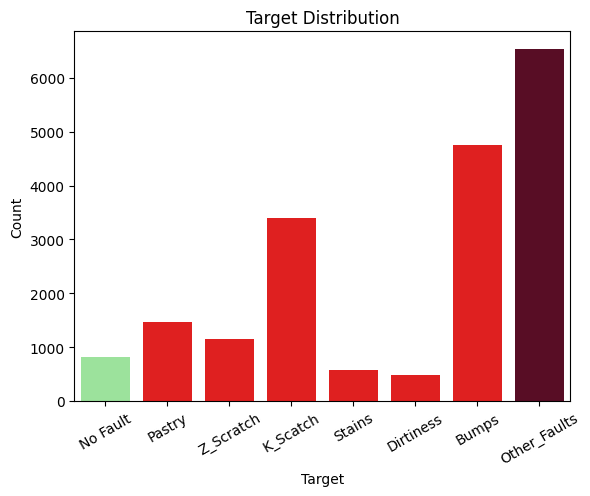

In [ ]:
y_labels = ['No Fault', 'Pastry', 'Z_Scratch', 'K_Scatch', 'Stains', 'Dirtiness', 'Bumps', 'Other_Faults']

colours = ['lightgreen', 'red', 'red', 'red', 'red', 'red', 'red', 'xkcd:maroon',]
sns.countplot(x='Target', data=clean_df, palette=colours)
plt.title('Target Distribution')
plt.xlabel('Target')
plt.ylabel('Count')
plt.xticks(np.arange(8), y_labels, rotation=30)
plt.show()

<ipython-input-4-7915b5e8f505>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x='Models', y='Scores', data=roc_auc_dict, palette=colours)


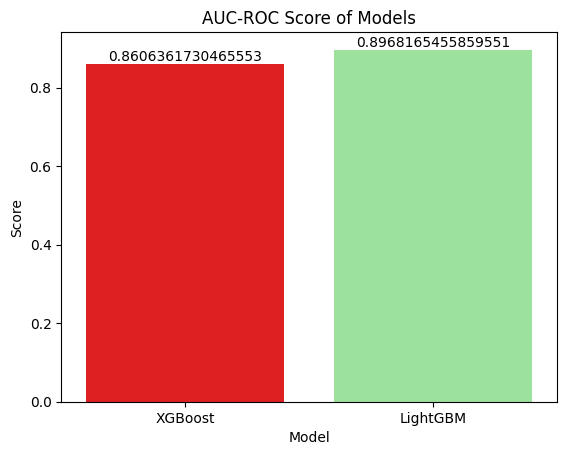

In [ ]:
roc_auc_dict = {'Models': ['XGBoost', 'LightGBM'],
                'Scores': [0.8606361730465553, 0.8968165455859551]}

colours = ['red', 'lightgreen']
ax = sns.barplot(x='Models', y='Scores', data=roc_auc_dict, palette=colours)
for p in ax.patches:
    ax.annotate(f'{p.get_height()}',
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='bottom')
plt.title('AUC-ROC Score of Models')
plt.xlabel('Model')
plt.ylabel('Score')
plt.show()